In [1]:
%load_ext dotenv
%dotenv

import tqdm
import flax
from flax import linen as nn
import jax
from typing import Dict, Callable, Sequence, Any, Union
from dataclasses import field
import jax.numpy as jnp
import tensorflow_datasets as tfds
import tensorflow as tf

import matplotlib.pyplot as plt
import einops
import clu
from clu import parameter_overview, metrics
from flax.training import train_state  # Useful dataclass to keep train state
import optax
from flax import struct                # Flax dataclasses
import time
import os
from datetime import datetime
import orbax
from flax.training import orbax_utils
import numpy as np
from einops import rearrange
import math
import functools

2024-07-04 11:57:49.814265: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


# Initialization

In [2]:
# Some Optimizations
import ctypes

_libcudart = ctypes.CDLL("libcudart.so")
# Set device limit on the current device
# cudaLimitMaxL2FetchGranularity = 0x05
pValue = ctypes.cast((ctypes.c_int * 1)(), ctypes.POINTER(ctypes.c_int))
_libcudart.cudaDeviceSetLimit(ctypes.c_int(0x05), ctypes.c_int(128))
_libcudart.cudaDeviceGetLimit(pValue, ctypes.c_int(0x05))
assert pValue.contents.value == 128
tf.compat.v1.ConfigProto.force_gpu_compatible = True

gpus = tf.config.list_physical_devices("GPU")
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.list_logical_devices("GPU")
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

1 Physical GPUs, 1 Logical GPUs


I0000 00:00:1720074471.413012   87814 cuda_executor.cc:1020] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1720074471.616472   87814 cuda_executor.cc:1020] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1720074471.616639   87814 cuda_executor.cc:1020] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1720074471.617832   87814 cuda_executor.cc:1020] successful NUMA node read from SysFS ha

In [3]:
normalizeImage = lambda x: jax.nn.standardize(x, mean=[127.5], std=[127.5])
denormalizeImage = lambda x: (x + 1.0) * 127.5


def plotImages(imgs, fig_size=(8, 8), dpi=100):
    fig = plt.figure(figsize=fig_size, dpi=dpi)
    imglen = imgs.shape[0]
    for i in range(imglen):
        plt.subplot(fig_size[0], fig_size[1], i + 1)
        plt.imshow(tf.cast(denormalizeImage(imgs[i, :, :, :]), tf.uint8))
        plt.axis("off")
    plt.show()

class RandomClass():
    def __init__(self, rng: jax.random.PRNGKey):
        self.rng = rng

    def get_random_key(self):
        self.rng, subkey = jax.random.split(self.rng)
        return subkey
    
    def get_sigmas(self, steps):
        return jnp.tan(self.theta_min + steps * (self.theta_max - self.theta_min)) / self.kappa

    def reset_random_key(self):
        self.rng = jax.random.PRNGKey(42)

class MarkovState(struct.PyTreeNode):
    pass

class RandomMarkovState(MarkovState):
    rng: jax.random.PRNGKey

    def get_random_key(self):
        rng, subkey = jax.random.split(self.rng)
        return RandomMarkovState(rng), subkey

# Data Pipeline

In [4]:
def get_dataset(data_name="celeb_a", batch_size=64, image_scale=256):
    def augmenter(image_scale=256, method="area"):
        @tf.function()
        def augment(sample):
            image = (
                tf.cast(sample["image"], tf.float32) - 127.5
            ) / 127.5
            image = tf.image.resize(
                image, [image_scale, image_scale], method=method, antialias=True
            )
            image = tf.image.random_flip_left_right(image)
            image = tf.image.random_contrast(image, 0.999, 1.05)
            image = tf.image.random_brightness(image, 0.2)

            image = tf.clip_by_value(image, -1.0, 1.0)
            return image
        return augment

    # Load CelebA Dataset
    data: tf.data.Dataset = tfds.load(data_name, split="all", shuffle_files=True)
    final_data = (
        data
        .cache()  # Cache after augmenting to avoid recomputation
        # .prefetch(tf.data.experimental.AUTOTUNE)
        # .batch(128, num_parallel_calls=tf.data.AUTOTUNE)
        .map(
            augmenter(image_scale, method="area"),
            num_parallel_calls=tf.data.AUTOTUNE,
        )
        .repeat()  # Repeats the dataset indefinitely
        # .unbatch()
        .shuffle(4096)  # Ensure this is adequate for your dataset size
        .batch(batch_size, drop_remainder=True)
        .prefetch(tf.data.experimental.AUTOTUNE)
    ).as_numpy_iterator()
    return final_data, len(data)


# Noise Samplers

In [ ]:
from jax.numpy import ndarray
from flaxdiff.schedulers import CosineNoiseSchedule, NoiseScheduler, GeneralizedNoiseScheduler, KarrasVENoiseScheduler, EDMNoiseScheduler
from flaxdiff.predictors import VPredictionTransform, EpsilonPredictionTransform, DiffusionPredictionTransform, DirectPredictionTransform, KarraasPredictionTransform

In [10]:
data, _ = get_dataset("oxford_flowers102", batch_size=64, image_scale=64)
images = next(iter(data))

In [ ]:
schedule = KarrasVENoiseScheduler(1000)
ts, rand = schedule.generate_timesteps(100, RandomMarkovState(jax.random.PRNGKey(42)))
print(ts)
sigmas = schedule.get_sigmas(ts)
# # print(sigmas)
plt.scatter(ts, sigmas)
plt.show()
noise = jax.random.normal(jax.random.PRNGKey(4), (1, 64, 64, 3))
# data = jax.random.normal(jax.random.PRNGKey(5), (1, 64, 64, 3))
data = images[0]
ts = 999
sigma = schedule.get_sigmas(ts)
signal_rate, noise_rate = schedule.get_rates(ts)
predictor = KarraasPredictionTransform(1)
x_t, c_in, target = predictor.forward_diffusion(data, noise, ts, schedule)
print(f"x_t at t = {ts}, sigma = {sigma} ==>")
plt.hist(x_t.flatten(), bins=100)
plt.show()
print(jnp.mean(x_t), jnp.std(x_t))
print("c_in", c_in)
model_in = c_in * x_t
print("model_in ==>")
plt.hist(model_in.flatten(), bins=100)
plt.show()

pred = data
print("pred ==>")
plt.hist(pred.flatten(), bins=100)
plt.show()
model_out = predictor.pred_transform(x_t, pred, (signal_rate, noise_rate))
model_pred_x0, model_pred_eps = predictor.backward_diffusion(x_t, model_out, (signal_rate, noise_rate))
print("model_out ==>")
plt.hist(model_out.flatten(), bins=100)
plt.show()
print("model_pred_x0 ==>")
plt.hist(model_pred_x0.flatten(), bins=100)
plt.show()
print("data ==>")
plt.hist(data.flatten(), bins=100)
plt.show()
print("model_pred_noise ==>")
plt.hist(model_pred_eps.flatten(), bins=100)
plt.show()
print("noise ==>")
plt.hist(noise.flatten(), bins=100)
plt.show()
# loss = (model_out - data) ** 2
# plt.hist(loss.flatten(), bins=100)
# plt.show()

## Testing Schedulers

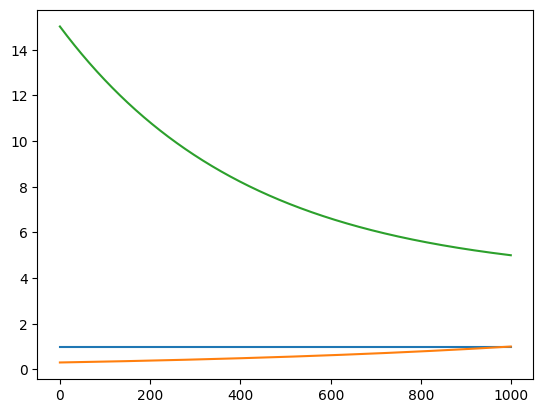

[[[[1.4142135]]]]
at t=0 (Array([[[[1]]]], dtype=int32, weak_type=True), Array([[[[0.3011942]]]], dtype=float32, weak_type=True)) at t=1 (Array([[[[1]]]], dtype=int32, weak_type=True), Array([[[[1.]]]], dtype=float32, weak_type=True))


In [163]:
# schedule = SimpleNoiseScheduler(1000)
# # schedule = CosineNoiseSchedule(1000)
# plt.plot([schedule.get_rates(i, shape=()) for i in jnp.linspace(0, 1000, 1000)])
# plt.plot([schedule.get_weights(i) for i in jnp.linspace(0, 1000, 1000)])
# plt.show()
schedule = EDMNoiseScheduler(1, sigma_max=80, rho=20)
plt.plot([schedule.get_rates(i, shape=()) for i in jnp.linspace(0, 1, 1000)])
# plt.plot([schedule.get_weights(i, shape=()) for i in jnp.linspace(0, 1, 1000)])
plt.show()
print(schedule.get_max_variance())
get_variance = lambda rates: rates[0] ** 2 + rates[1] ** 2
# plt.plot([get_variance(schedule.get_rates(i, shape=())) for i in jnp.linspace(0, 1000, 1000)])
print("at t=0", schedule.get_rates(0), "at t=1", schedule.get_rates(1))


In [ ]:

schedule = KarrasVENoiseScheduler(1, sigma_max=80, rho=20)
plt.plot([schedule.get_rates(i, shape=()) for i in jnp.linspace(0, 1, 1000)])
plt.show()

steps, _ = schedule.generate_timesteps(1000, RandomMarkovState(jax.random.PRNGKey(42)))
alpha, sigmas = schedule.get_rates(steps)
plt.hist(sigmas.flatten(), bins=100)
plt.show()
plt.hist(steps.flatten(), bins=100)
plt.show()
# weights = schedule.get_weights(steps)
weights = (sigmas ** 2 + 0.5 ** 2) / (sigmas * 0.5) ** 2
plt.scatter(steps, sigmas)
# plt.scatter(sigmas, weights)
plt.show()
_, nin = schedule.transform_inputs(jax.random.normal(jax.random.PRNGKey(42), (1, 64, 64, 3)), steps)
plt.hist(nin.flatten(), bins=100)
plt.scatter(steps, nin.flatten())
print(weights.max())

In [265]:
class TimeEmbedding(nn.Module):
    features:int
    max_positions:int=10000

    def setup(self):
        # self.embeddings = nn.Embed(
        #     num_embeddings=max_timesteps, features=out_features
        # )
        half_dim = self.features // 2
        # emb = jnp.log(self.max_positions) / (half_dim - 1)
        # emb = jnp.exp(-emb * jnp.arange(half_dim, dtype=jnp.float32))
        emb = jnp.arange(half_dim, dtype=jnp.float32) / (half_dim - 1)
        emb = (1 / self.max_positions) ** emb
        self.embeddings = emb

    def __call__(self, x):
        x = jax.lax.convert_element_type(x, jnp.float32)
        emb = x[:, None] * self.embeddings[None, :]
        emb = jnp.concatenate([jnp.sin(emb), jnp.cos(emb)], axis=-1)
        return emb
    
class FourierEmbedding(nn.Module):
    features:int
    scale:int = 16

    def setup(self):
        self.freqs = jax.random.normal(jax.random.PRNGKey(42), (self.features // 2, ), dtype=jnp.float32) * self.scale

    def __call__(self, x):
        x = jax.lax.convert_element_type(x, jnp.float32)
        emb = x[:, None] * (2 * jnp.pi * self.freqs)[None, :]
        emb = jnp.concatenate([jnp.sin(emb), jnp.cos(emb)], axis=-1)
        return emb

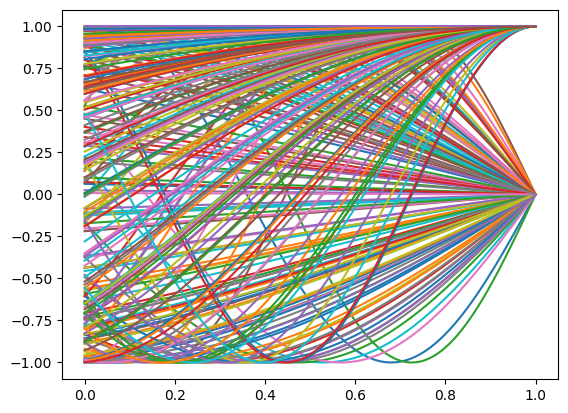

In [281]:
schedule = EDMNoiseScheduler(1, sigma_max=80, rho=7)
steps = jnp.linspace(0, 16, 1000)
sigmas = schedule.get_sigmas(steps)
# plt.plot(steps, sigmas)
_, nin = schedule.transform_inputs(jax.random.normal(jax.random.PRNGKey(42), (1, 64, 64, 3)), steps)
# plt.plot(steps, nin)
temb = FourierEmbedding(features=256, scale=1)
param = temb.init(jax.random.PRNGKey(42), nin)
emb = temb.apply(param, nin)
plt.plot(steps, emb)
plt.show()

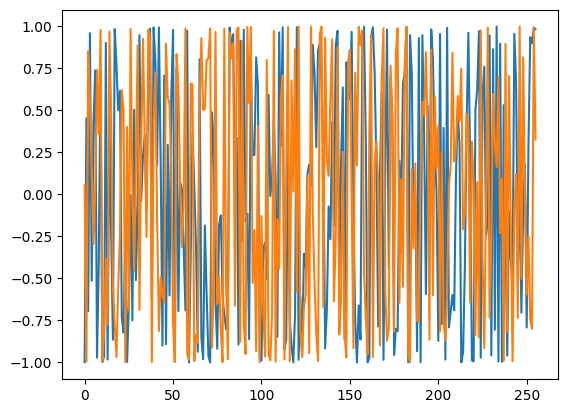

In [273]:
plt.plot(emb[100])
plt.plot(emb[200])

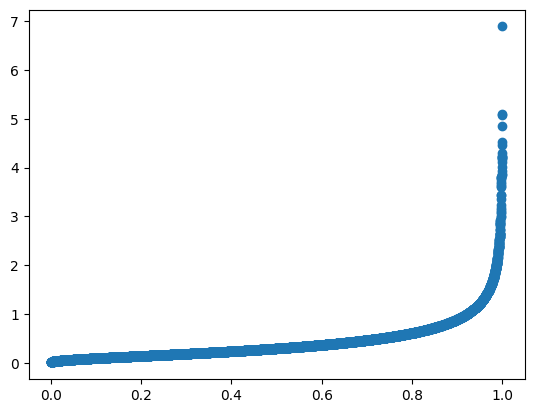

In [132]:
steps, _ = schedule.generate_timesteps(10000, RandomMarkovState(jax.random.PRNGKey(42)))
sigmas = schedule.get_sigmas(steps)
plt.scatter(steps, sigmas)

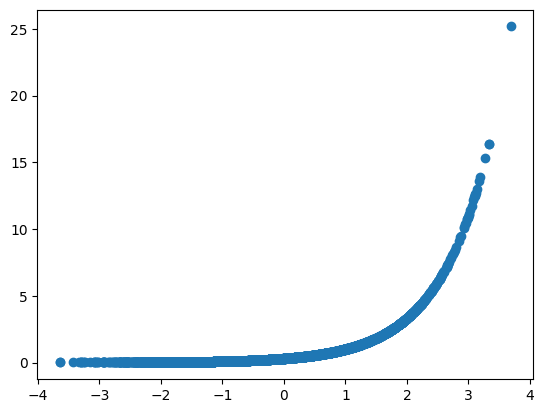

In [86]:
steps, _ = schedule.generate_timesteps(10000, RandomMarkovState(jax.random.PRNGKey(42)))
sigmas = schedule.get_sigmas(steps)
plt.scatter(steps, sigmas)

# Data Diffusion Testing

In [ ]:
# Visualize adding some noise to some sample images and then removing it
state = RandomMarkovState(jax.random.PRNGKey(4))
# data, _ = get_dataset("oxford_flowers102", batch_size=64, image_scale=64)
images = next(iter(data))
plotImages(images)
noise_level = 0.5# * jnp.ones((images.shape[0], ), dtype=jnp.int32)
noise_level_max = 1
schedule = KarrasVENoiseScheduler(noise_level_max, rho=40, sigma_max=100)
state, rng = state.get_random_key()
signal_rate, noise_rate = schedule.get_rates(noise_level)
print("Rates", signal_rate, noise_rate)
noise = jax.random.normal(rng, shape=images.shape, dtype=jnp.float64)
# noisy_images = images * signal_rate + noise * noise_rate
noisy_images = schedule.add_noise(images, noise, noise_level)
plotImages(noisy_images)
plotImages(noise)
reconstructed_images = schedule.remove_all_noise(noisy_images, noise, noise_level)
plotImages(reconstructed_images)


# Modeling

## Metrics

## Callbacks

## Model Generator

In [282]:
from flaxdiff.models.simple_unet import l2norm, ConvLayer, TimeEmbedding, TimeProjection, Upsample, Downsample, AttentionBlock, ResidualBlock, kernel_init, PixelShuffle
from flaxdiff.models.attention import EfficientAttention, jax_memory_efficient_attention

class EfficientAttention(nn.Module):
    """
    Simple implementation of memory efficient attention.
    """
    query_dim: int
    heads: int = 4
    dim_head: int = 64
    dtype: Any = jnp.float32

    def setup(self):
        inner_dim = self.dim_head * self.heads
        # Weights were exported with old names {to_q, to_k, to_v, to_out}
        self.query = nn.DenseGeneral(inner_dim, use_bias=False, dtype=self.dtype, name="to_q")
        self.key = nn.DenseGeneral(inner_dim, use_bias=False, dtype=self.dtype, name="to_k")
        self.value = nn.DenseGeneral(inner_dim, use_bias=False, dtype=self.dtype, name="to_v")

        self.proj_attn = nn.DenseGeneral(self.query_dim, use_bias=False, dtype=self.dtype, name="to_out_0")

    @nn.compact
    def __call__(self, x, context=None):
        # x has shape [B, H * W, C]
        context = x if context is None else context
        query = self.query(x)
        key = self.key(context)
        value = self.value(context)
        
        flatten_latent_dim = query.shape[-3]
        if flatten_latent_dim % 64 == 0:
            query_chunk_size = int(flatten_latent_dim / 64)
        elif flatten_latent_dim % 16 == 0:
            query_chunk_size = int(flatten_latent_dim / 16)
        elif flatten_latent_dim % 4 == 0:
            query_chunk_size = int(flatten_latent_dim / 4)
        else:
            query_chunk_size = int(flatten_latent_dim)

        hidden_states = jax_memory_efficient_attention(
            query, key, value, query_chunk_size=query_chunk_size, key_chunk_size=4096 * 4
        )

        proj = self.proj_attn(hidden_states)
        return proj

class NormalAttention(nn.Module):
    """
    Simple implementation of the normal attention.
    """
    query_dim: int
    heads: int = 4
    dim_head: int = 64
    dtype: Any = jnp.float32
    precision: Any = jax.lax.Precision.HIGHEST
    use_bias: bool = True
    kernel_init: Callable = lambda : kernel_init(1.0)

    def setup(self):
        inner_dim = self.dim_head * self.heads
        dense = functools.partial(
            nn.DenseGeneral,
            features=[self.heads, self.dim_head], 
            axis=-1, 
            precision=self.precision, 
            use_bias=self.use_bias, 
            kernel_init=self.kernel_init(), 
            dtype=self.dtype
        )
        self.query = dense(name="to_q")
        self.key = dense(name="to_k")
        self.value = dense(name="to_v")

        self.proj_attn = nn.DenseGeneral(
            self.query_dim, 
            axis=(-2, -1), 
            precision=self.precision, 
            use_bias=self.use_bias, 
            dtype=self.dtype, 
            name="to_out_0",
            kernel_init=self.kernel_init()
        )

    @nn.compact
    def __call__(self, x, context=None):
        # x has shape [B, H, W, C]
        context = x if context is None else context
        query = self.query(x)
        key = self.key(context)
        value = self.value(context)

        hidden_states = nn.dot_product_attention(
            query, key, value, dtype=self.dtype, broadcast_dropout=False, dropout_rng=None, precision=self.precision
        )
        proj = self.proj_attn(hidden_states)
        return proj


class AttentionBlock(nn.Module):
    heads: int = 4
    dim_head: int = 32
    use_linear_attention: bool = True
    dtype: Any = jnp.float32
    precision: Any = jax.lax.Precision.HIGH
    use_projection: bool = False

    @nn.compact
    def __call__(self, x):
        inner_dim = self.heads * self.dim_head
        B, H, W, C = x.shape
        normed_x = nn.RMSNorm(epsilon=1e-5, dtype=self.dtype)(x)
        if self.use_projection:
            if self.use_linear_attention:
                projected_x = nn.Dense(features=inner_dim, use_bias=False, precision=self.precision, dtype=self.dtype, name=f'project_in')(normed_x)
            else:
                projected_x = nn.Conv(
                    features=inner_dim, kernel_size=(1, 1),
                    strides=(1, 1), padding='VALID', use_bias=False, dtype=self.dtype,
                    precision=self.precision, name=f'project_in_conv',
                )(normed_x)
        else:
            projected_x = normed_x
            inner_dim = C

        projected_x = NormalAttention(
            query_dim=inner_dim,
            heads=self.heads,
            dim_head=self.dim_head,
            name=f'Attention',
            precision=self.precision,
            use_bias=False,
        )(projected_x)

        # projected_x = nn.MultiHeadAttention(num_heads=self.heads, use_bias=False, precision='high', decode=False)(projected_x)

        # projected_x = BasicTransformerBlock(
        #     query_dim=inner_dim,
        #     heads=self.heads,
        #     dim_head=self.dim_head,
        #     name=f'Attention',
        #     precision=self.precision,
        # )(projected_x, projected_x)

        if self.use_projection:
            if self.use_linear_attention:
                projected_x = nn.Dense(features=C, precision=self.precision, dtype=self.dtype, use_bias=False, name=f'project_out')(projected_x)
            else:
                projected_x = nn.Conv(
                    features=C, kernel_size=(1, 1),
                    strides=(1, 1), padding='VALID', use_bias=False, dtype=self.dtype,
                    precision=self.precision, name=f'project_out_conv',
                )(projected_x)

        out = x + projected_x
        return out


## Attention and other prototyping

In [54]:
x = jnp.ones((8, 16, 16, 64))
# context = jnp.ones((8, 16, 16, 64))
attention_block = AttentionBlock(heads=4, dim_head=64//4)
params = attention_block.init(jax.random.PRNGKey(0), x)
out = attention_block.apply(params, x)
print("Output :", out.shape)
print(attention_block.tabulate(jax.random.key(0), x, console_kwargs={"width": 200, "force_jupyter":True, }))
print(jnp.mean(out), jnp.std(out))
# plt.hist(out.flatten(), bins=100)
# %timeit attention_block.apply(params, x)

Output : (8, 16, 16, 64)


                                              AttentionBlock Summary                                               
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ path               ┃ module          ┃ inputs                ┃ outputs               ┃ params                   ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│                    │ AttentionBlock  │ float32[8,16,16,64]   │ float32[8,16,16,64]   │                          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ RMSNorm_0          │ RMSNorm         │ float32[8,16,16,64]   │ float32[8,16,16,64]   │ scale: float32[64]       │
│                    │                 │                       │                       │                          │
│                    │                 │                       │                       │ 64 (256 B)               │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ Attention          │ NormalAttention │ float32[8,16,16,64]   │ float32[8,16,16,64]   │                          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ Attention/to_q     │ DenseGeneral    │ float32[8,16,16,64]   │ float32[8,16,16,4,16] │ kernel: float32[64,4,16] │
│                    │                 │                       │                       │                          │
│                    │                 │                       │                       │ 4,096 (16.4 KB)          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ Attention/to_k     │ DenseGeneral    │ float32[8,16,16,64]   │ float32[8,16,16,4,16] │ kernel: float32[64,4,16] │
│                    │                 │                       │                       │                          │
│                    │                 │                       │                       │ 4,096 (16.4 KB)          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ Attention/to_v     │ DenseGeneral    │ float32[8,16,16,64]   │ float32[8,16,16,4,16] │ kernel: float32[64,4,16] │
│                    │                 │                       │                       │                          │
│                    │                 │                       │                       │ 4,096 (16.4 KB)          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│ Attention/to_out_0 │ DenseGeneral    │ float32[8,16,16,4,16] │ float32[8,16,16,64]   │ kernel: float32[4,16,64] │
│                    │                 │                       │                       │                          │
│                    │                 │                       │                       │ 4,096 (16.4 KB)          │
├────────────────────┼─────────────────┼───────────────────────┼───────────────────────┼──────────────────────────┤
│                    │                 │                       │                 Total │ 16,448 (65.8 KB)         │
└────────────────────┴─────────────────┴───────────────────────┴───────────────────────┴──────────────────────────┘
                                                                                                                   
                                        Total Parameters: 16,448 (65.8 KB)                                         




0.79696566 1.2281164


In [283]:

class Unet(nn.Module):
    emb_features:int=64*4,
    feature_depths:list=[64, 128, 256, 512],
    attention_configs:list=[{"heads":8}, {"heads":8}, {"heads":8}, {"heads":8}],
    num_res_blocks:int=2,
    num_middle_res_blocks:int=1,
    activation:Callable = jax.nn.swish
    norm_groups:int=8

    @nn.compact
    def __call__(self, x, temb):
        # print("embedding features", self.emb_features)
        temb = FourierEmbedding(features=self.emb_features)(temb)
        temb = TimeProjection(features=self.emb_features)(temb)
        # print("time embedding", temb.shape)
        feature_depths = self.feature_depths
        attention_configs = self.attention_configs

        conv_type = "conv"

        x = ConvLayer(
            "conv",
            features=self.feature_depths[0],
            kernel_size=(3, 3),
            strides=(1, 1),
            kernel_init=kernel_init(1.0)
        )(x)
        downs = [x]

        # Downscaling blocks
        for i, (dim_out, attention_config) in enumerate(zip(feature_depths, attention_configs)):
            dim_in = x.shape[-1]
            # dim_in = dim_out
            for j in range(self.num_res_blocks):
                x = ResidualBlock(
                    conv_type,
                    name=f"down_{i}_residual_{j}",
                    features=dim_in,
                    kernel_init=kernel_init(1.0),
                    kernel_size=(3, 3),
                    strides=(1, 1),
                    activation=self.activation,
                    norm_groups=self.norm_groups
                )(x, temb)
                if attention_config is not None and j == self.num_res_blocks - 1:   # Apply attention only on the last block
                    x = AttentionBlock(heads=attention_config['heads'], 
                                       dim_head=dim_out // attention_config['heads'],
                                       name=f"down_{i}_attention_{j}")(x)
                # print("down residual for feature level", i, "is of shape", x.shape, "features", dim_in)
                downs.append(x)
            if i != len(feature_depths) - 1:
                # print("Downsample", i, x.shape)
                x = Downsample(
                    features=dim_out,
                    scale=2,
                    activation=self.activation,
                    name=f"down_{i}_downsample"
                )(x)

        # Middle Blocks
        middle_dim_out = self.feature_depths[-1]
        middle_attention = self.attention_configs[-1]
        # x = nn.GroupNorm(8)(x)
        # x = ConvLayer(
        #     "conv",
        #     features=middle_dim_out,
        #     kernel_size=(3, 3),
        #     strides=(1, 1),
        #     kernel_init=kernel_init(1.0),
        #     name="middle_conv"
        # )(x)
        for j in range(self.num_middle_res_blocks):
            x = ResidualBlock(
                conv_type,
                name=f"middle_res1_{j}",
                features=middle_dim_out,
                kernel_init=kernel_init(1.0),
                kernel_size=(3, 3),
                strides=(1, 1),
                activation=self.activation,
                norm_groups=self.norm_groups
            )(x, temb)
            if middle_attention is not None and j == self.num_middle_res_blocks - 1:   # Apply attention only on the last block
                x = AttentionBlock(heads=attention_config['heads'], 
                                   dim_head=dim_out // attention_config['heads'],
                                   use_linear_attention=False, name=f"middle_attention_{j}")(x)
            x = ResidualBlock(
                conv_type,
                name=f"middle_res2_{j}",
                features=middle_dim_out,
                kernel_init=kernel_init(1.0),
                kernel_size=(3, 3),
                strides=(1, 1),
                activation=self.activation,
                norm_groups=self.norm_groups
            )(x, temb)

        # Upscaling Blocks
        for i, (dim_out, attention_config) in enumerate(zip(reversed(feature_depths), reversed(attention_configs))):
            # print("Upscaling", i, "features", dim_out)
            for j in range(self.num_res_blocks):
                x = jnp.concatenate([x, downs.pop()], axis=-1)
                # print("concat==> ", i, "concat", x.shape)
                # kernel_size = (1 + 2 * (j + 1), 1 + 2 * (j + 1))
                kernel_size = (3, 3)
                x = ResidualBlock(
                    conv_type,# if j == 0 else "separable",
                    name=f"up_{i}_residual_{j}",
                    features=dim_out,
                    kernel_init=kernel_init(1.0),
                    kernel_size=kernel_size,
                    strides=(1, 1),
                    activation=self.activation,
                    norm_groups=self.norm_groups
                )(x, temb)
                if attention_config is not None and j == self.num_res_blocks - 1:   # Apply attention only on the last block
                    x = AttentionBlock(heads=attention_config['heads'], 
                                       dim_head=dim_out // attention_config['heads'],
                                       name=f"up_{i}_attention_{j}")(x)
            # print("Upscaling ", i, x.shape)
            if i != len(feature_depths) - 1:
                x = Upsample(
                    features=feature_depths[-i],
                    scale=2,
                    activation=self.activation,
                    name=f"up_{i}_upsample"
                )(x)

        # x = nn.GroupNorm(8)(x)
        # x = ConvLayer(
        #     "conv",
        #     features=self.feature_depths[0],
        #     kernel_size=(3, 3),
        #     strides=(1, 1),
        #     kernel_init=kernel_init(0.0)
        # )(x)
    
        x = jnp.concatenate([x, downs.pop()], axis=-1)

        x = ResidualBlock(
            conv_type,
            name="final_residual",
            features=self.feature_depths[0],
            kernel_init=kernel_init(1.0),
            kernel_size=(3,3),
            strides=(1, 1),
            activation=self.activation,
            norm_groups=self.norm_groups
        )(x, temb)

        x = nn.GroupNorm(self.norm_groups)(x)
        x = self.activation(x)

        output = ConvLayer(
            "conv",
            features=3,
            kernel_size=(3,3),
            strides=(1, 1),
            # activation=jax.nn.mish
            kernel_init=kernel_init(0.0)
        )(x)
        return output#, attentions

# Training

In [284]:
BATCH_SIZE = 16
IMAGE_SIZE = 64

cosine_schedule = CosineNoiseSchedule(1000, beta_end=1)
# linear_schedule = LinearNoiseSchedule(1000)
# cosine_general_schedule = CosineGeneralNoiseScheduler(1)
karas_ve_schedule = KarrasVENoiseScheduler(1, sigma_max=80, rho=7, sigma_data=0.5)
edm_schedule = EDMNoiseScheduler(1, sigma_max=80, rho=7, sigma_data=0.5)

In [285]:
import orbax.checkpoint


@struct.dataclass
class Metrics(metrics.Collection):
  loss: metrics.Average.from_output('loss') # type: ignore

class ModelState():
    model: nn.Module
    params: dict
    noise_schedule: NoiseScheduler
    model_output_transform: DiffusionPredictionTransform

# Define the TrainState with EMA parameters
class TrainState(train_state.TrainState):
    rngs: jax.random.PRNGKey
    ema_params: dict

    def get_random_key(self):
        rngs, subkey = jax.random.split(self.rngs)
        return self.replace(rngs=rngs), subkey

    def apply_ema(self, decay: float=0.999):
        new_ema_params = jax.tree_util.tree_map(
            lambda ema, param: decay * ema + (1 - decay) * param,
            self.ema_params,
            self.params,
        )
        return self.replace(ema_params=new_ema_params)

class DiffusionTrainer:
    state : TrainState
    best_state : TrainState
    best_loss : float
    model : nn.Module
    noise_schedule : NoiseScheduler
    model_output_transform:DiffusionPredictionTransform
    ema_decay:float = 0.999
    
    def __init__(self, 
                 model:nn.Module, 
                 optimizer: optax.GradientTransformation,
                 noise_schedule:NoiseScheduler,
                 rngs:jax.random.PRNGKey,
                 train_state:TrainState=None,
                 name:str="Diffusion",
                 load_from_checkpoint:bool=False,
                 param_transforms:Callable=None,
                 model_output_transform:DiffusionPredictionTransform=EpsilonPredictionTransform(),
                 loss_fn=optax.l2_loss
                 ):
        self.model = model
        self.noise_schedule = noise_schedule
        self.name = name
        self.model_output_transform = model_output_transform
        self.loss_fn = loss_fn

        checkpointer = orbax.checkpoint.PyTreeCheckpointer()
        options = orbax.checkpoint.CheckpointManagerOptions(max_to_keep=4, create=True)
        self.checkpointer = orbax.checkpoint.CheckpointManager(self.checkpoint_path(), checkpointer, options)

        if load_from_checkpoint:
            params = self.load()
        else:
            params = None

        if train_state == None:
            self.init_state(optimizer, rngs, params=params, model=model, param_transforms=param_transforms)
        else:
            self.state = train_state
            self.best_state = train_state
            self.best_loss = 1e9

    def init_state(self, 
                   optimizer: optax.GradientTransformation, 
                   rngs:jax.random.PRNGKey,
                   params:dict=None,
                   model:nn.Module=None,
                     param_transforms:Callable=None,
                   ):
        inp = jnp.ones((BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        temb = jnp.ones((BATCH_SIZE,))
        rngs, subkey = jax.random.split(rngs)
        if params == None:
            params = model.init(subkey, inp, temb)
        if param_transforms is not None:
            params = param_transforms(params)
        self.best_loss = 1e9
        self.state = TrainState.create(
            apply_fn=model.apply,
            params=params,
            ema_params=params,
            tx=optimizer,
            rngs=rngs,
        )
        self.best_state = self.state

    def checkpoint_path(self):
        experiment_name = self.name
        path = os.path.join(os.path.abspath('./models'), experiment_name)
        if not os.path.exists(path):
            os.makedirs(path)
        return path

    def load(self):
        step = self.checkpointer.latest_step()
        print("Loading model from checkpoint", step)
        ckpt = self.checkpointer.restore(step)
        state = ckpt['state']
        # Convert the state to a TrainState
        self.best_loss = ckpt['best_loss']
        print(f"Loaded model from checkpoint at step {step}", ckpt['best_loss'])
        return state.get('params', None)#, ckpt.get('model', None)

    def save(self, epoch=0, best=False):
        print(f"Saving model at epoch {epoch}")
        state = self.best_state if best else self.state
        # filename = os.path.join(self.checkpoint_path(), f'model_{epoch}' if not best else 'best_model')
        ckpt = {
            'model': self.model,
            'state': state,
            'best_loss': self.best_loss
        }
        save_args = orbax_utils.save_args_from_target(ckpt)
        self.checkpointer.save(epoch, ckpt, save_kwargs={'save_args': save_args})

    def summary(self):
        inp = jnp.ones((1, IMAGE_SIZE, IMAGE_SIZE, 3))
        temb = jnp.ones((1,))
        print(self.model.tabulate(jax.random.key(0), inp, temb, console_kwargs={"width": 200, "force_jupyter":True, }))

    def _define_train_step(self):
        noise_schedule = self.noise_schedule
        model = self.model
        model_output_transform = self.model_output_transform
        loss_fn = self.loss_fn
        @jax.jit
        def train_step(state:TrainState, batch):
            """Train for a single step."""
            images = batch
            noise_level, state = noise_schedule.generate_timesteps(images.shape[0], state)
            state, rngs = state.get_random_key()
            noise:jax.Array = jax.random.normal(rngs, shape=images.shape)
            rates = noise_schedule.get_rates(noise_level)
            noisy_images, c_in, expected_output = model_output_transform.forward_diffusion(images, noise, rates)
            def model_loss(params):
                preds = model.apply(params, *noise_schedule.transform_inputs(noisy_images*c_in, noise_level))
                preds = model_output_transform.pred_transform(noisy_images, preds, rates)
                nloss = loss_fn(preds, expected_output)
                # nloss = jnp.mean(nloss, axis=1)
                nloss *= noise_schedule.get_weights(noise_level)
                nloss = jnp.mean(nloss)
                loss = nloss
                return loss
            loss, grads = jax.value_and_grad(model_loss)(state.params)
            state = state.apply_gradients(grads=grads) 
            state = state.apply_ema(self.ema_decay)
            return state, loss
        return train_step
    
    def _define_compute_metrics(self):
        @jax.jit
        def compute_metrics(state:TrainState, expected, pred):
            loss = jnp.mean(jnp.square(pred - expected))
            metric_updates = state.metrics.single_from_model_output(loss=loss)
            metrics = state.metrics.merge(metric_updates)
            state = state.replace(metrics=metrics)
            return state
        return compute_metrics

    def fit(self, data, steps_per_epoch, epochs):
        data = iter(data)
        train_step = self._define_train_step()
        compute_metrics = self._define_compute_metrics()
        state = self.state
        for epoch in range(epochs):
            print(f"\nEpoch {epoch+1}/{epochs}")
            start_time = time.time()
            epoch_loss = 0
            with tqdm.tqdm(total=steps_per_epoch, desc=f'\t\tEpoch {epoch+1}', ncols=100, unit='step') as pbar:
                for i in range(steps_per_epoch):
                    batch = next(data)
                    state, loss = train_step(state, batch)
                    epoch_loss += loss
                    if i % 100 == 0:
                        pbar.set_postfix(loss=f'{loss:.4f}')
                        pbar.update(100)
            end_time = time.time()
            self.state = state
            total_time = end_time - start_time
            avg_time_per_step = total_time / steps_per_epoch
            avg_loss = epoch_loss / steps_per_epoch
            if avg_loss < self.best_loss:
                self.best_loss = avg_loss
                self.best_state = state
                self.save(epoch, best=True)
            print(f"\n\tEpoch {epoch+1} completed. Avg Loss: {avg_loss}, Time: {total_time:.2f}s, Best Loss: {self.best_loss}")
        return self.state


In [48]:
experiment_name = '../good models/Diffusion_2024-06-23_16:22:53'
print("Experiment_Name:", experiment_name)
unet = Unet(emb_features=256, 
            feature_depths=[64, 128, 256, 512],
            attention_configs=[{"heads":4}, {"heads":4}, {"heads":4}, {"heads":4}, {"heads":4}],
            num_res_blocks=2,
            num_middle_res_blocks=1
)
# solver = optax.lookahead(optax.adam(2e-4), sync_period=6, slow_step_size=0.5)
# params_transform = lambda x: optax.LookaheadParams.init_synced(x)
solver = optax.adamw(2e-4)
trainer = DiffusionTrainer(unet, optimizer=solver, 
                           noise_schedule=cosine_schedule,
                           rngs=jax.random.PRNGKey(4), 
                           name=experiment_name,
                           model_output_transform=VPredictionTransform(),
                        #    loss_fn=lambda x, y: jnp.abs(x - y),
                            # param_transforms=params_transform,
                           load_from_checkpoint=True,
                           )
# #trainer.summary()
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)

Experiment_Name: ../good models/Diffusion_2024-06-23_16:22:53
Loading model from checkpoint 753
Loaded model from checkpoint at step 753 0.026293172


In [286]:
experiment_name = "{name}_{date}".format(
    name="Diffusion_SDE_VE", date=datetime.now().strftime("%Y-%m-%d_%H:%M:%S")
)
# experiment_name = 'Diffusion_SDE_VE_2024-07-02_03:49:22'
# experiment_name = 'Diffusion_SDE_VE_2024-06-30_15:34:06'
# experiment_name = 'Diffusion_SDE_VE_2024-07-01_00:36:44'
print("Experiment_Name:", experiment_name)
unet = Unet(emb_features=256, 
            feature_depths=[64, 128, 256, 512],
            attention_configs=[{"heads":4}, {"heads":4}, {"heads":4}, {"heads":4}, {"heads":4}],
            num_res_blocks=2,
            num_middle_res_blocks=1
)

data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
batches = datalen // BATCH_SIZE

# Suggested configurations
total_epochs = 1000
steps_per_epoch = batches
init_value = 1e-6
peak_value = 2e-4
warmup_steps = steps_per_epoch * 5
decay_steps = total_epochs * steps_per_epoch - warmup_steps
end_value = 1e-6
exponent = 1.0

# # Create the learning rate schedule
learning_rate_schedule = optax.warmup_cosine_decay_schedule(
    init_value=init_value,
    peak_value=peak_value,
    warmup_steps=warmup_steps,
    decay_steps=decay_steps,
    end_value=end_value,
    exponent=exponent
)

# solver = optax.adamw(learning_rate=learning_rate_schedule)
# solver = optax.radam(2e-4)
solver = optax.adam(2e-4)

# solver = optax.lookahead(solver, sync_period=6, slow_step_size=0.5)
# params_transform = lambda x: optax.LookaheadParams.init_synced(x)

trainer = DiffusionTrainer(unet, optimizer=solver, 
                           noise_schedule=edm_schedule,
                           rngs=jax.random.PRNGKey(4), 
                           name=experiment_name,
                           model_output_transform=KarraasPredictionTransform(0.5),
                        #    train_state=trainer.best_state,
                        #    loss_fn=lambda x, y: jnp.abs(x - y),
                            # param_transforms=params_transform,
                        #    load_from_checkpoint=True,
                           )
#trainer.summary()

Experiment_Name: Diffusion_SDE_VE_2024-07-04_17:25:13


In [ ]:
trainer.summary()

In [287]:
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
final_state = trainer.fit(data, batches, epochs=100)


Epoch 1/100


		Epoch 1: 600step [00:43, 13.91step/s, loss=0.1601]                                                


Saving model at epoch 0

	Epoch 1 completed. Avg Loss: 0.3115786015987396, Time: 43.15s, Best Loss: 0.3115786015987396

Epoch 2/100


		Epoch 2: 600step [00:26, 22.57step/s, loss=0.1625]                                                


Saving model at epoch 1

	Epoch 2 completed. Avg Loss: 0.1605234444141388, Time: 26.59s, Best Loss: 0.1605234444141388

Epoch 3/100


		Epoch 3: 600step [00:26, 22.47step/s, loss=0.1237]                                                


Saving model at epoch 2

	Epoch 3 completed. Avg Loss: 0.14561079442501068, Time: 26.70s, Best Loss: 0.14561079442501068

Epoch 4/100


		Epoch 4: 600step [00:26, 22.95step/s, loss=0.1331]                                                


Saving model at epoch 3

	Epoch 4 completed. Avg Loss: 0.13651639223098755, Time: 26.15s, Best Loss: 0.13651639223098755

Epoch 5/100


		Epoch 5: 600step [00:25, 23.45step/s, loss=0.1155]                                                


Saving model at epoch 4

	Epoch 5 completed. Avg Loss: 0.13337832689285278, Time: 25.58s, Best Loss: 0.13337832689285278

Epoch 6/100


		Epoch 6: 600step [00:25, 23.15step/s, loss=0.1242]                                                


Saving model at epoch 5

	Epoch 6 completed. Avg Loss: 0.1299290508031845, Time: 25.92s, Best Loss: 0.1299290508031845

Epoch 7/100


		Epoch 7: 600step [00:25, 23.91step/s, loss=0.1157]                                                


Saving model at epoch 6

	Epoch 7 completed. Avg Loss: 0.12622132897377014, Time: 25.10s, Best Loss: 0.12622132897377014

Epoch 8/100


		Epoch 8: 600step [00:24, 24.05step/s, loss=0.1339]                                                


Saving model at epoch 7

	Epoch 8 completed. Avg Loss: 0.12258506566286087, Time: 24.95s, Best Loss: 0.12258506566286087

Epoch 9/100


		Epoch 9: 600step [00:25, 23.64step/s, loss=0.1339]                                                


Saving model at epoch 8

	Epoch 9 completed. Avg Loss: 0.12071576714515686, Time: 25.38s, Best Loss: 0.12071576714515686

Epoch 10/100


		Epoch 10: 600step [00:25, 23.83step/s, loss=0.1015]                                               


Saving model at epoch 9

	Epoch 10 completed. Avg Loss: 0.11959286034107208, Time: 25.18s, Best Loss: 0.11959286034107208

Epoch 11/100


		Epoch 11: 600step [00:25, 23.50step/s, loss=0.1106]                                               


Saving model at epoch 10

	Epoch 11 completed. Avg Loss: 0.11884697526693344, Time: 25.53s, Best Loss: 0.11884697526693344

Epoch 12/100


		Epoch 12: 600step [00:25, 23.78step/s, loss=0.1097]                                               


Saving model at epoch 11

	Epoch 12 completed. Avg Loss: 0.11711010336875916, Time: 25.23s, Best Loss: 0.11711010336875916

Epoch 13/100


		Epoch 13: 600step [00:25, 23.80step/s, loss=0.0926]                                               


Saving model at epoch 12

	Epoch 13 completed. Avg Loss: 0.11595781147480011, Time: 25.21s, Best Loss: 0.11595781147480011

Epoch 14/100


		Epoch 14: 600step [00:25, 23.89step/s, loss=0.1108]                                               


Saving model at epoch 13

	Epoch 14 completed. Avg Loss: 0.11499764025211334, Time: 25.11s, Best Loss: 0.11499764025211334

Epoch 15/100


		Epoch 15: 600step [00:25, 23.62step/s, loss=0.0944]                                               


Saving model at epoch 14

	Epoch 15 completed. Avg Loss: 0.11439532786607742, Time: 25.40s, Best Loss: 0.11439532786607742

Epoch 16/100


		Epoch 16: 600step [00:25, 23.93step/s, loss=0.1297]                                               


Saving model at epoch 15

	Epoch 16 completed. Avg Loss: 0.1136196032166481, Time: 25.07s, Best Loss: 0.1136196032166481

Epoch 17/100


		Epoch 17: 600step [00:25, 23.57step/s, loss=0.1042]                                               


Saving model at epoch 16

	Epoch 17 completed. Avg Loss: 0.11271096020936966, Time: 25.45s, Best Loss: 0.11271096020936966

Epoch 18/100


		Epoch 18: 600step [00:24, 24.08step/s, loss=0.1018]                                               


Saving model at epoch 17

	Epoch 18 completed. Avg Loss: 0.11189914494752884, Time: 24.92s, Best Loss: 0.11189914494752884

Epoch 19/100


		Epoch 19: 600step [00:25, 23.27step/s, loss=0.1488]                                               



	Epoch 19 completed. Avg Loss: 0.11227890104055405, Time: 25.79s, Best Loss: 0.11189914494752884

Epoch 20/100


		Epoch 20: 600step [00:25, 23.43step/s, loss=0.1140]                                               


Saving model at epoch 19

	Epoch 20 completed. Avg Loss: 0.1113903820514679, Time: 25.61s, Best Loss: 0.1113903820514679

Epoch 21/100


		Epoch 21: 600step [00:25, 23.74step/s, loss=0.0904]                                               


Saving model at epoch 20

	Epoch 21 completed. Avg Loss: 0.11101147532463074, Time: 25.27s, Best Loss: 0.11101147532463074

Epoch 22/100


		Epoch 22: 600step [00:25, 23.79step/s, loss=0.1203]                                               



	Epoch 22 completed. Avg Loss: 0.11136676371097565, Time: 25.23s, Best Loss: 0.11101147532463074

Epoch 23/100


		Epoch 23: 600step [00:25, 23.71step/s, loss=0.1106]                                               


Saving model at epoch 22

	Epoch 23 completed. Avg Loss: 0.11040966212749481, Time: 25.31s, Best Loss: 0.11040966212749481

Epoch 24/100


		Epoch 24: 600step [00:24, 24.14step/s, loss=0.0936]                                               


Saving model at epoch 23

	Epoch 24 completed. Avg Loss: 0.10990762710571289, Time: 24.86s, Best Loss: 0.10990762710571289

Epoch 25/100


		Epoch 25: 600step [00:25, 23.63step/s, loss=0.1186]                                               



	Epoch 25 completed. Avg Loss: 0.11014453321695328, Time: 25.40s, Best Loss: 0.10990762710571289

Epoch 26/100


		Epoch 26: 600step [00:24, 24.20step/s, loss=0.1068]                                               


Saving model at epoch 25

	Epoch 26 completed. Avg Loss: 0.10964182764291763, Time: 24.80s, Best Loss: 0.10964182764291763

Epoch 27/100


		Epoch 27: 600step [00:24, 24.35step/s, loss=0.1360]                                               



	Epoch 27 completed. Avg Loss: 0.10973454266786575, Time: 24.64s, Best Loss: 0.10964182764291763

Epoch 28/100


		Epoch 28: 600step [00:24, 24.29step/s, loss=0.1194]                                               



	Epoch 28 completed. Avg Loss: 0.11041977256536484, Time: 24.70s, Best Loss: 0.10964182764291763

Epoch 29/100


		Epoch 29: 600step [00:25, 23.69step/s, loss=0.0975]                                               


Saving model at epoch 28

	Epoch 29 completed. Avg Loss: 0.10733823478221893, Time: 25.33s, Best Loss: 0.10733823478221893

Epoch 30/100


		Epoch 30: 600step [00:24, 24.04step/s, loss=0.0893]                                               



	Epoch 30 completed. Avg Loss: 0.10868430882692337, Time: 24.96s, Best Loss: 0.10733823478221893

Epoch 31/100


		Epoch 31: 600step [00:25, 23.49step/s, loss=0.0814]                                               



	Epoch 31 completed. Avg Loss: 0.10802124440670013, Time: 25.55s, Best Loss: 0.10733823478221893

Epoch 32/100


		Epoch 32: 600step [00:25, 23.58step/s, loss=0.0917]                                               



	Epoch 32 completed. Avg Loss: 0.1076844185590744, Time: 25.44s, Best Loss: 0.10733823478221893

Epoch 33/100


		Epoch 33: 600step [00:25, 23.74step/s, loss=0.0850]                                               



	Epoch 33 completed. Avg Loss: 0.1073947548866272, Time: 25.28s, Best Loss: 0.10733823478221893

Epoch 34/100


		Epoch 34: 600step [00:25, 23.69step/s, loss=0.1129]                                               



	Epoch 34 completed. Avg Loss: 0.1086028441786766, Time: 25.33s, Best Loss: 0.10733823478221893

Epoch 35/100


		Epoch 35: 600step [00:25, 23.50step/s, loss=0.0771]                                               


Saving model at epoch 34

	Epoch 35 completed. Avg Loss: 0.10597949475049973, Time: 25.53s, Best Loss: 0.10597949475049973

Epoch 36/100


		Epoch 36: 600step [00:25, 23.91step/s, loss=0.1059]                                               



	Epoch 36 completed. Avg Loss: 0.10675180703401566, Time: 25.10s, Best Loss: 0.10597949475049973

Epoch 37/100


		Epoch 37: 600step [00:25, 23.74step/s, loss=0.1018]                                               



	Epoch 37 completed. Avg Loss: 0.10645730793476105, Time: 25.27s, Best Loss: 0.10597949475049973

Epoch 38/100


		Epoch 38: 600step [00:26, 22.56step/s, loss=0.1020]                                               



	Epoch 38 completed. Avg Loss: 0.10680971294641495, Time: 26.59s, Best Loss: 0.10597949475049973

Epoch 39/100


		Epoch 39: 600step [00:24, 24.08step/s, loss=0.1068]                                               



	Epoch 39 completed. Avg Loss: 0.10706302523612976, Time: 24.92s, Best Loss: 0.10597949475049973

Epoch 40/100


		Epoch 40: 600step [00:25, 23.74step/s, loss=0.1205]                                               



	Epoch 40 completed. Avg Loss: 0.10731580853462219, Time: 25.28s, Best Loss: 0.10597949475049973

Epoch 41/100


		Epoch 41: 600step [00:25, 23.69step/s, loss=0.0954]                                               


Saving model at epoch 40

	Epoch 41 completed. Avg Loss: 0.10573513060808182, Time: 25.33s, Best Loss: 0.10573513060808182

Epoch 42/100


		Epoch 42: 600step [00:24, 24.04step/s, loss=0.0909]                                               



	Epoch 42 completed. Avg Loss: 0.10610423982143402, Time: 24.96s, Best Loss: 0.10573513060808182

Epoch 43/100


		Epoch 43: 600step [00:25, 23.84step/s, loss=0.0913]                                               


Saving model at epoch 42

	Epoch 43 completed. Avg Loss: 0.10563596338033676, Time: 25.17s, Best Loss: 0.10563596338033676

Epoch 44/100


		Epoch 44: 600step [00:25, 23.72step/s, loss=0.1023]                                               



	Epoch 44 completed. Avg Loss: 0.10711096227169037, Time: 25.29s, Best Loss: 0.10563596338033676

Epoch 45/100


		Epoch 45: 600step [00:25, 23.96step/s, loss=0.0964]                                               



	Epoch 45 completed. Avg Loss: 0.10650617629289627, Time: 25.04s, Best Loss: 0.10563596338033676

Epoch 46/100


		Epoch 46: 600step [00:25, 23.94step/s, loss=0.1051]                                               



	Epoch 46 completed. Avg Loss: 0.10563766211271286, Time: 25.07s, Best Loss: 0.10563596338033676

Epoch 47/100


		Epoch 47: 600step [00:25, 23.46step/s, loss=0.0891]                                               



	Epoch 47 completed. Avg Loss: 0.10567252337932587, Time: 25.58s, Best Loss: 0.10563596338033676

Epoch 48/100


		Epoch 48: 600step [00:25, 23.40step/s, loss=0.0992]                                               


Saving model at epoch 47

	Epoch 48 completed. Avg Loss: 0.10538841038942337, Time: 25.65s, Best Loss: 0.10538841038942337

Epoch 49/100


		Epoch 49: 600step [00:24, 24.18step/s, loss=0.0872]                                               



	Epoch 49 completed. Avg Loss: 0.10547967255115509, Time: 24.82s, Best Loss: 0.10538841038942337

Epoch 50/100


		Epoch 50: 600step [00:25, 23.84step/s, loss=0.0963]                                               



	Epoch 50 completed. Avg Loss: 0.10596030950546265, Time: 25.17s, Best Loss: 0.10538841038942337

Epoch 51/100


		Epoch 51: 600step [00:25, 23.84step/s, loss=0.0802]                                               


Saving model at epoch 50

	Epoch 51 completed. Avg Loss: 0.10460446774959564, Time: 25.17s, Best Loss: 0.10460446774959564

Epoch 52/100


		Epoch 52: 600step [00:24, 24.06step/s, loss=0.1055]                                               



	Epoch 52 completed. Avg Loss: 0.10543598234653473, Time: 24.94s, Best Loss: 0.10460446774959564

Epoch 53/100


		Epoch 53: 600step [00:25, 23.77step/s, loss=0.1096]                                               


Saving model at epoch 52

	Epoch 53 completed. Avg Loss: 0.10362032800912857, Time: 25.25s, Best Loss: 0.10362032800912857

Epoch 54/100


		Epoch 54: 600step [00:25, 23.72step/s, loss=0.1011]                                               



	Epoch 54 completed. Avg Loss: 0.10430899262428284, Time: 25.30s, Best Loss: 0.10362032800912857

Epoch 55/100


		Epoch 55: 600step [00:24, 24.14step/s, loss=0.0992]                                               



	Epoch 55 completed. Avg Loss: 0.10465806722640991, Time: 24.86s, Best Loss: 0.10362032800912857

Epoch 56/100


		Epoch 56: 600step [00:25, 23.67step/s, loss=0.1180]                                               



	Epoch 56 completed. Avg Loss: 0.10519003123044968, Time: 25.35s, Best Loss: 0.10362032800912857

Epoch 57/100


		Epoch 57: 600step [00:25, 23.74step/s, loss=0.1255]                                               



	Epoch 57 completed. Avg Loss: 0.10472200810909271, Time: 25.28s, Best Loss: 0.10362032800912857

Epoch 58/100


		Epoch 58: 600step [00:24, 24.18step/s, loss=0.1051]                                               


Saving model at epoch 57

	Epoch 58 completed. Avg Loss: 0.10309801995754242, Time: 24.82s, Best Loss: 0.10309801995754242

Epoch 59/100


		Epoch 59: 600step [00:25, 23.71step/s, loss=0.1195]                                               



	Epoch 59 completed. Avg Loss: 0.10446976125240326, Time: 25.31s, Best Loss: 0.10309801995754242

Epoch 60/100


		Epoch 60: 600step [00:25, 23.70step/s, loss=0.1277]                                               



	Epoch 60 completed. Avg Loss: 0.1035991758108139, Time: 25.32s, Best Loss: 0.10309801995754242

Epoch 61/100


		Epoch 61: 600step [00:24, 24.12step/s, loss=0.1208]                                               



	Epoch 61 completed. Avg Loss: 0.10433447360992432, Time: 24.88s, Best Loss: 0.10309801995754242

Epoch 62/100


		Epoch 62: 600step [00:25, 23.85step/s, loss=0.0924]                                               



	Epoch 62 completed. Avg Loss: 0.10514556616544724, Time: 25.16s, Best Loss: 0.10309801995754242

Epoch 63/100


		Epoch 63: 600step [00:25, 23.86step/s, loss=0.1036]                                               



	Epoch 63 completed. Avg Loss: 0.10527678579092026, Time: 25.15s, Best Loss: 0.10309801995754242

Epoch 64/100


		Epoch 64: 600step [00:24, 24.22step/s, loss=0.1083]                                               



	Epoch 64 completed. Avg Loss: 0.10421671718358994, Time: 24.77s, Best Loss: 0.10309801995754242

Epoch 65/100


		Epoch 65: 600step [00:25, 23.94step/s, loss=0.0998]                                               



	Epoch 65 completed. Avg Loss: 0.10392220318317413, Time: 25.06s, Best Loss: 0.10309801995754242

Epoch 66/100


		Epoch 66: 600step [00:25, 23.89step/s, loss=0.1157]                                               



	Epoch 66 completed. Avg Loss: 0.10472912341356277, Time: 25.12s, Best Loss: 0.10309801995754242

Epoch 67/100


		Epoch 67: 600step [00:24, 24.36step/s, loss=0.0868]                                               


Saving model at epoch 66

	Epoch 67 completed. Avg Loss: 0.10278810560703278, Time: 24.63s, Best Loss: 0.10278810560703278

Epoch 68/100


		Epoch 68: 600step [00:25, 23.82step/s, loss=0.0862]                                               


Saving model at epoch 67

	Epoch 68 completed. Avg Loss: 0.10275424271821976, Time: 25.19s, Best Loss: 0.10275424271821976

Epoch 69/100


		Epoch 69: 600step [00:25, 23.99step/s, loss=0.0767]                                               



	Epoch 69 completed. Avg Loss: 0.10427574068307877, Time: 25.01s, Best Loss: 0.10275424271821976

Epoch 70/100


		Epoch 70: 600step [00:25, 23.77step/s, loss=0.0849]                                               


Saving model at epoch 69

	Epoch 70 completed. Avg Loss: 0.10239803045988083, Time: 25.24s, Best Loss: 0.10239803045988083

Epoch 71/100


		Epoch 71: 600step [00:24, 24.17step/s, loss=0.0846]                                               



	Epoch 71 completed. Avg Loss: 0.10420150309801102, Time: 24.83s, Best Loss: 0.10239803045988083

Epoch 72/100


		Epoch 72: 600step [00:25, 23.93step/s, loss=0.0998]                                               



	Epoch 72 completed. Avg Loss: 0.10312829911708832, Time: 25.07s, Best Loss: 0.10239803045988083

Epoch 73/100


		Epoch 73: 600step [00:25, 23.94step/s, loss=0.0943]                                               



	Epoch 73 completed. Avg Loss: 0.10245756059885025, Time: 25.07s, Best Loss: 0.10239803045988083

Epoch 74/100


		Epoch 74: 600step [00:24, 24.13step/s, loss=0.1277]                                               



	Epoch 74 completed. Avg Loss: 0.10314922779798508, Time: 24.87s, Best Loss: 0.10239803045988083

Epoch 75/100


		Epoch 75: 600step [00:25, 23.85step/s, loss=0.0875]                                               



	Epoch 75 completed. Avg Loss: 0.1037229597568512, Time: 25.16s, Best Loss: 0.10239803045988083

Epoch 76/100


		Epoch 76: 600step [00:24, 24.27step/s, loss=0.0942]                                               



	Epoch 76 completed. Avg Loss: 0.10328380018472672, Time: 24.72s, Best Loss: 0.10239803045988083

Epoch 77/100


		Epoch 77: 600step [00:25, 23.73step/s, loss=0.0905]                                               



	Epoch 77 completed. Avg Loss: 0.1039779856801033, Time: 25.28s, Best Loss: 0.10239803045988083

Epoch 78/100


		Epoch 78: 600step [00:25, 23.63step/s, loss=0.0957]                                               



	Epoch 78 completed. Avg Loss: 0.10395242273807526, Time: 25.39s, Best Loss: 0.10239803045988083

Epoch 79/100


		Epoch 79: 600step [00:24, 24.29step/s, loss=0.1030]                                               


Saving model at epoch 78

	Epoch 79 completed. Avg Loss: 0.1016826406121254, Time: 24.70s, Best Loss: 0.1016826406121254

Epoch 80/100


		Epoch 80: 600step [00:25, 23.89step/s, loss=0.1053]                                               



	Epoch 80 completed. Avg Loss: 0.10268621891736984, Time: 25.11s, Best Loss: 0.1016826406121254

Epoch 81/100


		Epoch 81: 600step [00:25, 23.98step/s, loss=0.1070]                                               



	Epoch 81 completed. Avg Loss: 0.10259437561035156, Time: 25.02s, Best Loss: 0.1016826406121254

Epoch 82/100


		Epoch 82: 600step [00:24, 24.31step/s, loss=0.1050]                                               


Saving model at epoch 81

	Epoch 82 completed. Avg Loss: 0.10151053220033646, Time: 24.69s, Best Loss: 0.10151053220033646

Epoch 83/100


		Epoch 83: 600step [00:24, 24.32step/s, loss=0.1038]                                               



	Epoch 83 completed. Avg Loss: 0.10261165350675583, Time: 24.68s, Best Loss: 0.10151053220033646

Epoch 84/100


		Epoch 84: 600step [00:25, 23.80step/s, loss=0.1384]                                               



	Epoch 84 completed. Avg Loss: 0.10210281610488892, Time: 25.21s, Best Loss: 0.10151053220033646

Epoch 85/100


		Epoch 85: 600step [00:24, 24.12step/s, loss=0.0955]                                               



	Epoch 85 completed. Avg Loss: 0.1017407551407814, Time: 24.87s, Best Loss: 0.10151053220033646

Epoch 86/100


		Epoch 86: 600step [00:25, 23.88step/s, loss=0.0971]                                               



	Epoch 86 completed. Avg Loss: 0.10302937030792236, Time: 25.13s, Best Loss: 0.10151053220033646

Epoch 87/100


		Epoch 87: 600step [00:25, 23.99step/s, loss=0.0944]                                               



	Epoch 87 completed. Avg Loss: 0.10275567322969437, Time: 25.02s, Best Loss: 0.10151053220033646

Epoch 88/100


		Epoch 88: 600step [00:24, 24.15step/s, loss=0.0833]                                               



	Epoch 88 completed. Avg Loss: 0.10197597742080688, Time: 24.84s, Best Loss: 0.10151053220033646

Epoch 89/100


		Epoch 89: 600step [00:25, 23.89step/s, loss=0.0835]                                               


Saving model at epoch 88

	Epoch 89 completed. Avg Loss: 0.10138656944036484, Time: 25.12s, Best Loss: 0.10138656944036484

Epoch 90/100


		Epoch 90: 600step [00:25, 23.80step/s, loss=0.0828]                                               



	Epoch 90 completed. Avg Loss: 0.10257765650749207, Time: 25.21s, Best Loss: 0.10138656944036484

Epoch 91/100


		Epoch 91: 600step [00:24, 24.04step/s, loss=0.1167]                                               



	Epoch 91 completed. Avg Loss: 0.10256259143352509, Time: 24.96s, Best Loss: 0.10138656944036484

Epoch 92/100


		Epoch 92: 600step [00:25, 23.66step/s, loss=0.1140]                                               



	Epoch 92 completed. Avg Loss: 0.10289530456066132, Time: 25.36s, Best Loss: 0.10138656944036484

Epoch 93/100


		Epoch 93: 600step [00:24, 24.06step/s, loss=0.1051]                                               



	Epoch 93 completed. Avg Loss: 0.1015515998005867, Time: 24.94s, Best Loss: 0.10138656944036484

Epoch 94/100


		Epoch 94: 600step [00:24, 24.04step/s, loss=0.1106]                                               



	Epoch 94 completed. Avg Loss: 0.1021847352385521, Time: 24.96s, Best Loss: 0.10138656944036484

Epoch 95/100


		Epoch 95: 600step [00:25, 23.87step/s, loss=0.1051]                                               



	Epoch 95 completed. Avg Loss: 0.10180120915174484, Time: 25.14s, Best Loss: 0.10138656944036484

Epoch 96/100


		Epoch 96: 600step [00:25, 23.91step/s, loss=0.1025]                                               


Saving model at epoch 95

	Epoch 96 completed. Avg Loss: 0.10129386186599731, Time: 25.09s, Best Loss: 0.10129386186599731

Epoch 97/100


		Epoch 97: 600step [00:25, 23.92step/s, loss=0.1102]                                               



	Epoch 97 completed. Avg Loss: 0.10139363259077072, Time: 25.09s, Best Loss: 0.10129386186599731

Epoch 98/100


		Epoch 98: 600step [00:25, 23.88step/s, loss=0.1013]                                               



	Epoch 98 completed. Avg Loss: 0.10241526365280151, Time: 25.12s, Best Loss: 0.10129386186599731

Epoch 99/100


		Epoch 99: 600step [00:25, 23.86step/s, loss=0.1007]                                               



	Epoch 99 completed. Avg Loss: 0.10151223838329315, Time: 25.15s, Best Loss: 0.10129386186599731

Epoch 100/100


		Epoch 100: 600step [00:24, 24.18step/s, loss=0.1055]                                              



	Epoch 100 completed. Avg Loss: 0.10160022228956223, Time: 24.81s, Best Loss: 0.10129386186599731


In [95]:
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
final_state = trainer.fit(data, batches, epochs=100)


Epoch 1/100


		Epoch 1: 600step [00:39, 15.37step/s, loss=0.1427]                                                


Saving model at epoch 0

	Epoch 1 completed. Avg Loss: 0.15686382353305817, Time: 39.04s, Best Loss: 0.15686382353305817

Epoch 2/100


		Epoch 2: 600step [00:25, 23.52step/s, loss=0.1406]                                                


Saving model at epoch 1

	Epoch 2 completed. Avg Loss: 0.14286045730113983, Time: 25.51s, Best Loss: 0.14286045730113983

Epoch 3/100


		Epoch 3: 600step [00:24, 24.36step/s, loss=0.1345]                                                


Saving model at epoch 2

	Epoch 3 completed. Avg Loss: 0.13416314125061035, Time: 24.63s, Best Loss: 0.13416314125061035

Epoch 4/100


		Epoch 4: 600step [00:24, 24.42step/s, loss=0.1137]                                                


Saving model at epoch 3

	Epoch 4 completed. Avg Loss: 0.1304393857717514, Time: 24.58s, Best Loss: 0.1304393857717514

Epoch 5/100


		Epoch 5: 600step [00:24, 24.91step/s, loss=0.1297]                                                


Saving model at epoch 4

	Epoch 5 completed. Avg Loss: 0.12766879796981812, Time: 24.09s, Best Loss: 0.12766879796981812

Epoch 6/100


		Epoch 6: 600step [00:24, 24.44step/s, loss=0.1035]                                                


Saving model at epoch 5

	Epoch 6 completed. Avg Loss: 0.12381421029567719, Time: 24.55s, Best Loss: 0.12381421029567719

Epoch 7/100


		Epoch 7: 600step [00:24, 24.36step/s, loss=0.1304]                                                


Saving model at epoch 6

	Epoch 7 completed. Avg Loss: 0.12060312181711197, Time: 24.63s, Best Loss: 0.12060312181711197

Epoch 8/100


		Epoch 8: 600step [00:24, 24.60step/s, loss=0.1150]                                                


Saving model at epoch 7

	Epoch 8 completed. Avg Loss: 0.11839676648378372, Time: 24.39s, Best Loss: 0.11839676648378372

Epoch 9/100


		Epoch 9: 600step [00:24, 24.47step/s, loss=0.0969]                                                



	Epoch 9 completed. Avg Loss: 0.11842520534992218, Time: 24.52s, Best Loss: 0.11839676648378372

Epoch 10/100


		Epoch 10: 600step [00:24, 24.25step/s, loss=0.0960]                                               


Saving model at epoch 9

	Epoch 10 completed. Avg Loss: 0.11777610331773758, Time: 24.75s, Best Loss: 0.11777610331773758

Epoch 11/100


		Epoch 11: 600step [00:24, 24.40step/s, loss=0.0929]                                               


Saving model at epoch 10

	Epoch 11 completed. Avg Loss: 0.11570680141448975, Time: 24.59s, Best Loss: 0.11570680141448975

Epoch 12/100


		Epoch 12: 600step [00:24, 24.40step/s, loss=0.0930]                                               


Saving model at epoch 11

	Epoch 12 completed. Avg Loss: 0.11501829326152802, Time: 24.59s, Best Loss: 0.11501829326152802

Epoch 13/100


		Epoch 13: 600step [00:25, 23.56step/s, loss=0.1288]                                               


Saving model at epoch 12

	Epoch 13 completed. Avg Loss: 0.11394716054201126, Time: 25.47s, Best Loss: 0.11394716054201126

Epoch 14/100


		Epoch 14: 600step [00:25, 23.86step/s, loss=0.0892]                                               


Saving model at epoch 13

	Epoch 14 completed. Avg Loss: 0.11298676580190659, Time: 25.15s, Best Loss: 0.11298676580190659

Epoch 15/100


		Epoch 15: 600step [00:25, 23.79step/s, loss=0.1179]                                               


Saving model at epoch 14

	Epoch 15 completed. Avg Loss: 0.11249225586652756, Time: 25.22s, Best Loss: 0.11249225586652756

Epoch 16/100


		Epoch 16: 600step [00:25, 23.93step/s, loss=0.1285]                                               


Saving model at epoch 15

	Epoch 16 completed. Avg Loss: 0.1118033304810524, Time: 25.07s, Best Loss: 0.1118033304810524

Epoch 17/100


		Epoch 17: 600step [00:24, 24.05step/s, loss=0.1031]                                               


Saving model at epoch 16

	Epoch 17 completed. Avg Loss: 0.11046498268842697, Time: 24.95s, Best Loss: 0.11046498268842697

Epoch 18/100


		Epoch 18: 600step [00:24, 24.48step/s, loss=0.1301]                                               



	Epoch 18 completed. Avg Loss: 0.11223641037940979, Time: 24.51s, Best Loss: 0.11046498268842697

Epoch 19/100


		Epoch 19: 600step [00:24, 24.68step/s, loss=0.1213]                                               



	Epoch 19 completed. Avg Loss: 0.11061103641986847, Time: 24.31s, Best Loss: 0.11046498268842697

Epoch 20/100


		Epoch 20: 600step [00:24, 24.52step/s, loss=0.1076]                                               


Saving model at epoch 19

	Epoch 20 completed. Avg Loss: 0.11011385917663574, Time: 24.47s, Best Loss: 0.11011385917663574

Epoch 21/100


		Epoch 21: 600step [00:24, 24.73step/s, loss=0.1071]                                               



	Epoch 21 completed. Avg Loss: 0.11031445860862732, Time: 24.26s, Best Loss: 0.11011385917663574

Epoch 22/100


		Epoch 22: 600step [00:24, 24.49step/s, loss=0.1063]                                               


Saving model at epoch 21

	Epoch 22 completed. Avg Loss: 0.10993923246860504, Time: 24.50s, Best Loss: 0.10993923246860504

Epoch 23/100


		Epoch 23: 600step [00:24, 24.74step/s, loss=0.0915]                                               


Saving model at epoch 22

	Epoch 23 completed. Avg Loss: 0.10931222885847092, Time: 24.25s, Best Loss: 0.10931222885847092

Epoch 24/100


		Epoch 24: 600step [00:24, 24.53step/s, loss=0.1042]                                               


Saving model at epoch 23

	Epoch 24 completed. Avg Loss: 0.10862550884485245, Time: 24.46s, Best Loss: 0.10862550884485245

Epoch 25/100


		Epoch 25: 600step [00:24, 24.50step/s, loss=0.0936]                                               



	Epoch 25 completed. Avg Loss: 0.10948114097118378, Time: 24.49s, Best Loss: 0.10862550884485245

Epoch 26/100


		Epoch 26: 600step [00:24, 24.70step/s, loss=0.1282]                                               



	Epoch 26 completed. Avg Loss: 0.10880351066589355, Time: 24.30s, Best Loss: 0.10862550884485245

Epoch 27/100


		Epoch 27: 600step [00:24, 24.52step/s, loss=0.1156]                                               



	Epoch 27 completed. Avg Loss: 0.1105135902762413, Time: 24.47s, Best Loss: 0.10862550884485245

Epoch 28/100


		Epoch 28: 600step [00:25, 23.45step/s, loss=0.0888]                                               


Saving model at epoch 27

	Epoch 28 completed. Avg Loss: 0.1077827587723732, Time: 25.59s, Best Loss: 0.1077827587723732

Epoch 29/100


		Epoch 29: 600step [00:24, 24.12step/s, loss=0.1160]                                               



	Epoch 29 completed. Avg Loss: 0.10840095579624176, Time: 24.88s, Best Loss: 0.1077827587723732

Epoch 30/100


		Epoch 30: 600step [00:24, 24.26step/s, loss=0.0769]                                               


Saving model at epoch 29

	Epoch 30 completed. Avg Loss: 0.1077704131603241, Time: 24.73s, Best Loss: 0.1077704131603241

Epoch 31/100


		Epoch 31: 600step [00:24, 24.06step/s, loss=0.1152]                                               


Saving model at epoch 30

	Epoch 31 completed. Avg Loss: 0.10696154832839966, Time: 24.94s, Best Loss: 0.10696154832839966

Epoch 32/100


		Epoch 32: 600step [00:25, 23.86step/s, loss=0.1072]                                               



	Epoch 32 completed. Avg Loss: 0.1071990504860878, Time: 25.15s, Best Loss: 0.10696154832839966

Epoch 33/100


		Epoch 33: 600step [00:25, 23.52step/s, loss=0.1254]                                               


Saving model at epoch 32

	Epoch 33 completed. Avg Loss: 0.10678201913833618, Time: 25.51s, Best Loss: 0.10678201913833618

Epoch 34/100


		Epoch 34: 600step [00:25, 23.55step/s, loss=0.0706]                                               


Saving model at epoch 33

	Epoch 34 completed. Avg Loss: 0.10554901510477066, Time: 25.48s, Best Loss: 0.10554901510477066

Epoch 35/100


		Epoch 35: 600step [00:25, 23.51step/s, loss=0.1014]                                               



	Epoch 35 completed. Avg Loss: 0.10630444437265396, Time: 25.52s, Best Loss: 0.10554901510477066

Epoch 36/100


		Epoch 36: 600step [00:25, 23.37step/s, loss=0.1119]                                               



	Epoch 36 completed. Avg Loss: 0.10647100955247879, Time: 25.67s, Best Loss: 0.10554901510477066

Epoch 37/100


		Epoch 37: 600step [00:25, 23.68step/s, loss=0.1123]                                               



	Epoch 37 completed. Avg Loss: 0.10670164972543716, Time: 25.34s, Best Loss: 0.10554901510477066

Epoch 38/100


		Epoch 38: 600step [00:25, 23.75step/s, loss=0.1038]                                               



	Epoch 38 completed. Avg Loss: 0.10616230964660645, Time: 25.26s, Best Loss: 0.10554901510477066

Epoch 39/100


		Epoch 39: 600step [00:25, 23.61step/s, loss=0.1071]                                               



	Epoch 39 completed. Avg Loss: 0.10591801255941391, Time: 25.42s, Best Loss: 0.10554901510477066

Epoch 40/100


		Epoch 40: 600step [00:25, 23.56step/s, loss=0.1030]                                               



	Epoch 40 completed. Avg Loss: 0.10569112002849579, Time: 25.47s, Best Loss: 0.10554901510477066

Epoch 41/100


		Epoch 41: 600step [00:25, 23.61step/s, loss=0.1038]                                               


Saving model at epoch 40

	Epoch 41 completed. Avg Loss: 0.10533013194799423, Time: 25.41s, Best Loss: 0.10533013194799423

Epoch 42/100


		Epoch 42: 600step [00:25, 23.29step/s, loss=0.0881]                                               



	Epoch 42 completed. Avg Loss: 0.10582555830478668, Time: 25.77s, Best Loss: 0.10533013194799423

Epoch 43/100


		Epoch 43: 600step [00:26, 22.73step/s, loss=0.1118]                                               



	Epoch 43 completed. Avg Loss: 0.10594437271356583, Time: 26.40s, Best Loss: 0.10533013194799423

Epoch 44/100


		Epoch 44: 600step [00:25, 23.68step/s, loss=0.1297]                                               



	Epoch 44 completed. Avg Loss: 0.10726873576641083, Time: 25.33s, Best Loss: 0.10533013194799423

Epoch 45/100


		Epoch 45: 600step [00:25, 23.44step/s, loss=0.1038]                                               


Saving model at epoch 44

	Epoch 45 completed. Avg Loss: 0.1043921709060669, Time: 25.60s, Best Loss: 0.1043921709060669

Epoch 46/100


		Epoch 46: 600step [00:25, 23.17step/s, loss=0.0850]                                               



	Epoch 46 completed. Avg Loss: 0.10564987361431122, Time: 25.90s, Best Loss: 0.1043921709060669

Epoch 47/100


		Epoch 47: 600step [00:25, 23.73step/s, loss=0.1121]                                               



	Epoch 47 completed. Avg Loss: 0.10527130216360092, Time: 25.28s, Best Loss: 0.1043921709060669

Epoch 48/100


		Epoch 48: 600step [00:25, 23.55step/s, loss=0.0890]                                               



	Epoch 48 completed. Avg Loss: 0.10520756244659424, Time: 25.49s, Best Loss: 0.1043921709060669

Epoch 49/100


		Epoch 49: 600step [00:25, 23.46step/s, loss=0.1008]                                               



	Epoch 49 completed. Avg Loss: 0.1064896509051323, Time: 25.57s, Best Loss: 0.1043921709060669

Epoch 50/100


		Epoch 50: 600step [00:25, 23.44step/s, loss=0.0877]                                               


Saving model at epoch 49

	Epoch 50 completed. Avg Loss: 0.10386794060468674, Time: 25.60s, Best Loss: 0.10386794060468674

Epoch 51/100


		Epoch 51: 600step [00:25, 23.51step/s, loss=0.1138]                                               



	Epoch 51 completed. Avg Loss: 0.10497128218412399, Time: 25.52s, Best Loss: 0.10386794060468674

Epoch 52/100


		Epoch 52: 600step [00:25, 23.47step/s, loss=0.1174]                                               


Saving model at epoch 51

	Epoch 52 completed. Avg Loss: 0.10314824432134628, Time: 25.56s, Best Loss: 0.10314824432134628

Epoch 53/100


		Epoch 53: 600step [00:25, 23.44step/s, loss=0.0984]                                               



	Epoch 53 completed. Avg Loss: 0.104502372443676, Time: 25.60s, Best Loss: 0.10314824432134628

Epoch 54/100


		Epoch 54: 600step [00:25, 23.53step/s, loss=0.0952]                                               



	Epoch 54 completed. Avg Loss: 0.10398326814174652, Time: 25.50s, Best Loss: 0.10314824432134628

Epoch 55/100


		Epoch 55: 600step [00:25, 23.56step/s, loss=0.1243]                                               



	Epoch 55 completed. Avg Loss: 0.1051182672381401, Time: 25.46s, Best Loss: 0.10314824432134628

Epoch 56/100


		Epoch 56: 600step [00:25, 23.58step/s, loss=0.1172]                                               



	Epoch 56 completed. Avg Loss: 0.10427745431661606, Time: 25.44s, Best Loss: 0.10314824432134628

Epoch 57/100


		Epoch 57: 600step [00:25, 23.44step/s, loss=0.1052]                                               



	Epoch 57 completed. Avg Loss: 0.1034589633345604, Time: 25.60s, Best Loss: 0.10314824432134628

Epoch 58/100


		Epoch 58: 600step [00:25, 23.34step/s, loss=0.0989]                                               



	Epoch 58 completed. Avg Loss: 0.10413754731416702, Time: 25.70s, Best Loss: 0.10314824432134628

Epoch 59/100


		Epoch 59: 600step [00:25, 23.47step/s, loss=0.1193]                                               



	Epoch 59 completed. Avg Loss: 0.10318063944578171, Time: 25.56s, Best Loss: 0.10314824432134628

Epoch 60/100


		Epoch 60: 600step [00:26, 23.04step/s, loss=0.0994]                                               



	Epoch 60 completed. Avg Loss: 0.10475442558526993, Time: 26.04s, Best Loss: 0.10314824432134628

Epoch 61/100


		Epoch 61: 600step [00:24, 24.73step/s, loss=0.0933]                                               



	Epoch 61 completed. Avg Loss: 0.10446474701166153, Time: 24.26s, Best Loss: 0.10314824432134628

Epoch 62/100


		Epoch 62: 600step [00:24, 24.32step/s, loss=0.1216]                                               



	Epoch 62 completed. Avg Loss: 0.10494233667850494, Time: 24.68s, Best Loss: 0.10314824432134628

Epoch 63/100


		Epoch 63: 600step [00:24, 24.03step/s, loss=0.1100]                                               



	Epoch 63 completed. Avg Loss: 0.10464645177125931, Time: 24.98s, Best Loss: 0.10314824432134628

Epoch 64/100


		Epoch 64: 600step [00:25, 23.94step/s, loss=0.1014]                                               



	Epoch 64 completed. Avg Loss: 0.10359175503253937, Time: 25.07s, Best Loss: 0.10314824432134628

Epoch 65/100


		Epoch 65: 600step [00:24, 24.06step/s, loss=0.1247]                                               



	Epoch 65 completed. Avg Loss: 0.10427286475896835, Time: 24.94s, Best Loss: 0.10314824432134628

Epoch 66/100


		Epoch 66: 600step [00:24, 24.01step/s, loss=0.0848]                                               


Saving model at epoch 65

	Epoch 66 completed. Avg Loss: 0.10257335752248764, Time: 25.00s, Best Loss: 0.10257335752248764

Epoch 67/100


		Epoch 67: 600step [00:24, 24.06step/s, loss=0.0956]                                               



	Epoch 67 completed. Avg Loss: 0.10296983271837234, Time: 24.93s, Best Loss: 0.10257335752248764

Epoch 68/100


		Epoch 68: 600step [00:24, 24.29step/s, loss=0.1031]                                               



	Epoch 68 completed. Avg Loss: 0.1037554070353508, Time: 24.71s, Best Loss: 0.10257335752248764

Epoch 69/100


		Epoch 69: 600step [00:24, 24.01step/s, loss=0.0985]                                               


Saving model at epoch 68

	Epoch 69 completed. Avg Loss: 0.10243197530508041, Time: 24.99s, Best Loss: 0.10243197530508041

Epoch 70/100


		Epoch 70: 600step [00:24, 24.05step/s, loss=0.1090]                                               



	Epoch 70 completed. Avg Loss: 0.10428434610366821, Time: 24.95s, Best Loss: 0.10243197530508041

Epoch 71/100


		Epoch 71: 600step [00:24, 24.02step/s, loss=0.0956]                                               



	Epoch 71 completed. Avg Loss: 0.10327976942062378, Time: 24.98s, Best Loss: 0.10243197530508041

Epoch 72/100


		Epoch 72: 600step [00:25, 23.95step/s, loss=0.0940]                                               



	Epoch 72 completed. Avg Loss: 0.10280091315507889, Time: 25.05s, Best Loss: 0.10243197530508041

Epoch 73/100


		Epoch 73: 600step [00:24, 24.12step/s, loss=0.1235]                                               



	Epoch 73 completed. Avg Loss: 0.10270051658153534, Time: 24.88s, Best Loss: 0.10243197530508041

Epoch 74/100


		Epoch 74: 600step [00:25, 23.63step/s, loss=0.0958]                                               



	Epoch 74 completed. Avg Loss: 0.10308980941772461, Time: 25.40s, Best Loss: 0.10243197530508041

Epoch 75/100


		Epoch 75: 600step [00:25, 23.96step/s, loss=0.1136]                                               



	Epoch 75 completed. Avg Loss: 0.10282111167907715, Time: 25.04s, Best Loss: 0.10243197530508041

Epoch 76/100


		Epoch 76: 600step [00:24, 24.02step/s, loss=0.0904]                                               



	Epoch 76 completed. Avg Loss: 0.10342103987932205, Time: 24.98s, Best Loss: 0.10243197530508041

Epoch 77/100


		Epoch 77: 600step [00:24, 24.24step/s, loss=0.0965]                                               



	Epoch 77 completed. Avg Loss: 0.10328652709722519, Time: 24.76s, Best Loss: 0.10243197530508041

Epoch 78/100


		Epoch 78: 600step [00:24, 24.02step/s, loss=0.1024]                                               


Saving model at epoch 77

	Epoch 78 completed. Avg Loss: 0.10192293673753738, Time: 24.98s, Best Loss: 0.10192293673753738

Epoch 79/100


		Epoch 79: 600step [00:24, 24.06step/s, loss=0.0837]                                               



	Epoch 79 completed. Avg Loss: 0.1024918407201767, Time: 24.94s, Best Loss: 0.10192293673753738

Epoch 80/100


		Epoch 80: 600step [00:24, 24.14step/s, loss=0.0922]                                               



	Epoch 80 completed. Avg Loss: 0.1022980660200119, Time: 24.86s, Best Loss: 0.10192293673753738

Epoch 81/100


		Epoch 81: 600step [00:24, 24.08step/s, loss=0.1006]                                               


Saving model at epoch 80

	Epoch 81 completed. Avg Loss: 0.10149013251066208, Time: 24.92s, Best Loss: 0.10149013251066208

Epoch 82/100


		Epoch 82: 600step [00:24, 24.08step/s, loss=0.0912]                                               



	Epoch 82 completed. Avg Loss: 0.10216782242059708, Time: 24.92s, Best Loss: 0.10149013251066208

Epoch 83/100


		Epoch 83: 600step [00:26, 22.89step/s, loss=0.1293]                                               



	Epoch 83 completed. Avg Loss: 0.10230834037065506, Time: 26.22s, Best Loss: 0.10149013251066208

Epoch 84/100


		Epoch 84: 600step [00:25, 23.94step/s, loss=0.0929]                                               


Saving model at epoch 83

	Epoch 84 completed. Avg Loss: 0.10070911794900894, Time: 25.06s, Best Loss: 0.10070911794900894

Epoch 85/100


		Epoch 85: 600step [00:24, 24.05step/s, loss=0.1159]                                               



	Epoch 85 completed. Avg Loss: 0.10373230278491974, Time: 24.95s, Best Loss: 0.10070911794900894

Epoch 86/100


		Epoch 86: 600step [00:24, 24.08step/s, loss=0.1103]                                               



	Epoch 86 completed. Avg Loss: 0.10158886015415192, Time: 24.92s, Best Loss: 0.10070911794900894

Epoch 87/100


		Epoch 87: 600step [00:24, 24.03step/s, loss=0.1001]                                               



	Epoch 87 completed. Avg Loss: 0.10140101611614227, Time: 24.97s, Best Loss: 0.10070911794900894

Epoch 88/100


		Epoch 88: 600step [00:24, 24.03step/s, loss=0.1061]                                               



	Epoch 88 completed. Avg Loss: 0.10148550570011139, Time: 24.97s, Best Loss: 0.10070911794900894

Epoch 89/100


		Epoch 89: 600step [00:24, 24.06step/s, loss=0.0921]                                               



	Epoch 89 completed. Avg Loss: 0.10197396576404572, Time: 24.94s, Best Loss: 0.10070911794900894

Epoch 90/100


		Epoch 90: 600step [00:24, 24.19step/s, loss=0.1333]                                               



	Epoch 90 completed. Avg Loss: 0.10231590270996094, Time: 24.80s, Best Loss: 0.10070911794900894

Epoch 91/100


		Epoch 91: 600step [00:24, 24.12step/s, loss=0.1002]                                               



	Epoch 91 completed. Avg Loss: 0.10267531126737595, Time: 24.88s, Best Loss: 0.10070911794900894

Epoch 92/100


		Epoch 92: 600step [00:25, 24.00step/s, loss=0.0922]                                               


Saving model at epoch 91

	Epoch 92 completed. Avg Loss: 0.10056862235069275, Time: 25.00s, Best Loss: 0.10056862235069275

Epoch 93/100


		Epoch 93: 600step [00:24, 24.09step/s, loss=0.1163]                                               



	Epoch 93 completed. Avg Loss: 0.10243857651948929, Time: 24.91s, Best Loss: 0.10056862235069275

Epoch 94/100


		Epoch 94: 600step [00:24, 24.13step/s, loss=0.1121]                                               



	Epoch 94 completed. Avg Loss: 0.10131456702947617, Time: 24.87s, Best Loss: 0.10056862235069275

Epoch 95/100


		Epoch 95: 600step [00:24, 24.12step/s, loss=0.1121]                                               



	Epoch 95 completed. Avg Loss: 0.10133127868175507, Time: 24.88s, Best Loss: 0.10056862235069275

Epoch 96/100


		Epoch 96: 600step [00:24, 24.11step/s, loss=0.1057]                                               



	Epoch 96 completed. Avg Loss: 0.10202521830797195, Time: 24.89s, Best Loss: 0.10056862235069275

Epoch 97/100


		Epoch 97: 600step [00:25, 23.95step/s, loss=0.1137]                                               



	Epoch 97 completed. Avg Loss: 0.10199050605297089, Time: 25.05s, Best Loss: 0.10056862235069275

Epoch 98/100


		Epoch 98: 600step [00:24, 24.03step/s, loss=0.0861]                                               



	Epoch 98 completed. Avg Loss: 0.10186431556940079, Time: 24.97s, Best Loss: 0.10056862235069275

Epoch 99/100


		Epoch 99: 600step [00:24, 24.66step/s, loss=0.0966]                                               



	Epoch 99 completed. Avg Loss: 0.101494200527668, Time: 24.33s, Best Loss: 0.10056862235069275

Epoch 100/100


		Epoch 100: 600step [00:24, 24.89step/s, loss=0.1040]                                              


	Epoch 100 completed. Avg Loss: 0.1027032732963562, Time: 24.11s, Best Loss: 0.10056862235069275


In [60]:
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
final_state = trainer.fit(data, batches, epochs=total_epochs)


Epoch 1/100


		Epoch 1: 600step [00:36, 16.55step/s, loss=0.4304]                                                


Saving model at epoch 0

	Epoch 1 completed. Avg Loss: 0.5277687907218933, Time: 36.26s, Best Loss: 0.5277687907218933

Epoch 2/100


		Epoch 2: 600step [00:21, 28.34step/s, loss=0.4403]                                                


Saving model at epoch 1

	Epoch 2 completed. Avg Loss: 0.41358545422554016, Time: 21.18s, Best Loss: 0.41358545422554016

Epoch 3/100


		Epoch 3: 600step [00:21, 28.44step/s, loss=0.3598]                                                


Saving model at epoch 2

	Epoch 3 completed. Avg Loss: 0.39884552359580994, Time: 21.10s, Best Loss: 0.39884552359580994

Epoch 4/100


		Epoch 4: 600step [00:21, 28.45step/s, loss=0.3394]                                                


Saving model at epoch 3

	Epoch 4 completed. Avg Loss: 0.3623420000076294, Time: 21.09s, Best Loss: 0.3623420000076294

Epoch 5/100


		Epoch 5: 600step [00:21, 28.42step/s, loss=0.2706]                                                


Saving model at epoch 4

	Epoch 5 completed. Avg Loss: 0.33135083317756653, Time: 21.11s, Best Loss: 0.33135083317756653

Epoch 6/100


		Epoch 6: 600step [00:21, 28.19step/s, loss=0.3306]                                                


Saving model at epoch 5

	Epoch 6 completed. Avg Loss: 0.3228868246078491, Time: 21.29s, Best Loss: 0.3228868246078491

Epoch 7/100


		Epoch 7: 600step [00:21, 28.39step/s, loss=0.2998]                                                


Saving model at epoch 6

	Epoch 7 completed. Avg Loss: 0.3148770034313202, Time: 21.13s, Best Loss: 0.3148770034313202

Epoch 8/100


		Epoch 8: 600step [00:21, 28.41step/s, loss=0.3094]                                                


Saving model at epoch 7

	Epoch 8 completed. Avg Loss: 0.3110515773296356, Time: 21.12s, Best Loss: 0.3110515773296356

Epoch 9/100


		Epoch 9: 600step [00:21, 28.42step/s, loss=0.2977]                                                


Saving model at epoch 8

	Epoch 9 completed. Avg Loss: 0.30583417415618896, Time: 21.11s, Best Loss: 0.30583417415618896

Epoch 10/100


		Epoch 10: 600step [00:21, 28.41step/s, loss=0.2495]                                               


Saving model at epoch 9

	Epoch 10 completed. Avg Loss: 0.30560311675071716, Time: 21.12s, Best Loss: 0.30560311675071716

Epoch 11/100


		Epoch 11: 600step [00:21, 28.17step/s, loss=0.2660]                                               


Saving model at epoch 10

	Epoch 11 completed. Avg Loss: 0.3027884066104889, Time: 21.30s, Best Loss: 0.3027884066104889

Epoch 12/100


		Epoch 12: 600step [00:21, 28.35step/s, loss=0.3068]                                               


Saving model at epoch 11

	Epoch 12 completed. Avg Loss: 0.2983633875846863, Time: 21.17s, Best Loss: 0.2983633875846863

Epoch 13/100


		Epoch 13: 600step [00:22, 26.13step/s, loss=0.2920]                                               


Saving model at epoch 12

	Epoch 13 completed. Avg Loss: 0.2973597049713135, Time: 22.96s, Best Loss: 0.2973597049713135

Epoch 14/100


		Epoch 14: 600step [00:21, 27.99step/s, loss=0.3166]                                               


Saving model at epoch 13

	Epoch 14 completed. Avg Loss: 0.29336991906166077, Time: 21.44s, Best Loss: 0.29336991906166077

Epoch 15/100


		Epoch 15: 600step [00:21, 27.51step/s, loss=0.2270]                                               



	Epoch 15 completed. Avg Loss: 0.29645809531211853, Time: 21.81s, Best Loss: 0.29336991906166077

Epoch 16/100


		Epoch 16: 600step [00:21, 28.34step/s, loss=0.2755]                                               


Saving model at epoch 15

	Epoch 16 completed. Avg Loss: 0.29195931553840637, Time: 21.17s, Best Loss: 0.29195931553840637

Epoch 17/100


		Epoch 17: 600step [00:21, 28.32step/s, loss=0.2992]                                               


Saving model at epoch 16

	Epoch 17 completed. Avg Loss: 0.2919312119483948, Time: 21.19s, Best Loss: 0.2919312119483948

Epoch 18/100


		Epoch 18: 600step [00:21, 28.29step/s, loss=0.2056]                                               


Saving model at epoch 17

	Epoch 18 completed. Avg Loss: 0.29062286019325256, Time: 21.21s, Best Loss: 0.29062286019325256

Epoch 19/100


		Epoch 19: 600step [00:21, 28.34step/s, loss=0.2763]                                               


Saving model at epoch 18

	Epoch 19 completed. Avg Loss: 0.2862884998321533, Time: 21.17s, Best Loss: 0.2862884998321533

Epoch 20/100


		Epoch 20: 600step [00:21, 28.33step/s, loss=0.2858]                                               



	Epoch 20 completed. Avg Loss: 0.28875377774238586, Time: 21.18s, Best Loss: 0.2862884998321533

Epoch 21/100


		Epoch 21: 600step [00:21, 28.33step/s, loss=0.3218]                                               



	Epoch 21 completed. Avg Loss: 0.28818657994270325, Time: 21.18s, Best Loss: 0.2862884998321533

Epoch 22/100


		Epoch 22: 600step [00:21, 28.36step/s, loss=0.2443]                                               


Saving model at epoch 21

	Epoch 22 completed. Avg Loss: 0.2851559519767761, Time: 21.16s, Best Loss: 0.2851559519767761

Epoch 23/100


		Epoch 23: 600step [00:21, 28.35step/s, loss=0.2109]                                               



	Epoch 23 completed. Avg Loss: 0.2859712839126587, Time: 21.16s, Best Loss: 0.2851559519767761

Epoch 24/100


		Epoch 24: 600step [00:21, 28.35step/s, loss=0.2602]                                               



	Epoch 24 completed. Avg Loss: 0.28614386916160583, Time: 21.16s, Best Loss: 0.2851559519767761

Epoch 25/100


		Epoch 25: 600step [00:21, 28.25step/s, loss=0.3169]                                               



	Epoch 25 completed. Avg Loss: 0.2860114276409149, Time: 21.24s, Best Loss: 0.2851559519767761

Epoch 26/100


		Epoch 26: 600step [00:21, 28.36step/s, loss=0.2219]                                               


Saving model at epoch 25

	Epoch 26 completed. Avg Loss: 0.2829488515853882, Time: 21.16s, Best Loss: 0.2829488515853882

Epoch 27/100


		Epoch 27: 600step [00:21, 28.34step/s, loss=0.3138]                                               



	Epoch 27 completed. Avg Loss: 0.2857959568500519, Time: 21.17s, Best Loss: 0.2829488515853882

Epoch 28/100


		Epoch 28: 600step [00:21, 28.31step/s, loss=0.3687]                                               



	Epoch 28 completed. Avg Loss: 0.28619712591171265, Time: 21.19s, Best Loss: 0.2829488515853882

Epoch 29/100


		Epoch 29: 600step [00:21, 28.37step/s, loss=0.2229]                                               


Saving model at epoch 28

	Epoch 29 completed. Avg Loss: 0.28271740674972534, Time: 21.15s, Best Loss: 0.28271740674972534

Epoch 30/100


		Epoch 30: 600step [00:21, 28.12step/s, loss=0.3140]                                               



	Epoch 30 completed. Avg Loss: 0.28342875838279724, Time: 21.34s, Best Loss: 0.28271740674972534

Epoch 31/100


		Epoch 31: 600step [00:21, 28.25step/s, loss=0.3021]                                               



	Epoch 31 completed. Avg Loss: 0.28298765420913696, Time: 21.24s, Best Loss: 0.28271740674972534

Epoch 32/100


		Epoch 32: 600step [00:21, 28.31step/s, loss=0.2533]                                               


Saving model at epoch 31

	Epoch 32 completed. Avg Loss: 0.28193703293800354, Time: 21.20s, Best Loss: 0.28193703293800354

Epoch 33/100


		Epoch 33: 600step [00:21, 28.34step/s, loss=0.2647]                                               


Saving model at epoch 32

	Epoch 33 completed. Avg Loss: 0.2818434238433838, Time: 21.17s, Best Loss: 0.2818434238433838

Epoch 34/100


		Epoch 34: 600step [00:21, 28.34step/s, loss=0.2036]                                               


Saving model at epoch 33

	Epoch 34 completed. Avg Loss: 0.28113576769828796, Time: 21.18s, Best Loss: 0.28113576769828796

Epoch 35/100


		Epoch 35: 600step [00:21, 28.34step/s, loss=0.2975]                                               


Saving model at epoch 34

	Epoch 35 completed. Avg Loss: 0.2804127633571625, Time: 21.17s, Best Loss: 0.2804127633571625

Epoch 36/100


		Epoch 36: 600step [00:21, 28.16step/s, loss=0.2458]                                               


Saving model at epoch 35

	Epoch 36 completed. Avg Loss: 0.27956247329711914, Time: 21.30s, Best Loss: 0.27956247329711914

Epoch 37/100


		Epoch 37: 600step [00:21, 28.35step/s, loss=0.2652]                                               


Saving model at epoch 36

	Epoch 37 completed. Avg Loss: 0.2787497341632843, Time: 21.17s, Best Loss: 0.2787497341632843

Epoch 38/100


		Epoch 38: 600step [00:21, 28.35step/s, loss=0.2978]                                               



	Epoch 38 completed. Avg Loss: 0.281978577375412, Time: 21.17s, Best Loss: 0.2787497341632843

Epoch 39/100


		Epoch 39: 600step [00:21, 28.34step/s, loss=0.2479]                                               



	Epoch 39 completed. Avg Loss: 0.28065982460975647, Time: 21.17s, Best Loss: 0.2787497341632843

Epoch 40/100


		Epoch 40: 600step [00:21, 28.35step/s, loss=0.2546]                                               



	Epoch 40 completed. Avg Loss: 0.2792474031448364, Time: 21.17s, Best Loss: 0.2787497341632843

Epoch 41/100


		Epoch 41: 600step [00:21, 28.34step/s, loss=0.2357]                                               



	Epoch 41 completed. Avg Loss: 0.2798197865486145, Time: 21.18s, Best Loss: 0.2787497341632843

Epoch 42/100


		Epoch 42: 600step [00:21, 28.36step/s, loss=0.3417]                                               


Saving model at epoch 41

	Epoch 42 completed. Avg Loss: 0.2780319154262543, Time: 21.16s, Best Loss: 0.2780319154262543

Epoch 43/100


		Epoch 43: 600step [00:21, 28.13step/s, loss=0.2291]                                               



	Epoch 43 completed. Avg Loss: 0.2797625660896301, Time: 21.33s, Best Loss: 0.2780319154262543

Epoch 44/100


		Epoch 44: 600step [00:21, 28.33step/s, loss=0.2597]                                               


Saving model at epoch 43

	Epoch 44 completed. Avg Loss: 0.2773406207561493, Time: 21.18s, Best Loss: 0.2773406207561493

Epoch 45/100


		Epoch 45: 600step [00:21, 28.25step/s, loss=0.3675]                                               



	Epoch 45 completed. Avg Loss: 0.278131902217865, Time: 21.24s, Best Loss: 0.2773406207561493

Epoch 46/100


		Epoch 46: 600step [00:23, 25.44step/s, loss=0.3385]                                               



	Epoch 46 completed. Avg Loss: 0.2780202627182007, Time: 23.58s, Best Loss: 0.2773406207561493

Epoch 47/100


		Epoch 47: 600step [00:21, 28.37step/s, loss=0.2187]                                               



	Epoch 47 completed. Avg Loss: 0.27798935770988464, Time: 21.15s, Best Loss: 0.2773406207561493

Epoch 48/100


		Epoch 48: 600step [00:21, 28.37step/s, loss=0.2427]                                               



	Epoch 48 completed. Avg Loss: 0.27735665440559387, Time: 21.15s, Best Loss: 0.2773406207561493

Epoch 49/100


		Epoch 49: 600step [00:21, 28.40step/s, loss=0.2654]                                               


Saving model at epoch 48

	Epoch 49 completed. Avg Loss: 0.27562758326530457, Time: 21.13s, Best Loss: 0.27562758326530457

Epoch 50/100


		Epoch 50: 600step [00:21, 28.39step/s, loss=0.3094]                                               


Saving model at epoch 49

	Epoch 50 completed. Avg Loss: 0.2755562961101532, Time: 21.13s, Best Loss: 0.2755562961101532

Epoch 51/100


		Epoch 51: 600step [00:21, 28.19step/s, loss=0.2364]                                               



	Epoch 51 completed. Avg Loss: 0.2767219841480255, Time: 21.28s, Best Loss: 0.2755562961101532

Epoch 52/100


		Epoch 52: 600step [00:21, 28.42step/s, loss=0.2268]                                               



	Epoch 52 completed. Avg Loss: 0.27581390738487244, Time: 21.11s, Best Loss: 0.2755562961101532

Epoch 53/100


		Epoch 53: 600step [00:21, 28.39step/s, loss=0.3913]                                               



	Epoch 53 completed. Avg Loss: 0.27588367462158203, Time: 21.14s, Best Loss: 0.2755562961101532

Epoch 54/100


		Epoch 54: 600step [00:21, 28.32step/s, loss=0.2664]                                               



	Epoch 54 completed. Avg Loss: 0.2763863205909729, Time: 21.19s, Best Loss: 0.2755562961101532

Epoch 55/100


		Epoch 55: 600step [00:21, 28.39step/s, loss=0.2590]                                               


Saving model at epoch 54

	Epoch 55 completed. Avg Loss: 0.27530473470687866, Time: 21.14s, Best Loss: 0.27530473470687866

Epoch 56/100


		Epoch 56: 600step [00:21, 28.39step/s, loss=0.2925]                                               


Saving model at epoch 55

	Epoch 56 completed. Avg Loss: 0.27236512303352356, Time: 21.14s, Best Loss: 0.27236512303352356

Epoch 57/100


		Epoch 57: 600step [00:21, 28.42step/s, loss=0.3100]                                               



	Epoch 57 completed. Avg Loss: 0.27619901299476624, Time: 21.12s, Best Loss: 0.27236512303352356

Epoch 58/100


		Epoch 58: 600step [00:21, 28.42step/s, loss=0.2734]                                               


Saving model at epoch 57

	Epoch 58 completed. Avg Loss: 0.26982635259628296, Time: 21.11s, Best Loss: 0.26982635259628296

Epoch 59/100


		Epoch 59: 600step [00:21, 28.41step/s, loss=0.2243]                                               



	Epoch 59 completed. Avg Loss: 0.2723614275455475, Time: 21.12s, Best Loss: 0.26982635259628296

Epoch 60/100


		Epoch 60: 600step [00:21, 28.40step/s, loss=0.2500]                                               



	Epoch 60 completed. Avg Loss: 0.2756229639053345, Time: 21.13s, Best Loss: 0.26982635259628296

Epoch 61/100


		Epoch 61: 600step [00:21, 28.37step/s, loss=0.3719]                                               



	Epoch 61 completed. Avg Loss: 0.27803629636764526, Time: 21.15s, Best Loss: 0.26982635259628296

Epoch 62/100


		Epoch 62: 600step [00:21, 28.39step/s, loss=0.2550]                                               



	Epoch 62 completed. Avg Loss: 0.2734774649143219, Time: 21.13s, Best Loss: 0.26982635259628296

Epoch 63/100


		Epoch 63: 600step [00:21, 28.39step/s, loss=0.2969]                                               



	Epoch 63 completed. Avg Loss: 0.2739267349243164, Time: 21.13s, Best Loss: 0.26982635259628296

Epoch 64/100


		Epoch 64: 600step [00:21, 28.38step/s, loss=0.2233]                                               



	Epoch 64 completed. Avg Loss: 0.27371346950531006, Time: 21.14s, Best Loss: 0.26982635259628296

Epoch 65/100


		Epoch 65: 600step [00:21, 28.39step/s, loss=0.2963]                                               



	Epoch 65 completed. Avg Loss: 0.2740990221500397, Time: 21.14s, Best Loss: 0.26982635259628296

Epoch 66/100


		Epoch 66: 600step [00:21, 28.38step/s, loss=0.2545]                                               



	Epoch 66 completed. Avg Loss: 0.2747268080711365, Time: 21.14s, Best Loss: 0.26982635259628296

Epoch 67/100


		Epoch 67: 600step [00:21, 28.37step/s, loss=0.2819]                                               


Saving model at epoch 66

	Epoch 67 completed. Avg Loss: 0.269733726978302, Time: 21.15s, Best Loss: 0.269733726978302

Epoch 68/100


		Epoch 68: 600step [00:21, 28.38step/s, loss=0.2695]                                               



	Epoch 68 completed. Avg Loss: 0.2762906849384308, Time: 21.14s, Best Loss: 0.269733726978302

Epoch 69/100


		Epoch 69: 600step [00:21, 28.39step/s, loss=0.2331]                                               



	Epoch 69 completed. Avg Loss: 0.27424463629722595, Time: 21.13s, Best Loss: 0.269733726978302

Epoch 70/100


		Epoch 70: 600step [00:21, 28.19step/s, loss=0.1817]                                               



	Epoch 70 completed. Avg Loss: 0.2700566053390503, Time: 21.28s, Best Loss: 0.269733726978302

Epoch 71/100


		Epoch 71: 600step [00:21, 28.39step/s, loss=0.3331]                                               



	Epoch 71 completed. Avg Loss: 0.27326270937919617, Time: 21.14s, Best Loss: 0.269733726978302

Epoch 72/100


		Epoch 72: 600step [00:21, 28.40step/s, loss=0.2380]                                               



	Epoch 72 completed. Avg Loss: 0.27084290981292725, Time: 21.13s, Best Loss: 0.269733726978302

Epoch 73/100


		Epoch 73: 600step [00:21, 28.38step/s, loss=0.2208]                                               



	Epoch 73 completed. Avg Loss: 0.27084335684776306, Time: 21.14s, Best Loss: 0.269733726978302

Epoch 74/100


		Epoch 74: 600step [00:21, 28.41step/s, loss=0.1930]                                               



	Epoch 74 completed. Avg Loss: 0.27095848321914673, Time: 21.12s, Best Loss: 0.269733726978302

Epoch 75/100


		Epoch 75: 600step [00:22, 26.53step/s, loss=0.1992]                                               



	Epoch 75 completed. Avg Loss: 0.269817590713501, Time: 22.62s, Best Loss: 0.269733726978302

Epoch 76/100


		Epoch 76: 600step [00:22, 26.64step/s, loss=0.3679]                                               


Saving model at epoch 75

	Epoch 76 completed. Avg Loss: 0.26973313093185425, Time: 22.53s, Best Loss: 0.26973313093185425

Epoch 77/100


		Epoch 77: 600step [00:21, 27.28step/s, loss=0.2070]                                               



	Epoch 77 completed. Avg Loss: 0.2709462344646454, Time: 22.00s, Best Loss: 0.26973313093185425

Epoch 78/100


		Epoch 78: 600step [00:22, 27.07step/s, loss=0.2645]                                               



	Epoch 78 completed. Avg Loss: 0.2705361247062683, Time: 22.17s, Best Loss: 0.26973313093185425

Epoch 79/100


		Epoch 79: 600step [00:22, 27.27step/s, loss=0.3210]                                               


Saving model at epoch 78

	Epoch 79 completed. Avg Loss: 0.267556756734848, Time: 22.01s, Best Loss: 0.267556756734848

Epoch 80/100


		Epoch 80: 600step [00:22, 27.01step/s, loss=0.2451]                                               



	Epoch 80 completed. Avg Loss: 0.2720634937286377, Time: 22.21s, Best Loss: 0.267556756734848

Epoch 81/100


		Epoch 81: 600step [00:21, 27.33step/s, loss=0.3036]                                               



	Epoch 81 completed. Avg Loss: 0.2677316665649414, Time: 21.95s, Best Loss: 0.267556756734848

Epoch 82/100


		Epoch 82: 600step [00:22, 27.25step/s, loss=0.2741]                                               



	Epoch 82 completed. Avg Loss: 0.2714100778102875, Time: 22.02s, Best Loss: 0.267556756734848

Epoch 83/100


		Epoch 83: 600step [00:21, 27.31step/s, loss=0.3919]                                               



	Epoch 83 completed. Avg Loss: 0.2681169807910919, Time: 21.97s, Best Loss: 0.267556756734848

Epoch 84/100


		Epoch 84: 600step [00:22, 27.25step/s, loss=0.3273]                                               


Saving model at epoch 83

	Epoch 84 completed. Avg Loss: 0.26683667302131653, Time: 22.02s, Best Loss: 0.26683667302131653

Epoch 85/100


		Epoch 85: 600step [00:21, 27.87step/s, loss=0.2021]                                               



	Epoch 85 completed. Avg Loss: 0.27172237634658813, Time: 21.53s, Best Loss: 0.26683667302131653

Epoch 86/100


		Epoch 86: 600step [00:21, 28.40step/s, loss=0.2630]                                               



	Epoch 86 completed. Avg Loss: 0.2689783573150635, Time: 21.13s, Best Loss: 0.26683667302131653

Epoch 87/100


		Epoch 87: 600step [00:21, 28.37step/s, loss=0.2903]                                               



	Epoch 87 completed. Avg Loss: 0.2714807391166687, Time: 21.15s, Best Loss: 0.26683667302131653

Epoch 88/100


		Epoch 88: 600step [00:21, 28.37step/s, loss=0.2172]                                               



	Epoch 88 completed. Avg Loss: 0.26946336030960083, Time: 21.15s, Best Loss: 0.26683667302131653

Epoch 89/100


		Epoch 89: 600step [00:21, 28.39step/s, loss=0.2604]                                               



	Epoch 89 completed. Avg Loss: 0.27242597937583923, Time: 21.14s, Best Loss: 0.26683667302131653

Epoch 90/100


		Epoch 90: 600step [00:21, 28.39step/s, loss=0.3429]                                               



	Epoch 90 completed. Avg Loss: 0.2709118127822876, Time: 21.14s, Best Loss: 0.26683667302131653

Epoch 91/100


		Epoch 91: 600step [00:21, 28.20step/s, loss=0.2926]                                               



	Epoch 91 completed. Avg Loss: 0.27515512704849243, Time: 21.28s, Best Loss: 0.26683667302131653

Epoch 92/100


		Epoch 92: 600step [00:21, 28.40step/s, loss=0.2943]                                               



	Epoch 92 completed. Avg Loss: 0.2704113721847534, Time: 21.13s, Best Loss: 0.26683667302131653

Epoch 93/100


		Epoch 93: 600step [00:21, 28.43step/s, loss=0.2568]                                               



	Epoch 93 completed. Avg Loss: 0.2718857228755951, Time: 21.11s, Best Loss: 0.26683667302131653

Epoch 94/100


		Epoch 94: 600step [00:21, 28.38step/s, loss=0.3106]                                               



	Epoch 94 completed. Avg Loss: 0.27267369627952576, Time: 21.14s, Best Loss: 0.26683667302131653

Epoch 95/100


		Epoch 95: 600step [00:21, 28.40step/s, loss=0.2543]                                               



	Epoch 95 completed. Avg Loss: 0.2689051032066345, Time: 21.13s, Best Loss: 0.26683667302131653

Epoch 96/100


		Epoch 96: 600step [00:21, 28.36step/s, loss=0.2647]                                               



	Epoch 96 completed. Avg Loss: 0.2712632119655609, Time: 21.16s, Best Loss: 0.26683667302131653

Epoch 97/100


		Epoch 97: 600step [00:21, 28.42step/s, loss=0.3595]                                               



	Epoch 97 completed. Avg Loss: 0.2698185443878174, Time: 21.11s, Best Loss: 0.26683667302131653

Epoch 98/100


		Epoch 98: 600step [00:21, 28.42step/s, loss=0.3120]                                               



	Epoch 98 completed. Avg Loss: 0.27156320214271545, Time: 21.11s, Best Loss: 0.26683667302131653

Epoch 99/100


		Epoch 99: 600step [00:21, 28.38step/s, loss=0.1816]                                               



	Epoch 99 completed. Avg Loss: 0.26875972747802734, Time: 21.15s, Best Loss: 0.26683667302131653

Epoch 100/100


		Epoch 100: 600step [00:21, 28.39step/s, loss=0.2885]                                              


	Epoch 100 completed. Avg Loss: 0.2696586847305298, Time: 21.14s, Best Loss: 0.26683667302131653


In [12]:
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
final_state = trainer.fit(data, batches, epochs=total_epochs)


Epoch 1/100


		Epoch 1: 600step [00:41, 14.32step/s, loss=0.0292]                                                


Saving model at epoch 0

	Epoch 1 completed. Avg Loss: 0.05327368900179863, Time: 41.91s, Best Loss: 0.05327368900179863

Epoch 2/100


		Epoch 2: 600step [00:21, 27.56step/s, loss=0.0424]                                                


Saving model at epoch 1

	Epoch 2 completed. Avg Loss: 0.03340161219239235, Time: 21.77s, Best Loss: 0.03340161219239235

Epoch 3/100


		Epoch 3: 600step [00:21, 27.38step/s, loss=0.0304]                                                


Saving model at epoch 2

	Epoch 3 completed. Avg Loss: 0.031334467232227325, Time: 21.92s, Best Loss: 0.031334467232227325

Epoch 4/100


		Epoch 4: 600step [00:21, 27.42step/s, loss=0.0294]                                                


Saving model at epoch 3

	Epoch 4 completed. Avg Loss: 0.03013514168560505, Time: 21.88s, Best Loss: 0.03013514168560505

Epoch 5/100


		Epoch 5: 600step [00:22, 27.24step/s, loss=0.0341]                                                


Saving model at epoch 4

	Epoch 5 completed. Avg Loss: 0.029675010591745377, Time: 22.03s, Best Loss: 0.029675010591745377

Epoch 6/100


		Epoch 6: 600step [00:21, 27.33step/s, loss=0.0207]                                                


Saving model at epoch 5

	Epoch 6 completed. Avg Loss: 0.02949008159339428, Time: 21.95s, Best Loss: 0.02949008159339428

Epoch 7/100


		Epoch 7: 600step [00:22, 26.95step/s, loss=0.0341]                                                


Saving model at epoch 6

	Epoch 7 completed. Avg Loss: 0.02892608940601349, Time: 22.26s, Best Loss: 0.02892608940601349

Epoch 8/100


		Epoch 8: 600step [00:21, 28.06step/s, loss=0.0397]                                                


Saving model at epoch 7

	Epoch 8 completed. Avg Loss: 0.028288526460528374, Time: 21.39s, Best Loss: 0.028288526460528374

Epoch 9/100


		Epoch 9: 600step [00:21, 28.46step/s, loss=0.0226]                                                



	Epoch 9 completed. Avg Loss: 0.02895078808069229, Time: 21.09s, Best Loss: 0.028288526460528374

Epoch 10/100


		Epoch 10: 600step [00:21, 28.00step/s, loss=0.0168]                                               



	Epoch 10 completed. Avg Loss: 0.02850627526640892, Time: 21.43s, Best Loss: 0.028288526460528374

Epoch 11/100


		Epoch 11: 600step [00:21, 28.36step/s, loss=0.0386]                                               


Saving model at epoch 10

	Epoch 11 completed. Avg Loss: 0.027816491201519966, Time: 21.16s, Best Loss: 0.027816491201519966

Epoch 12/100


		Epoch 12: 600step [00:21, 28.07step/s, loss=0.0277]                                               



	Epoch 12 completed. Avg Loss: 0.027967611327767372, Time: 21.38s, Best Loss: 0.027816491201519966

Epoch 13/100


		Epoch 13: 600step [00:21, 28.39step/s, loss=0.0385]                                               



	Epoch 13 completed. Avg Loss: 0.02838008664548397, Time: 21.14s, Best Loss: 0.027816491201519966

Epoch 14/100


		Epoch 14: 600step [00:21, 28.19step/s, loss=0.0367]                                               



	Epoch 14 completed. Avg Loss: 0.027891553938388824, Time: 21.29s, Best Loss: 0.027816491201519966

Epoch 15/100


		Epoch 15: 600step [00:21, 28.36step/s, loss=0.0335]                                               


Saving model at epoch 14

	Epoch 15 completed. Avg Loss: 0.02748280204832554, Time: 21.16s, Best Loss: 0.02748280204832554

Epoch 16/100


		Epoch 16: 600step [00:21, 28.12step/s, loss=0.0162]                                               



	Epoch 16 completed. Avg Loss: 0.02803533896803856, Time: 21.34s, Best Loss: 0.02748280204832554

Epoch 17/100


		Epoch 17: 600step [00:21, 28.14step/s, loss=0.0153]                                               



	Epoch 17 completed. Avg Loss: 0.02785942703485489, Time: 21.33s, Best Loss: 0.02748280204832554

Epoch 18/100


		Epoch 18: 600step [00:21, 28.45step/s, loss=0.0177]                                               


Saving model at epoch 17

	Epoch 18 completed. Avg Loss: 0.02731035277247429, Time: 21.09s, Best Loss: 0.02731035277247429

Epoch 19/100


		Epoch 19: 600step [00:21, 28.51step/s, loss=0.0372]                                               



	Epoch 19 completed. Avg Loss: 0.02769678458571434, Time: 21.04s, Best Loss: 0.02731035277247429

Epoch 20/100


		Epoch 20: 600step [00:21, 28.49step/s, loss=0.0378]                                               


Saving model at epoch 19

	Epoch 20 completed. Avg Loss: 0.027186812832951546, Time: 21.06s, Best Loss: 0.027186812832951546

Epoch 21/100


		Epoch 21: 600step [00:21, 28.34step/s, loss=0.0202]                                               



	Epoch 21 completed. Avg Loss: 0.02764393575489521, Time: 21.17s, Best Loss: 0.027186812832951546

Epoch 22/100


		Epoch 22: 600step [00:21, 28.19step/s, loss=0.0298]                                               



	Epoch 22 completed. Avg Loss: 0.027267707511782646, Time: 21.29s, Best Loss: 0.027186812832951546

Epoch 23/100


		Epoch 23: 600step [00:21, 28.40step/s, loss=0.0221]                                               



	Epoch 23 completed. Avg Loss: 0.027280455455183983, Time: 21.13s, Best Loss: 0.027186812832951546

Epoch 24/100


		Epoch 24: 600step [00:21, 28.50step/s, loss=0.0325]                                               



	Epoch 24 completed. Avg Loss: 0.027278179302811623, Time: 21.06s, Best Loss: 0.027186812832951546

Epoch 25/100


		Epoch 25: 600step [00:21, 28.22step/s, loss=0.0368]                                               


Saving model at epoch 24

	Epoch 25 completed. Avg Loss: 0.02693270333111286, Time: 21.26s, Best Loss: 0.02693270333111286

Epoch 26/100


		Epoch 26: 600step [00:21, 28.47step/s, loss=0.0348]                                               



	Epoch 26 completed. Avg Loss: 0.026941485702991486, Time: 21.07s, Best Loss: 0.02693270333111286

Epoch 27/100


		Epoch 27: 600step [00:21, 28.32step/s, loss=0.0229]                                               


Saving model at epoch 26

	Epoch 27 completed. Avg Loss: 0.02651149220764637, Time: 21.19s, Best Loss: 0.02651149220764637

Epoch 28/100


		Epoch 28: 600step [00:21, 28.49step/s, loss=0.0298]                                               



	Epoch 28 completed. Avg Loss: 0.027714086696505547, Time: 21.06s, Best Loss: 0.02651149220764637

Epoch 29/100


		Epoch 29: 600step [00:21, 28.31step/s, loss=0.0343]                                               



	Epoch 29 completed. Avg Loss: 0.026875242590904236, Time: 21.20s, Best Loss: 0.02651149220764637

Epoch 30/100


		Epoch 30: 600step [00:21, 28.47step/s, loss=0.0205]                                               



	Epoch 30 completed. Avg Loss: 0.027391722425818443, Time: 21.07s, Best Loss: 0.02651149220764637

Epoch 31/100


		Epoch 31: 600step [00:21, 28.32step/s, loss=0.0331]                                               



	Epoch 31 completed. Avg Loss: 0.02673109620809555, Time: 21.19s, Best Loss: 0.02651149220764637

Epoch 32/100


		Epoch 32: 600step [00:21, 28.47step/s, loss=0.0237]                                               


Saving model at epoch 31

	Epoch 32 completed. Avg Loss: 0.026439979672431946, Time: 21.07s, Best Loss: 0.026439979672431946

Epoch 33/100


		Epoch 33: 600step [00:21, 28.48step/s, loss=0.0234]                                               



	Epoch 33 completed. Avg Loss: 0.02659555710852146, Time: 21.07s, Best Loss: 0.026439979672431946

Epoch 34/100


		Epoch 34: 600step [00:23, 25.50step/s, loss=0.0290]                                               



	Epoch 34 completed. Avg Loss: 0.026717057451605797, Time: 23.53s, Best Loss: 0.026439979672431946

Epoch 35/100


		Epoch 35: 600step [00:22, 27.04step/s, loss=0.0210]                                               


Saving model at epoch 34

	Epoch 35 completed. Avg Loss: 0.026125242933630943, Time: 22.19s, Best Loss: 0.026125242933630943

Epoch 36/100


		Epoch 36: 600step [00:21, 28.52step/s, loss=0.0200]                                               


Saving model at epoch 35

	Epoch 36 completed. Avg Loss: 0.026039637625217438, Time: 21.04s, Best Loss: 0.026039637625217438

Epoch 37/100


		Epoch 37: 600step [00:21, 28.51step/s, loss=0.0311]                                               



	Epoch 37 completed. Avg Loss: 0.02648119628429413, Time: 21.05s, Best Loss: 0.026039637625217438

Epoch 38/100


		Epoch 38: 600step [00:21, 28.04step/s, loss=0.0235]                                               



	Epoch 38 completed. Avg Loss: 0.026107260957360268, Time: 21.40s, Best Loss: 0.026039637625217438

Epoch 39/100


		Epoch 39: 600step [00:21, 27.33step/s, loss=0.0351]                                               



	Epoch 39 completed. Avg Loss: 0.027066301554441452, Time: 21.95s, Best Loss: 0.026039637625217438

Epoch 40/100


		Epoch 40: 600step [00:21, 27.40step/s, loss=0.0195]                                               



	Epoch 40 completed. Avg Loss: 0.026494435966014862, Time: 21.90s, Best Loss: 0.026039637625217438

Epoch 41/100


		Epoch 41: 600step [00:21, 27.32step/s, loss=0.0184]                                               


Saving model at epoch 40

	Epoch 41 completed. Avg Loss: 0.025782499462366104, Time: 21.96s, Best Loss: 0.025782499462366104

Epoch 42/100


		Epoch 42: 600step [00:21, 27.47step/s, loss=0.0355]                                               



	Epoch 42 completed. Avg Loss: 0.026006605476140976, Time: 21.84s, Best Loss: 0.025782499462366104

Epoch 43/100


		Epoch 43: 600step [00:21, 27.38step/s, loss=0.0245]                                               



	Epoch 43 completed. Avg Loss: 0.02654099464416504, Time: 21.91s, Best Loss: 0.025782499462366104

Epoch 44/100


		Epoch 44: 600step [00:21, 27.48step/s, loss=0.0233]                                               



	Epoch 44 completed. Avg Loss: 0.026609141379594803, Time: 21.84s, Best Loss: 0.025782499462366104

Epoch 45/100


		Epoch 45: 600step [00:21, 27.34step/s, loss=0.0343]                                               



	Epoch 45 completed. Avg Loss: 0.025965332984924316, Time: 21.95s, Best Loss: 0.025782499462366104

Epoch 46/100


		Epoch 46: 600step [00:21, 27.44step/s, loss=0.0246]                                               



	Epoch 46 completed. Avg Loss: 0.026275411248207092, Time: 21.87s, Best Loss: 0.025782499462366104

Epoch 47/100


		Epoch 47: 600step [00:21, 27.54step/s, loss=0.0326]                                               



	Epoch 47 completed. Avg Loss: 0.026344968006014824, Time: 21.79s, Best Loss: 0.025782499462366104

Epoch 48/100


		Epoch 48: 600step [00:21, 27.31step/s, loss=0.0317]                                               



	Epoch 48 completed. Avg Loss: 0.0266389362514019, Time: 21.97s, Best Loss: 0.025782499462366104

Epoch 49/100


		Epoch 49: 600step [00:21, 27.53step/s, loss=0.0284]                                               



	Epoch 49 completed. Avg Loss: 0.026232633739709854, Time: 21.79s, Best Loss: 0.025782499462366104

Epoch 50/100


		Epoch 50: 600step [00:21, 27.38step/s, loss=0.0169]                                               



	Epoch 50 completed. Avg Loss: 0.02656041458249092, Time: 21.92s, Best Loss: 0.025782499462366104

Epoch 51/100


		Epoch 51: 600step [00:21, 27.44step/s, loss=0.0228]                                               



	Epoch 51 completed. Avg Loss: 0.026287948712706566, Time: 21.87s, Best Loss: 0.025782499462366104

Epoch 52/100


		Epoch 52: 600step [00:21, 27.39step/s, loss=0.0285]                                               



	Epoch 52 completed. Avg Loss: 0.026593565940856934, Time: 21.91s, Best Loss: 0.025782499462366104

Epoch 53/100


		Epoch 53: 600step [00:21, 27.38step/s, loss=0.0303]                                               



	Epoch 53 completed. Avg Loss: 0.026208331808447838, Time: 21.91s, Best Loss: 0.025782499462366104

Epoch 54/100


		Epoch 54: 600step [00:21, 27.55step/s, loss=0.0190]                                               



	Epoch 54 completed. Avg Loss: 0.02588437870144844, Time: 21.78s, Best Loss: 0.025782499462366104

Epoch 55/100


		Epoch 55: 600step [00:21, 27.39step/s, loss=0.0256]                                               


Saving model at epoch 54

	Epoch 55 completed. Avg Loss: 0.025654299184679985, Time: 21.91s, Best Loss: 0.025654299184679985

Epoch 56/100


		Epoch 56: 600step [00:21, 27.43step/s, loss=0.0308]                                               



	Epoch 56 completed. Avg Loss: 0.0262434221804142, Time: 21.87s, Best Loss: 0.025654299184679985

Epoch 57/100


		Epoch 57: 600step [00:22, 27.14step/s, loss=0.0175]                                               



	Epoch 57 completed. Avg Loss: 0.025899292901158333, Time: 22.11s, Best Loss: 0.025654299184679985

Epoch 58/100


		Epoch 58: 600step [00:21, 27.51step/s, loss=0.0216]                                               



	Epoch 58 completed. Avg Loss: 0.025923559442162514, Time: 21.81s, Best Loss: 0.025654299184679985

Epoch 59/100


		Epoch 59: 600step [00:21, 27.37step/s, loss=0.0278]                                               



	Epoch 59 completed. Avg Loss: 0.026591680943965912, Time: 21.92s, Best Loss: 0.025654299184679985

Epoch 60/100


		Epoch 60: 600step [00:21, 27.41step/s, loss=0.0252]                                               



	Epoch 60 completed. Avg Loss: 0.026830434799194336, Time: 21.89s, Best Loss: 0.025654299184679985

Epoch 61/100


		Epoch 61: 600step [00:21, 27.51step/s, loss=0.0276]                                               



	Epoch 61 completed. Avg Loss: 0.026090191677212715, Time: 21.81s, Best Loss: 0.025654299184679985

Epoch 62/100


		Epoch 62: 600step [00:21, 27.39step/s, loss=0.0462]                                               



	Epoch 62 completed. Avg Loss: 0.025789892300963402, Time: 21.91s, Best Loss: 0.025654299184679985

Epoch 63/100


		Epoch 63: 600step [00:22, 26.98step/s, loss=0.0323]                                               



	Epoch 63 completed. Avg Loss: 0.025759944692254066, Time: 22.24s, Best Loss: 0.025654299184679985

Epoch 64/100


		Epoch 64: 600step [00:21, 27.38step/s, loss=0.0226]                                               



	Epoch 64 completed. Avg Loss: 0.02579689398407936, Time: 21.91s, Best Loss: 0.025654299184679985

Epoch 65/100


		Epoch 65: 600step [00:22, 27.25step/s, loss=0.0320]                                               



	Epoch 65 completed. Avg Loss: 0.0258479006588459, Time: 22.02s, Best Loss: 0.025654299184679985

Epoch 66/100


		Epoch 66: 600step [00:21, 27.34step/s, loss=0.0268]                                               



	Epoch 66 completed. Avg Loss: 0.026193911209702492, Time: 21.95s, Best Loss: 0.025654299184679985

Epoch 67/100


		Epoch 67: 600step [00:21, 27.45step/s, loss=0.0373]                                               


Saving model at epoch 66

	Epoch 67 completed. Avg Loss: 0.025396516546607018, Time: 21.86s, Best Loss: 0.025396516546607018

Epoch 68/100


		Epoch 68: 600step [00:22, 27.27step/s, loss=0.0209]                                               



	Epoch 68 completed. Avg Loss: 0.026614677160978317, Time: 22.00s, Best Loss: 0.025396516546607018

Epoch 69/100


		Epoch 69: 600step [00:21, 27.52step/s, loss=0.0382]                                               



	Epoch 69 completed. Avg Loss: 0.026507658883929253, Time: 21.81s, Best Loss: 0.025396516546607018

Epoch 70/100


		Epoch 70: 600step [00:21, 27.50step/s, loss=0.0131]                                               



	Epoch 70 completed. Avg Loss: 0.026468642055988312, Time: 21.82s, Best Loss: 0.025396516546607018

Epoch 71/100


		Epoch 71: 600step [00:21, 27.34step/s, loss=0.0167]                                               



	Epoch 71 completed. Avg Loss: 0.025883857160806656, Time: 21.95s, Best Loss: 0.025396516546607018

Epoch 72/100


		Epoch 72: 600step [00:21, 27.44step/s, loss=0.0274]                                               



	Epoch 72 completed. Avg Loss: 0.025847317650914192, Time: 21.87s, Best Loss: 0.025396516546607018

Epoch 73/100


		Epoch 73: 600step [00:22, 27.15step/s, loss=0.0229]                                               



	Epoch 73 completed. Avg Loss: 0.025564193725585938, Time: 22.10s, Best Loss: 0.025396516546607018

Epoch 74/100


		Epoch 74: 600step [00:22, 27.18step/s, loss=0.0254]                                               



	Epoch 74 completed. Avg Loss: 0.026665853336453438, Time: 22.07s, Best Loss: 0.025396516546607018

Epoch 75/100


		Epoch 75: 600step [00:22, 27.08step/s, loss=0.0233]                                               



	Epoch 75 completed. Avg Loss: 0.02655104734003544, Time: 22.16s, Best Loss: 0.025396516546607018

Epoch 76/100


		Epoch 76: 600step [00:21, 27.55step/s, loss=0.0200]                                               



	Epoch 76 completed. Avg Loss: 0.026098912581801414, Time: 21.78s, Best Loss: 0.025396516546607018

Epoch 77/100


		Epoch 77: 600step [00:21, 27.45step/s, loss=0.0340]                                               



	Epoch 77 completed. Avg Loss: 0.026001790538430214, Time: 21.86s, Best Loss: 0.025396516546607018

Epoch 78/100


		Epoch 78: 600step [00:22, 27.13step/s, loss=0.0282]                                               



	Epoch 78 completed. Avg Loss: 0.026308806613087654, Time: 22.12s, Best Loss: 0.025396516546607018

Epoch 79/100


		Epoch 79: 600step [00:21, 27.41step/s, loss=0.0302]                                               



	Epoch 79 completed. Avg Loss: 0.02605411410331726, Time: 21.89s, Best Loss: 0.025396516546607018

Epoch 80/100


		Epoch 80: 600step [00:21, 27.36step/s, loss=0.0256]                                               



	Epoch 80 completed. Avg Loss: 0.02673867903649807, Time: 21.93s, Best Loss: 0.025396516546607018

Epoch 81/100


		Epoch 81: 600step [00:21, 27.44step/s, loss=0.0238]                                               



	Epoch 81 completed. Avg Loss: 0.025856537744402885, Time: 21.87s, Best Loss: 0.025396516546607018

Epoch 82/100


		Epoch 82: 600step [00:21, 27.31step/s, loss=0.0196]                                               



	Epoch 82 completed. Avg Loss: 0.025724563747644424, Time: 21.97s, Best Loss: 0.025396516546607018

Epoch 83/100


		Epoch 83: 600step [00:22, 27.25step/s, loss=0.0195]                                               



	Epoch 83 completed. Avg Loss: 0.02585277520120144, Time: 22.02s, Best Loss: 0.025396516546607018

Epoch 84/100


		Epoch 84: 600step [00:21, 27.52step/s, loss=0.0341]                                               



	Epoch 84 completed. Avg Loss: 0.025861194357275963, Time: 21.80s, Best Loss: 0.025396516546607018

Epoch 85/100


		Epoch 85: 600step [00:21, 27.35step/s, loss=0.0259]                                               



	Epoch 85 completed. Avg Loss: 0.02627379260957241, Time: 21.94s, Best Loss: 0.025396516546607018

Epoch 86/100


		Epoch 86: 600step [00:21, 27.43step/s, loss=0.0151]                                               



	Epoch 86 completed. Avg Loss: 0.025626562535762787, Time: 21.88s, Best Loss: 0.025396516546607018

Epoch 87/100


		Epoch 87: 600step [00:21, 27.40step/s, loss=0.0222]                                               



	Epoch 87 completed. Avg Loss: 0.025668209418654442, Time: 21.90s, Best Loss: 0.025396516546607018

Epoch 88/100


		Epoch 88: 600step [00:21, 27.47step/s, loss=0.0305]                                               



	Epoch 88 completed. Avg Loss: 0.02582068368792534, Time: 21.85s, Best Loss: 0.025396516546607018

Epoch 89/100


		Epoch 89: 600step [00:22, 27.24step/s, loss=0.0181]                                               


Saving model at epoch 88

	Epoch 89 completed. Avg Loss: 0.0253865085542202, Time: 22.03s, Best Loss: 0.0253865085542202

Epoch 90/100


		Epoch 90: 600step [00:21, 27.43step/s, loss=0.0264]                                               



	Epoch 90 completed. Avg Loss: 0.026136837899684906, Time: 21.88s, Best Loss: 0.0253865085542202

Epoch 91/100


		Epoch 91: 600step [00:21, 27.38step/s, loss=0.0316]                                               



	Epoch 91 completed. Avg Loss: 0.026095731183886528, Time: 21.91s, Best Loss: 0.0253865085542202

Epoch 92/100


		Epoch 92: 600step [00:21, 27.46step/s, loss=0.0151]                                               



	Epoch 92 completed. Avg Loss: 0.025951864197850227, Time: 21.85s, Best Loss: 0.0253865085542202

Epoch 93/100


		Epoch 93: 600step [00:21, 27.40step/s, loss=0.0280]                                               



	Epoch 93 completed. Avg Loss: 0.026392100378870964, Time: 21.90s, Best Loss: 0.0253865085542202

Epoch 94/100


		Epoch 94: 600step [00:21, 27.47step/s, loss=0.0220]                                               



	Epoch 94 completed. Avg Loss: 0.025746483355760574, Time: 21.84s, Best Loss: 0.0253865085542202

Epoch 95/100


		Epoch 95: 600step [00:21, 27.35step/s, loss=0.0433]                                               



	Epoch 95 completed. Avg Loss: 0.026424095034599304, Time: 21.94s, Best Loss: 0.0253865085542202

Epoch 96/100


		Epoch 96: 600step [00:21, 27.34step/s, loss=0.0298]                                               



	Epoch 96 completed. Avg Loss: 0.026135863736271858, Time: 21.95s, Best Loss: 0.0253865085542202

Epoch 97/100


		Epoch 97: 600step [00:21, 27.53step/s, loss=0.0159]                                               



	Epoch 97 completed. Avg Loss: 0.026373060420155525, Time: 21.80s, Best Loss: 0.0253865085542202

Epoch 98/100


		Epoch 98: 600step [00:21, 27.39step/s, loss=0.0201]                                               


Saving model at epoch 97

	Epoch 98 completed. Avg Loss: 0.025240425020456314, Time: 21.91s, Best Loss: 0.025240425020456314

Epoch 99/100


		Epoch 99: 600step [00:21, 27.48step/s, loss=0.0241]                                               



	Epoch 99 completed. Avg Loss: 0.025879081338644028, Time: 21.83s, Best Loss: 0.025240425020456314

Epoch 100/100


		Epoch 100: 600step [00:21, 27.33step/s, loss=0.0375]                                              


	Epoch 100 completed. Avg Loss: 0.026245176792144775, Time: 21.95s, Best Loss: 0.025240425020456314


In [12]:
data, datalen = get_dataset("oxford_flowers102", batch_size=BATCH_SIZE, image_scale=IMAGE_SIZE)
final_state = trainer.fit(data, datalen // BATCH_SIZE, epochs=1000)

In [15]:
trainer.best_loss

Array(0.02407108, dtype=float32)

In [ ]:
# Attention visualization



In [288]:
from flaxdiff.utils import clip_images

def clip_images(images, clip_min=-1, clip_max=1):
    return jnp.clip(images, clip_min, clip_max)

class DiffusionSampler():
    model:nn.Module
    noise_schedule:NoiseScheduler
    params:dict
    model_output_transform:DiffusionPredictionTransform

    def __init__(self, model:nn.Module, params:dict,  
                 noise_schedule:NoiseScheduler, 
                 model_output_transform:DiffusionPredictionTransform=EpsilonPredictionTransform()):
        self.model = model
        self.noise_schedule = noise_schedule
        self.params = params
        self.model_output_transform = model_output_transform

    # Used to sample from the diffusion model
    # This is a markov chain, so we need to sample from the posterior
    def sample_step(self, current_samples, pred_images, pred_noise, current_step, next_step=None, 
                    clip_denoised=True, state:MarkovState=None) -> tuple[jnp.ndarray, MarkovState]:
        # First clip the noisy images
        # pred_images = clip_images(pred_images)

        # plotImages(pred_images)
        return self._renoise(current_samples=current_samples, reconstructed_samples=pred_images, 
                             pred_noise=pred_noise, current_step=current_step, next_step=next_step, state=state)

    def _renoise(self, current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:RandomMarkovState, next_step=1) -> tuple[jnp.ndarray, RandomMarkovState]:
        # estimate the q(x_{t-1} | x_t, x_0). 
        # pred_images is x_0, noisy_images is x_t, steps is t
        return NotImplementedError
    
    def scale_steps(self, steps):
        scale_factor = self.noise_schedule.max_timesteps / 1000
        return steps * scale_factor

    def get_steps(self, start_step, end_step, diffusion_steps):
        step_range = start_step - end_step
        if diffusion_steps is None or diffusion_steps == 0:
            diffusion_steps = start_step - end_step
        diffusion_steps = min(diffusion_steps, step_range)
        steps = jnp.linspace(end_step, start_step, diffusion_steps, dtype=jnp.int16)[::-1]
        return steps
    
    def get_initial_samples(self, num_images, rngs:jax.random.PRNGKey, start_step):
        start_step = self.scale_steps(start_step)
        alpha_n, sigma_n = self.noise_schedule.get_rates(start_step)
        variance = jnp.sqrt(alpha_n ** 2 + sigma_n ** 2) 
        return jax.random.normal(rngs, (num_images, IMAGE_SIZE, IMAGE_SIZE, 3)) * variance
    
    def generate_images(self,
                        num_images=16, 
                        diffusion_steps=1000, 
                        start_step:int = None,
                        end_step:int = 0,
                        steps_override=None,
                        priors=None, 
                        rngstate:RandomMarkovState=RandomMarkovState(jax.random.PRNGKey(42))) -> jnp.ndarray:
        if priors is None:
            rngstate, newrngs = rngstate.get_random_key()
            samples = self.get_initial_samples(num_images, newrngs, start_step)
        else:
            print("Using priors")
            samples = priors

        step_ones = jnp.ones((num_images, ), dtype=jnp.int32)

        @jax.jit
        def sample_model(x_t, t):
            rates = self.noise_schedule.get_rates(t)
            c_in = self.model_output_transform.get_input_scale(rates)
            model_output = self.model.apply(self.params, *self.noise_schedule.transform_inputs(x_t * c_in, t))
            x_0, eps = self.model_output_transform(x_t, model_output, t, self.noise_schedule)
            return x_0, eps, model_output

        # @jax.jit
        def sample_step(state:RandomMarkovState, samples, current_step, next_step):
            current_step = step_ones * current_step
            next_step = step_ones * next_step
            pred_images, pred_noises, _ = sample_model(samples, current_step)
            samples, state = self.sample_step(current_samples=samples,
                                              pred_images=pred_images, 
                                              pred_noise=pred_noises, 
                                              current_step=current_step, 
                                              state=state, next_step=next_step)
            return samples, state

        if start_step is None:
            start_step = self.noise_schedule.max_timesteps

        if steps_override is not None:
            steps = steps_override
        else:
            steps = self.get_steps(start_step, end_step, diffusion_steps)

        # print("Sampling steps", steps)
        for i in tqdm.tqdm(range(0, len(steps))):
            current_step = self.scale_steps(steps[i])
            next_step = self.scale_steps(steps[i+1] if i+1 < len(steps) else 0)
            if i != len(steps) - 1:
                # print("normal step")
                samples, rngstate = sample_step(rngstate, samples, current_step, next_step)
            else:
                # print("last step")
                samples, _, _ = sample_model(samples, current_step * step_ones)
        samples = clip_images(samples)
        return samples

class DDPMSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:RandomMarkovState, next_step=None) -> tuple[jnp.ndarray, RandomMarkovState]:
        mean = self.noise_schedule.get_posterior_mean(reconstructed_samples, current_samples, current_step)
        variance = self.noise_schedule.get_posterior_variance(steps=current_step)
        
        state, rng = state.get_random_key()
        # Now sample from the posterior
        noise = jax.random.normal(rng, reconstructed_samples.shape, dtype=jnp.float32)

        return mean + noise * variance, state
    
    def generate_images(self, num_images=16, diffusion_steps=1000, start_step: int = None, *args, **kwargs):
        return super().generate_images(num_images=num_images, diffusion_steps=diffusion_steps, start_step=start_step, *args, **kwargs)
    
class SimpleDDPMSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:RandomMarkovState, next_step=None) -> tuple[jnp.ndarray, RandomMarkovState]:
        state, rng = state.get_random_key()
        noise = jax.random.normal(rng, reconstructed_samples.shape, dtype=jnp.float32)

        # Compute noise rates and signal rates only once
        current_signal_rate, current_noise_rate = self.noise_schedule.get_rates(current_step)
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        
        pred_noise_coeff = ((next_noise_rate ** 2) * current_signal_rate) / (current_noise_rate * next_signal_rate)
        
        noise_ratio_squared = (next_noise_rate ** 2) / (current_noise_rate ** 2)
        signal_ratio_squared = (current_signal_rate ** 2) / (next_signal_rate ** 2)
        gamma = jnp.sqrt(noise_ratio_squared * (1 - signal_ratio_squared))
        
        next_samples = next_signal_rate * reconstructed_samples + pred_noise_coeff * pred_noise + noise * gamma
        return next_samples, state

class DDIMSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:MarkovState, next_step=None) -> tuple[jnp.ndarray, MarkovState]:
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        return reconstructed_samples * next_signal_rate + pred_noise * next_noise_rate, state
    
class EulerDiscreteSampler(DiffusionSampler):
    # Basically a DDIM sampler but as an ODE solver
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:MarkovState, next_step=None) -> tuple[jnp.ndarray, MarkovState]:
        current_signal_rate, current_noise_rate = self.noise_schedule.get_rates(current_step)
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        dt = next_noise_rate - current_noise_rate
        x_0_coeff = (current_signal_rate * next_noise_rate - next_signal_rate * current_noise_rate) / (dt)
        dx = (current_samples - x_0_coeff * reconstructed_samples) / current_noise_rate
        next_samples = current_samples + dx * dt
        return next_samples, state

class HeunSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:MarkovState, next_step=None) -> tuple[jnp.ndarray, MarkovState]:
        # Get the noise and signal rates for the current and next steps
        current_signal_rate, current_noise_rate = self.noise_schedule.get_rates(current_step)
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        dt = next_noise_rate - current_noise_rate
        
        # Estimate the derivative using the current state
        x_0_coeff_initial = (current_signal_rate * next_noise_rate - next_signal_rate * current_noise_rate) / dt
        dx_initial = (current_samples - x_0_coeff_initial * reconstructed_samples) / current_noise_rate
        
        # Compute a first estimate of the next sample
        initial_next_samples = current_samples + dx_initial * dt
        
        # Recompute x_0 and eps at the first estimate to refine the derivative
        state, rng = state.get_random_key()
        model_output = self.model.apply(self.params, *self.noise_schedule.transform_inputs(initial_next_samples, next_step))
        estimated_x_0, _ = self.model_output_transform(initial_next_samples, model_output, next_step, self.noise_schedule)
        
        # Estimate the refined derivative using the midpoint (Heun's method)
        x_0_coeff_refined = (current_signal_rate * next_noise_rate - next_signal_rate * current_noise_rate) / dt
        dx_refined = (initial_next_samples - x_0_coeff_refined * estimated_x_0) / next_noise_rate
        
        # Compute the final next samples by averaging the initial and refined derivatives
        final_next_samples = current_samples + 0.5 * (dx_initial + dx_refined) * dt
        
        return final_next_samples, state

    def generate_images(self, num_images=16, diffusion_steps=1000, start_step: int = None, *args, **kwargs):
        return super().generate_images(num_images=num_images, diffusion_steps=diffusion_steps, start_step=start_step, *args, **kwargs)


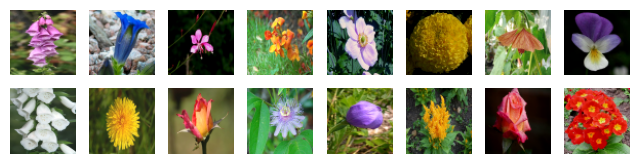

(16, 64, 64, 3)


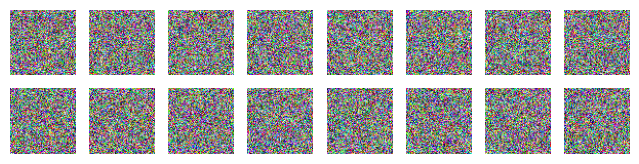

-0.32987767 45.300884


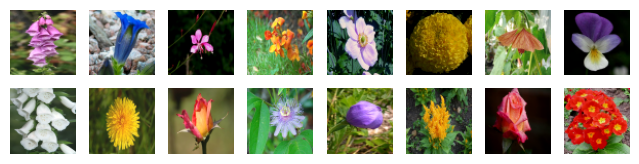

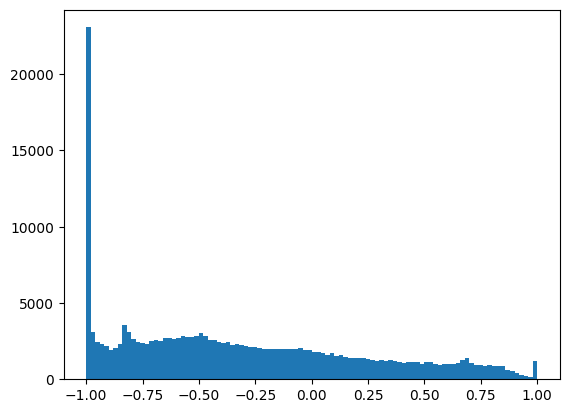

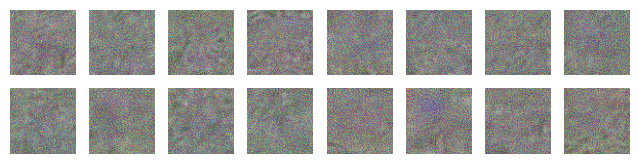

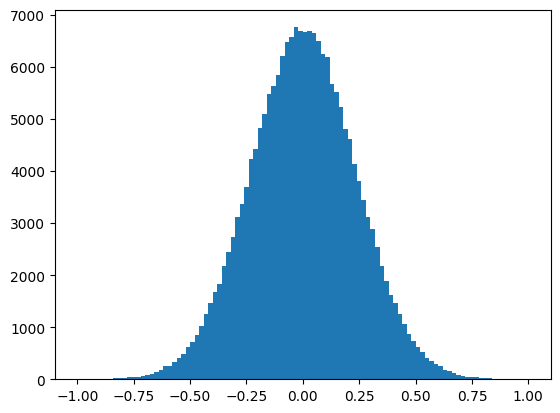

In [155]:
images = next(iter(data))
plotImages(images)
print(images.shape)
rng = jax.random.PRNGKey(4)
noise = jax.random.normal(rng, shape=images.shape, dtype=jnp.float32)
noise_level = 0.9
noise_levels = jnp.ones((images.shape[0],), dtype=jnp.int32) * noise_level
sampler = SimpleDDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
noise_schedule = karas_ve_schedule
# noise_schedule = trainer.noise_schedule
# noise_schedule = cosine_schedule
# noisy_images = noise_schedule.add_noise(images, noise, noise_levels)
rates = noise_schedule.get_rates(noise_levels)
predictor = KarraasPredictionTransform(0.5)
noisy_images, c_in, expected_output = predictor.forward_diffusion(images, noise, rates=rates)
plotImages(noisy_images)
print(jnp.mean(noisy_images), jnp.std(noisy_images))
regenerated_images = noise_schedule.remove_all_noise(noisy_images, noise, noise_levels)
plotImages(regenerated_images)
pred = unet.apply(trainer.state.params,*trainer.noise_schedule.transform_inputs(noisy_images * c_in, noise_levels))
plt.hist(expected_output.flatten(), bins=100)
plt.show()
# pred = predictor.pred_transform(noisy_images, pred, noise_schedule.get_rates(noise_levels))
reconstructed_images, pred_noise = trainer.model_output_transform(noisy_images, pred, noise_levels, noise_schedule)
reconstructed_images = clip_images(reconstructed_images)
# reconstructed_images = reconstructed_images / jnp.max(reconstructed_images)
plotImages(reconstructed_images)
plt.hist(reconstructed_images.flatten(), bins=100)
plt.show()
# plt.hist(reconstructed_images.flatten(), bins=100)
# samples = sampler.generate_images(num_images=BATCH_SIZE, start_step=3, priors=noisy_images)
# # samples = sampler.generate_images(num_images=BATCH_SIZE, diffusion_steps=50, priors=noisy_images)
# plotImages(samples)
# # plt.hist(samples.flatten(), bins=100)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95
 96 97 98 99]


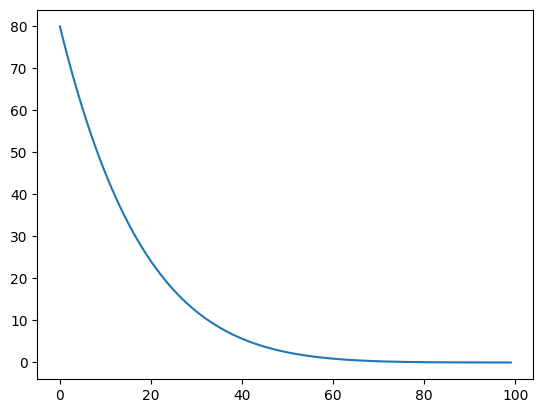

In [161]:
k = jnp.arange(100)
print(k)
sigma_max = 80
sigma_min = 0.002
rho = 7
num_steps = 100
step_indices = k
t_steps = (sigma_max ** (1 / rho) + step_indices / (num_steps - 1) * (sigma_min ** (1 / rho) - sigma_max ** (1 / rho))) ** rho
plt.plot(t_steps)

In [289]:
class EulerDiscreteSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:MarkovState, next_step=None) -> tuple[jnp.ndarray, MarkovState]:
        current_signal_rate, current_noise_rate = self.noise_schedule.get_rates(current_step)
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        current_sigma = current_noise_rate
        next_sigma = next_noise_rate

        dt = next_sigma - current_sigma
        
        x_0_coeff = (current_signal_rate * next_noise_rate - next_signal_rate * current_noise_rate) / (dt)
        dx = (current_samples - x_0_coeff * reconstructed_samples) / current_noise_rate
        next_samples = current_samples + dx * dt
        return next_samples, state

100%|██████████| 100/100 [00:09<00:00, 11.02it/s]


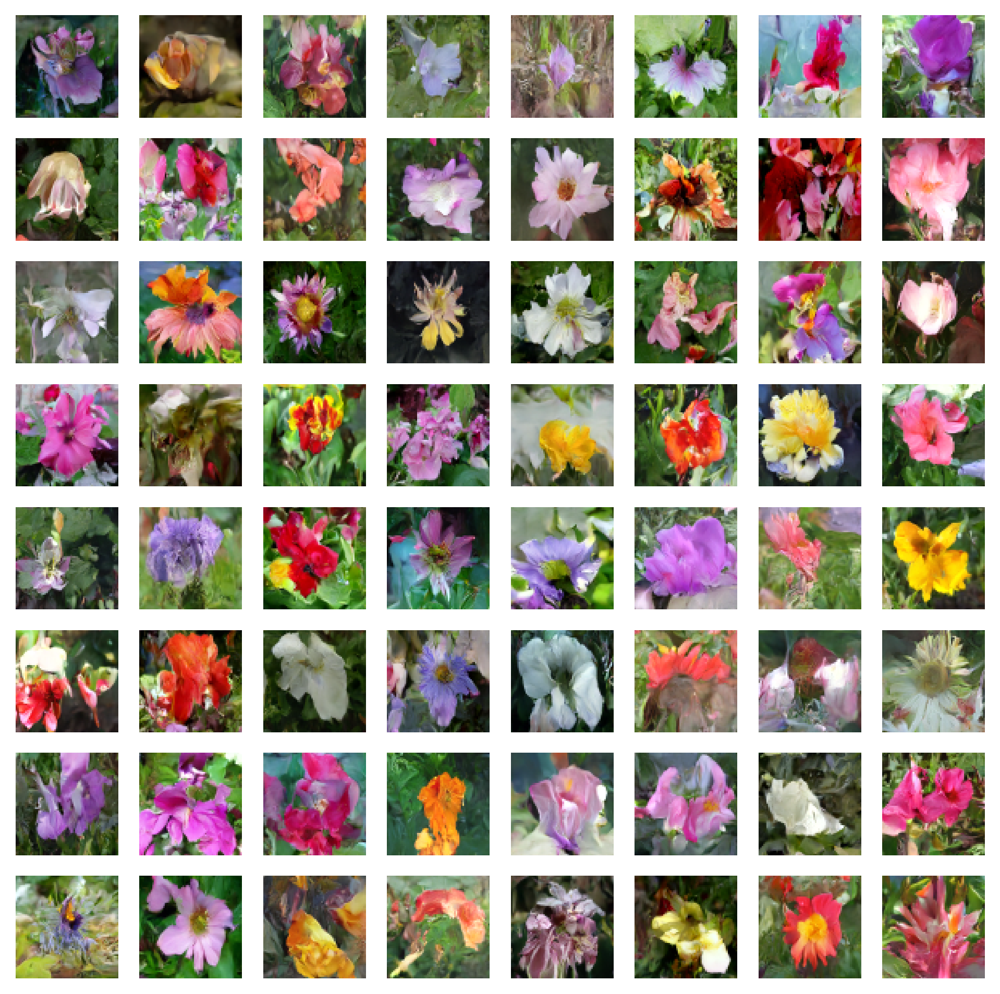

In [293]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.ema_params, karas_ve_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:09<00:00, 10.83it/s]


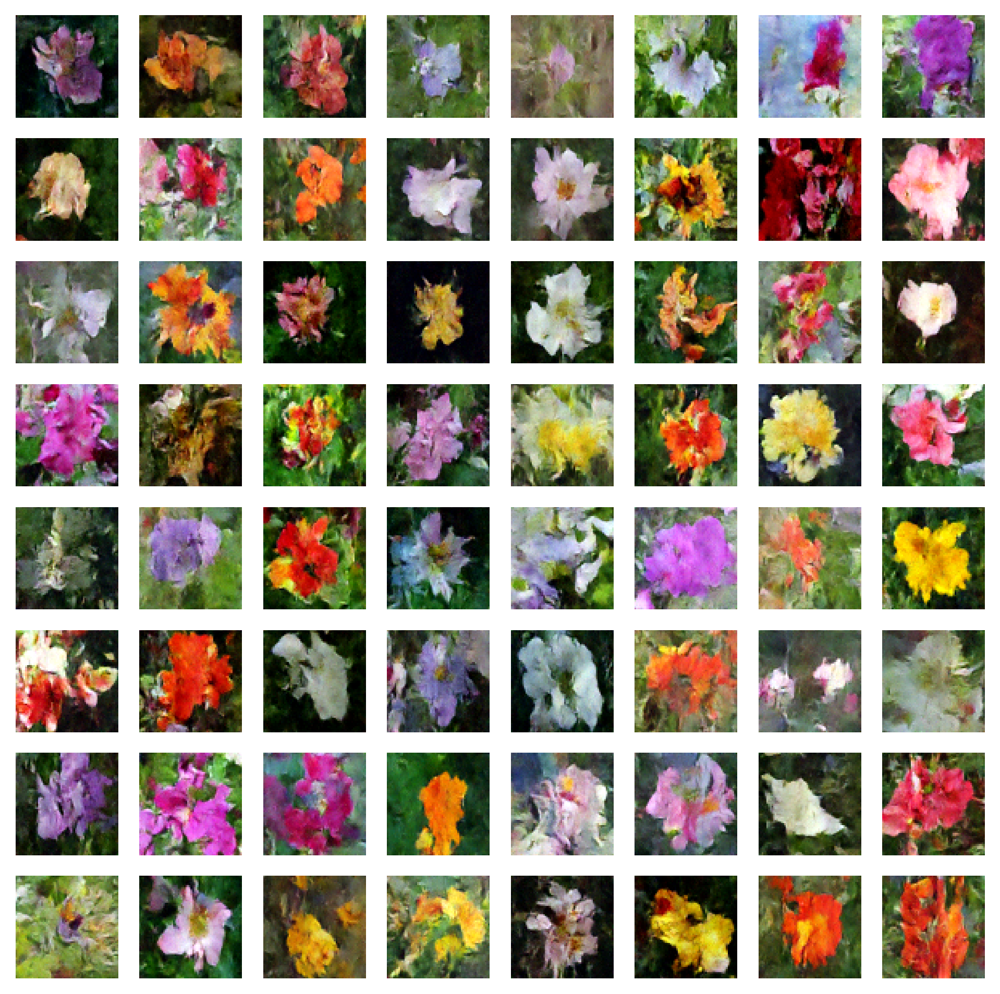

In [23]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.ema_params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:09<00:00, 10.62it/s]


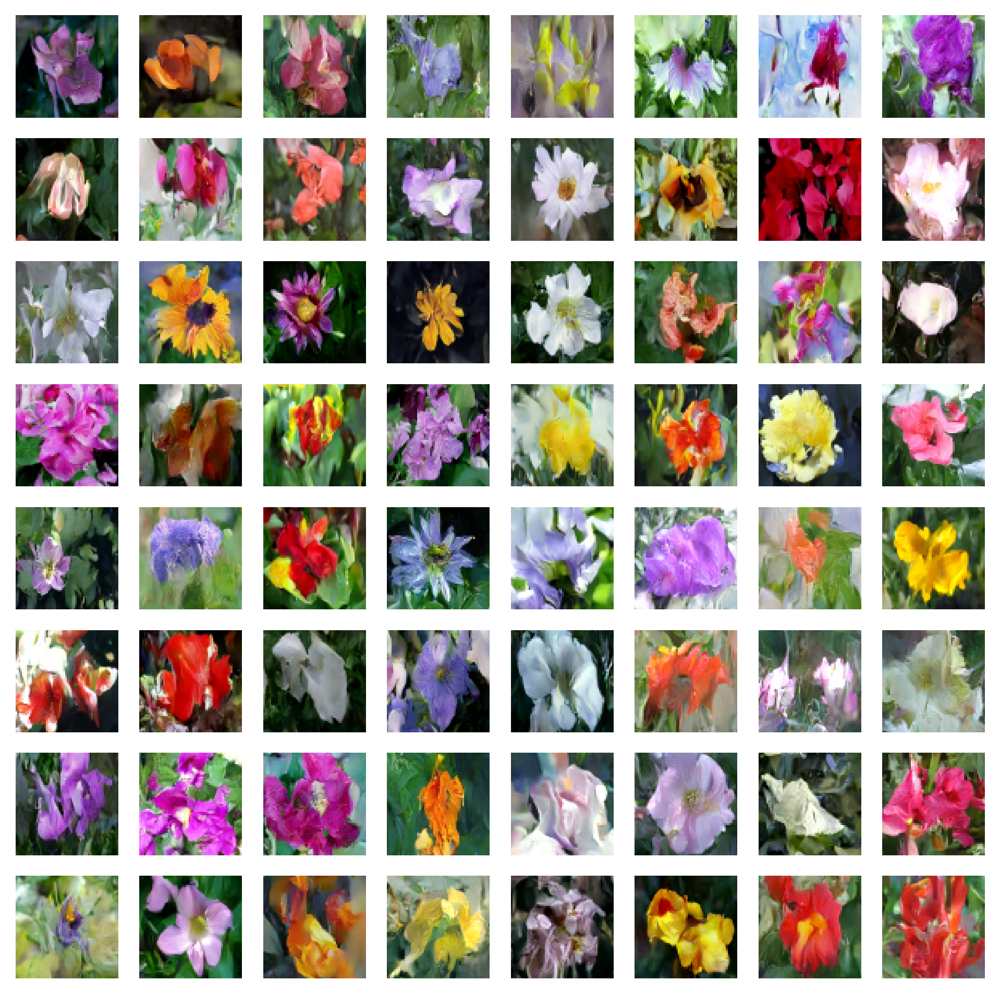

In [20]:
sampler = EulerDiscreteSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:08<00:00, 11.15it/s]


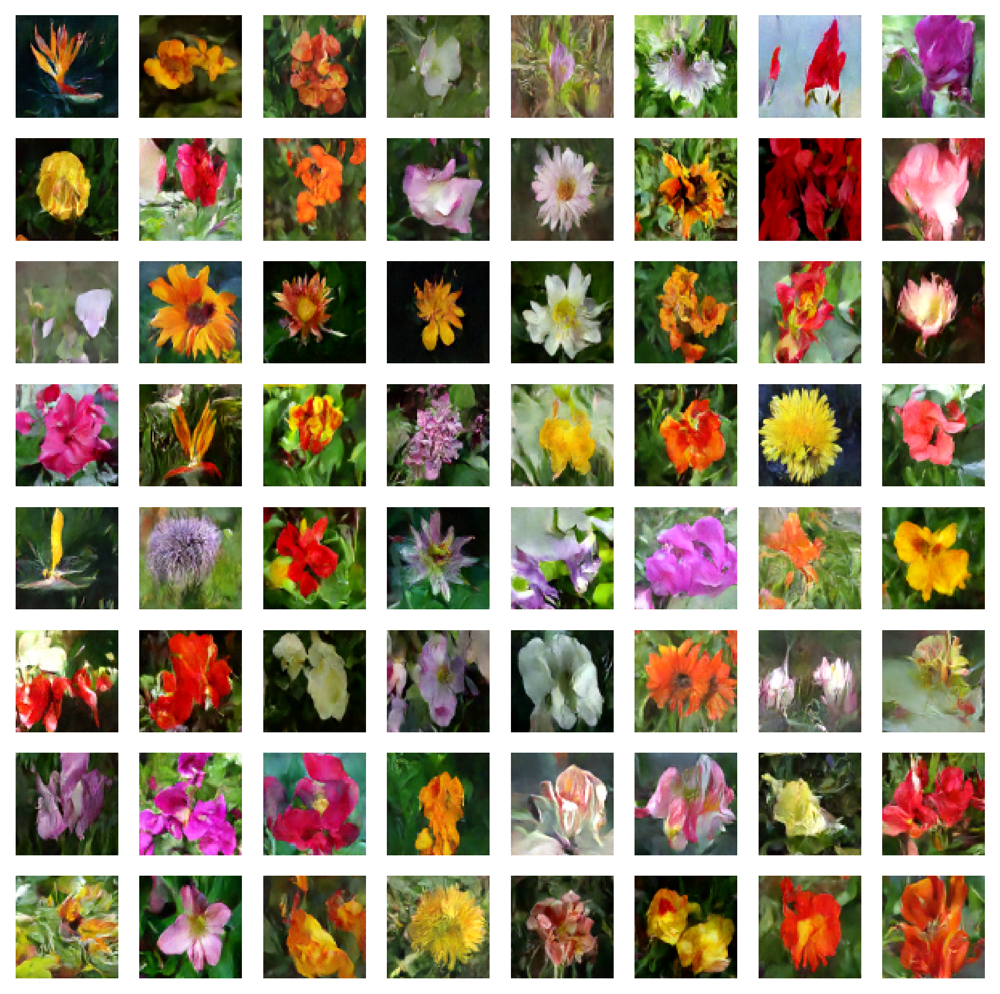

In [40]:
sampler = EulerDiscreteSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:08<00:00, 11.41it/s]


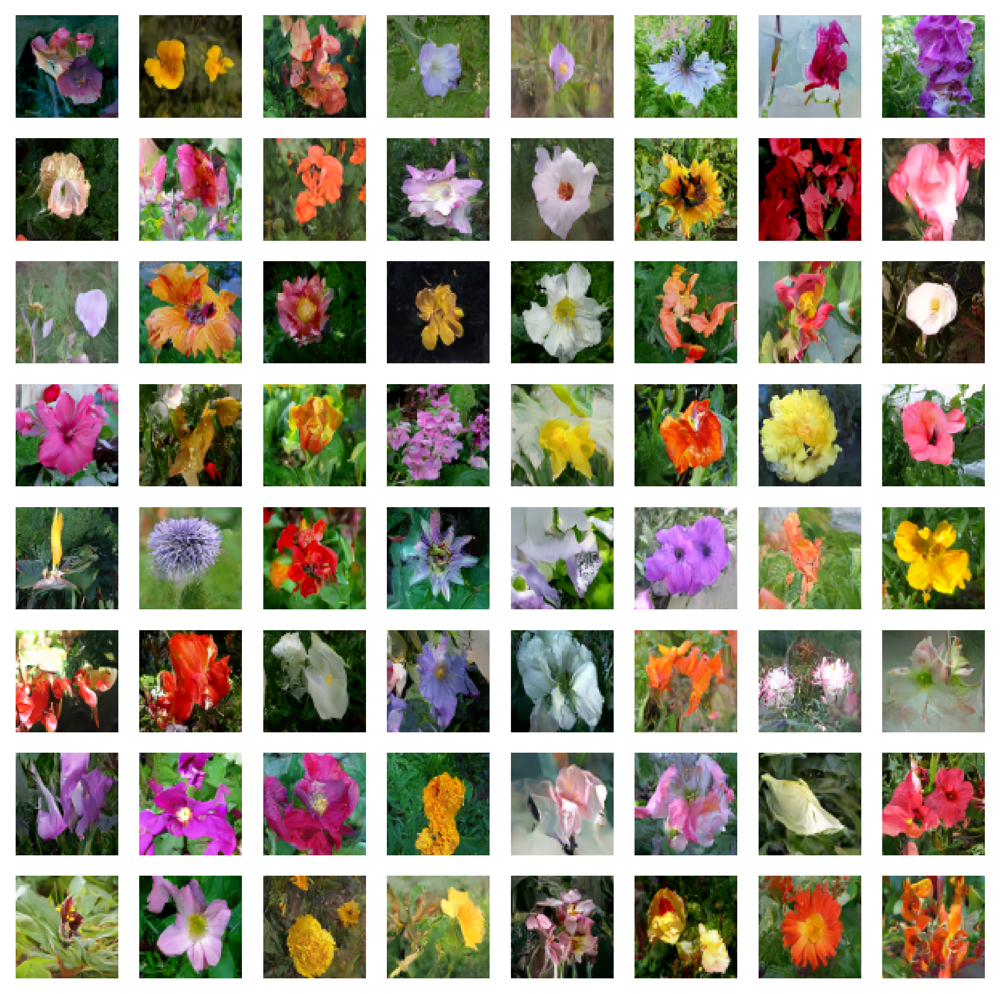

In [37]:
sampler = EulerDiscreteSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:11<00:00,  8.86it/s]


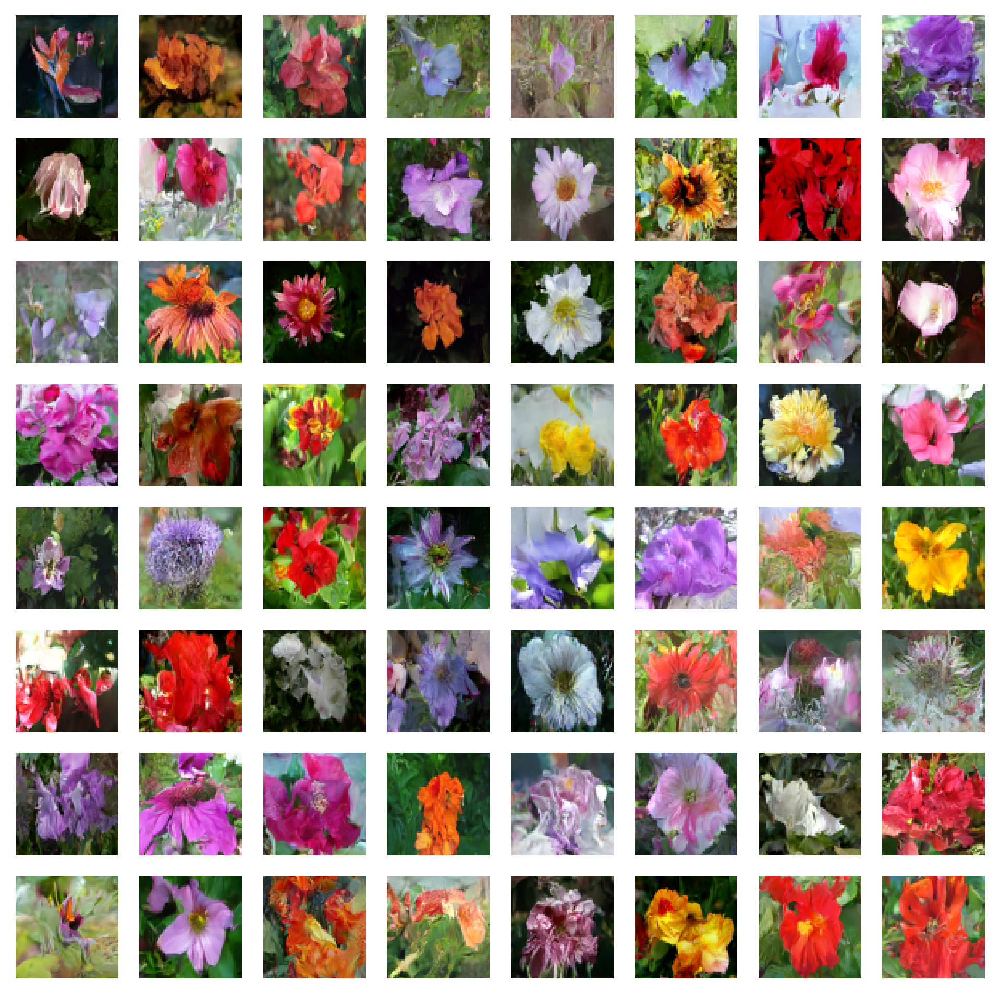

In [43]:
sampler = EulerDiscreteSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:04<00:00, 21.51it/s]


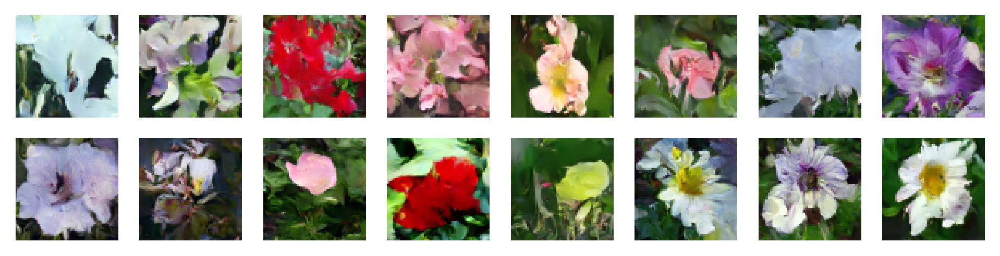

In [83]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:05<00:00, 17.91it/s]


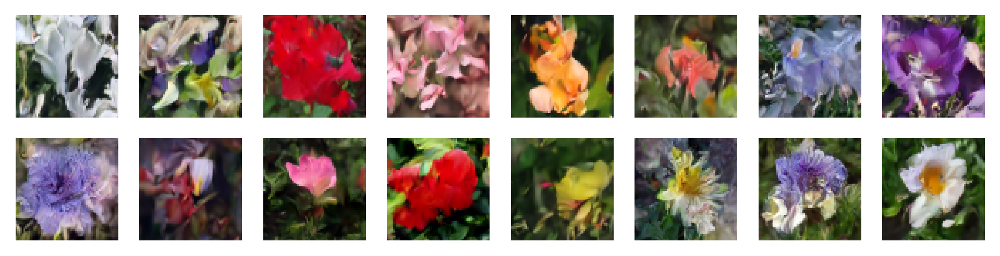

In [37]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:06<00:00, 15.33it/s]


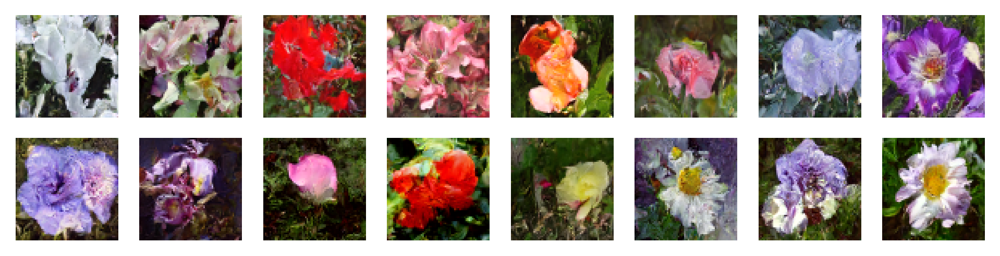

In [149]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:15<00:00, 66.20it/s]


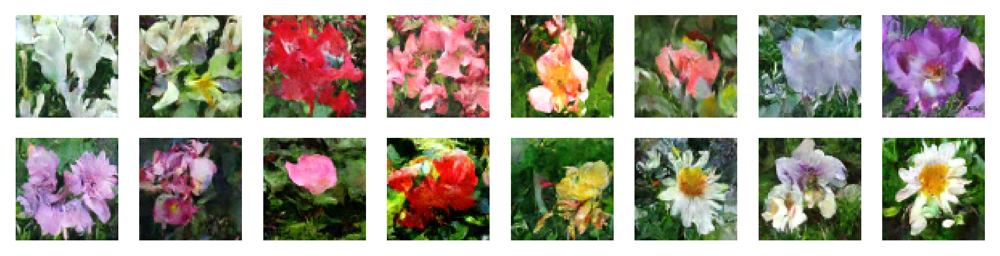

In [25]:
sampler = EulerDiscreteSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, end_step=0, priors=None)
plotImages(samples, dpi=300)

In [24]:

class SimpleDDPMSampler(DiffusionSampler):
    def _renoise(self, 
                 current_samples, reconstructed_samples, 
                 pred_noise, current_step, state:RandomMarkovState, next_step=None) -> tuple[jnp.ndarray, RandomMarkovState]:
        state, rng = state.get_random_key()
        noise = jax.random.normal(rng, reconstructed_samples.shape, dtype=jnp.float32)

        # Compute noise rates and signal rates only once
        current_signal_rate, current_noise_rate = self.noise_schedule.get_rates(current_step)
        next_signal_rate, next_noise_rate = self.noise_schedule.get_rates(next_step)
        
        noise_ratio_squared = (next_noise_rate ** 2) / (current_noise_rate ** 2)
        betas = 1 - ((current_signal_rate ** 2) / (next_signal_rate ** 2))
        gamma = jnp.sqrt(noise_ratio_squared * betas)
        
        next_samples = (1 / (jnp.sqrt(1 - betas) + 1.e-24)) * (current_samples - betas * (pred_noise / current_noise_rate)) + noise * gamma

        return next_samples, state

100%|██████████| 1000/1000 [00:57<00:00, 17.35it/s]


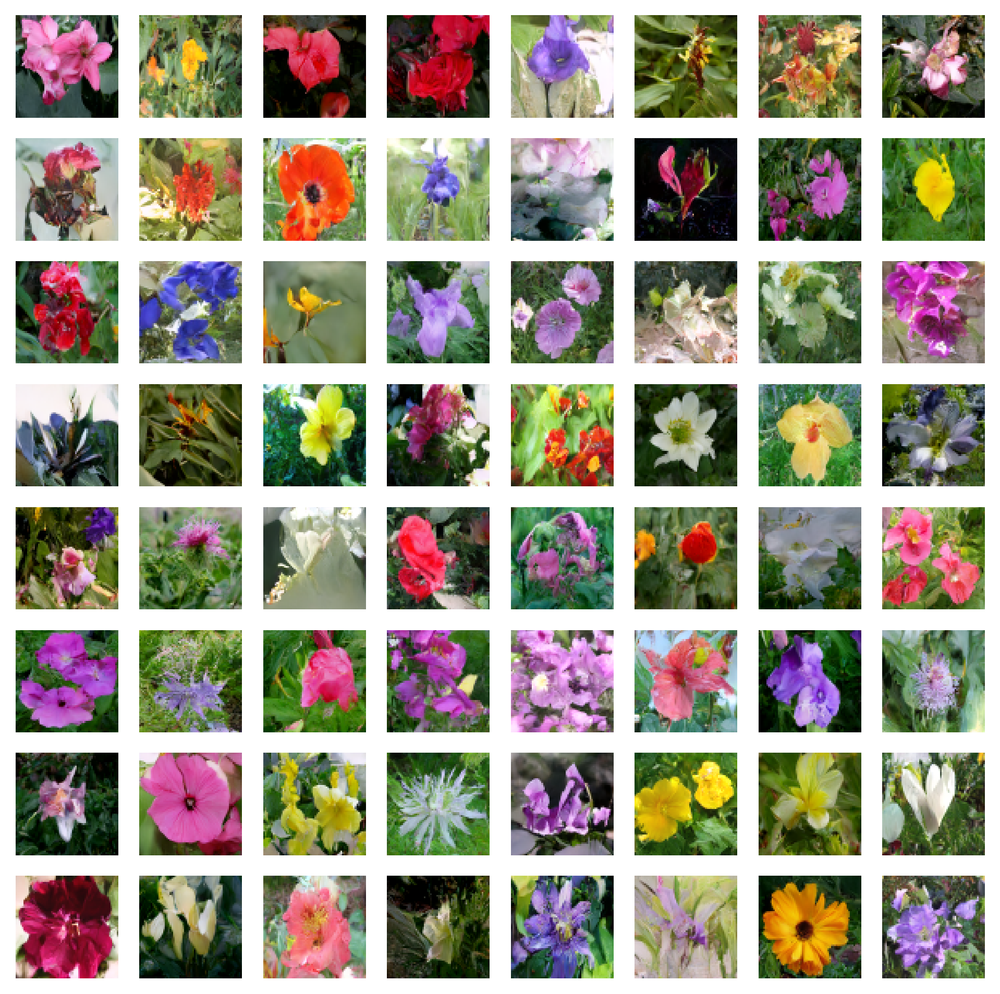

In [36]:
sampler = SimpleDDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=1000, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:04<00:00, 22.27it/s]


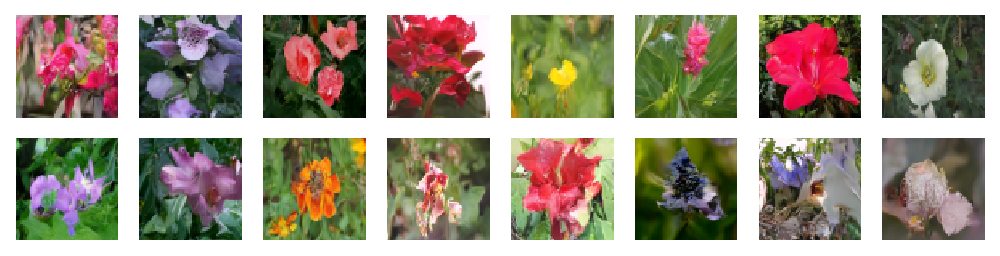

In [16]:
sampler = SimpleDDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:08<00:00, 12.11it/s]


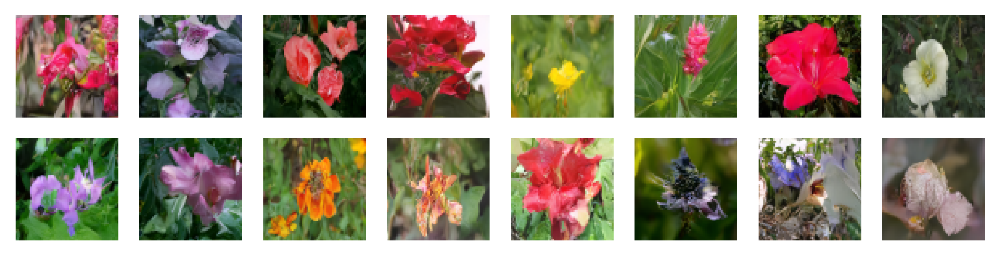

In [18]:
sampler = SimpleDDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:07<00:00, 13.36it/s]


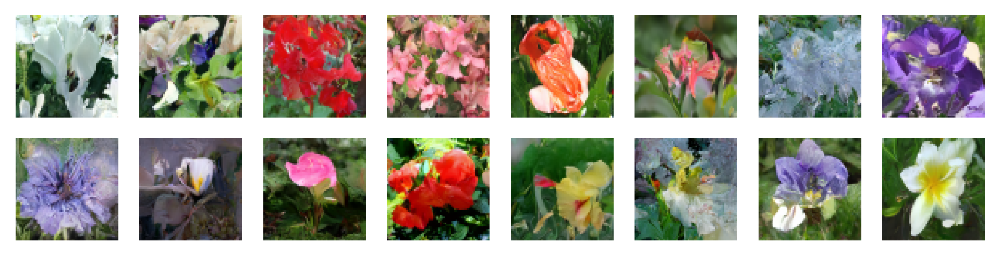

In [260]:
sampler = DDIMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 101/101 [00:07<00:00, 12.98it/s]


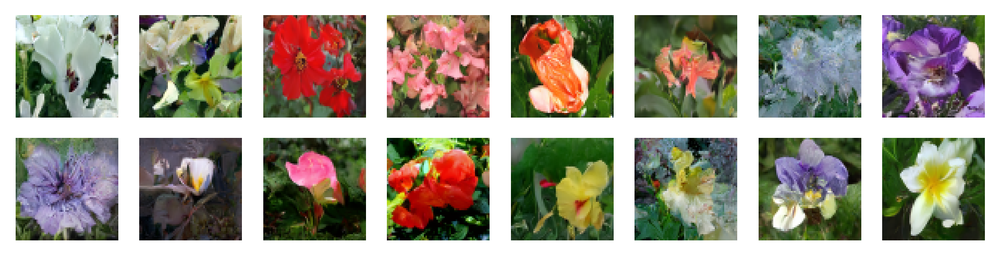

In [21]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, steps_override=[1000] + [i for i in range(0, 1000, 10)][::-1], priors=None)
plotImages(samples, dpi=300)

In [28]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

100%|██████████| 100/100 [00:05<00:00, 17.87it/s]


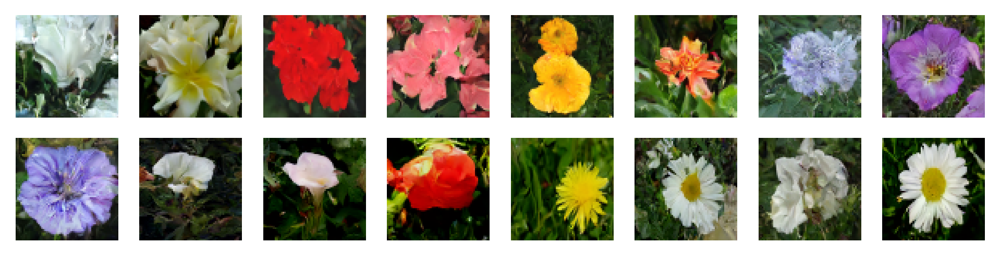

In [16]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:07<00:00, 14.16it/s]


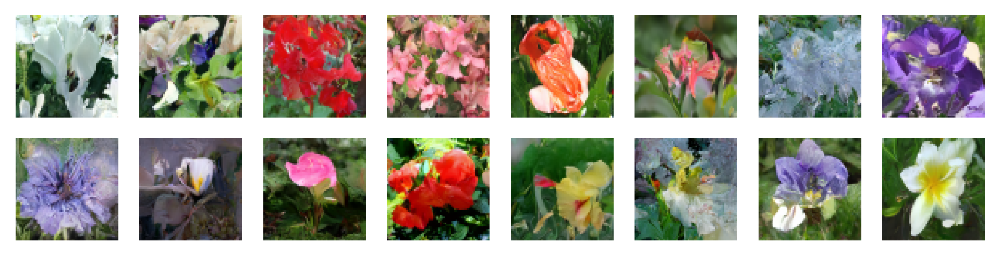

In [67]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:05<00:00, 17.90it/s]


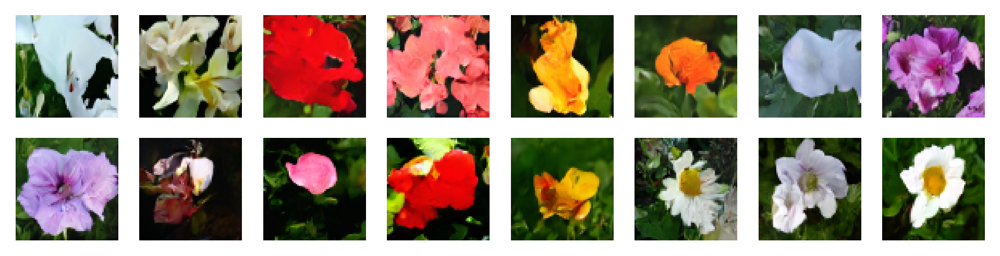

In [16]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:05<00:00, 17.08it/s]


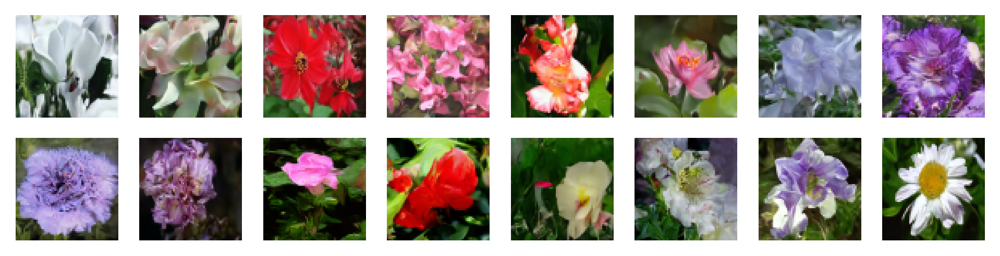

In [26]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:06<00:00, 15.08it/s]


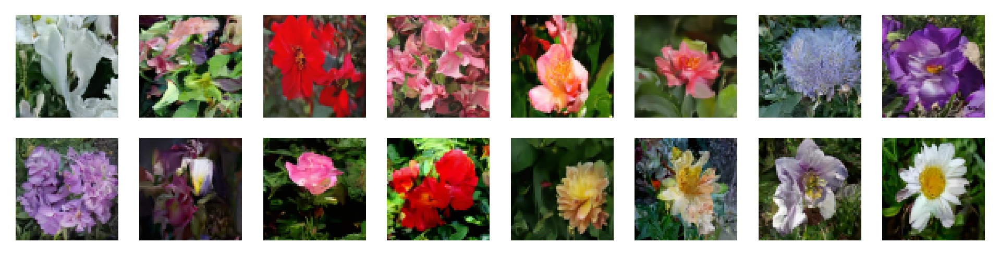

In [42]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 100/100 [00:06<00:00, 16.26it/s]


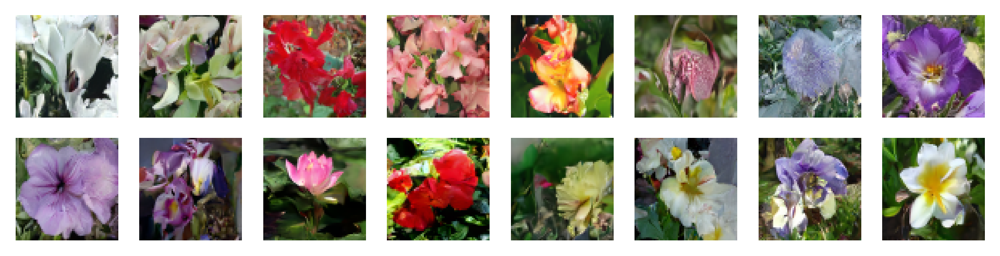

In [26]:
sampler = DDIMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=100, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:17<00:00, 56.17it/s]


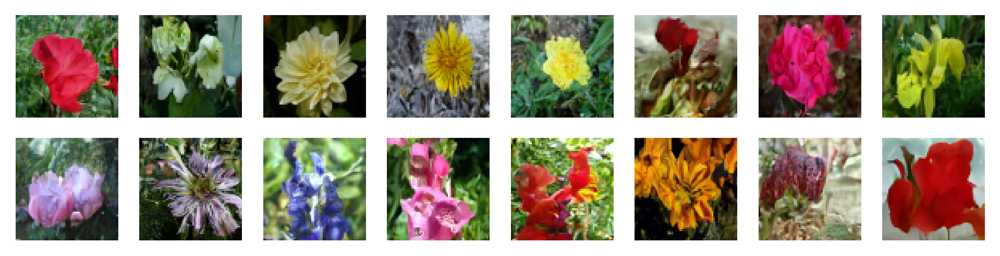

In [68]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)


100%|██████████| 1000/1000 [00:17<00:00, 56.54it/s]


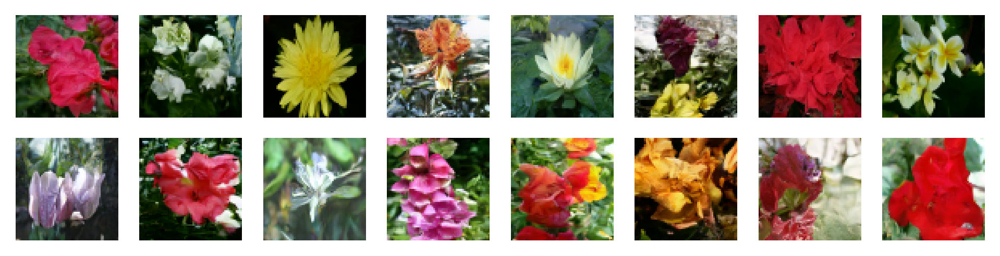

In [56]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:13<00:00, 73.97it/s]


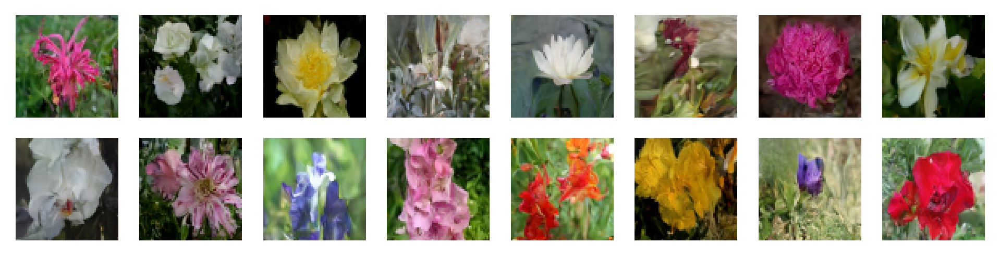

In [20]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:11<00:00, 83.37it/s]


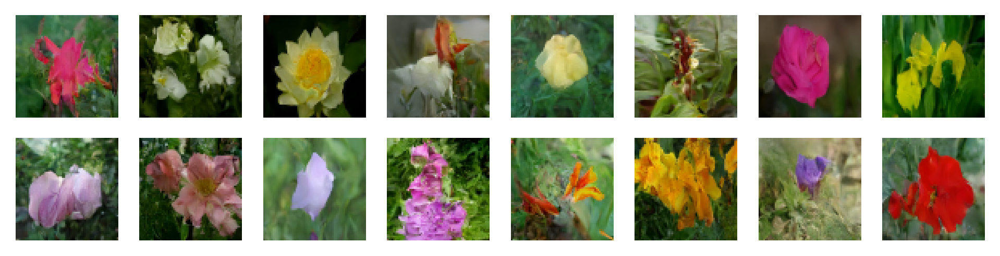

In [37]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:16<00:00, 60.51it/s]


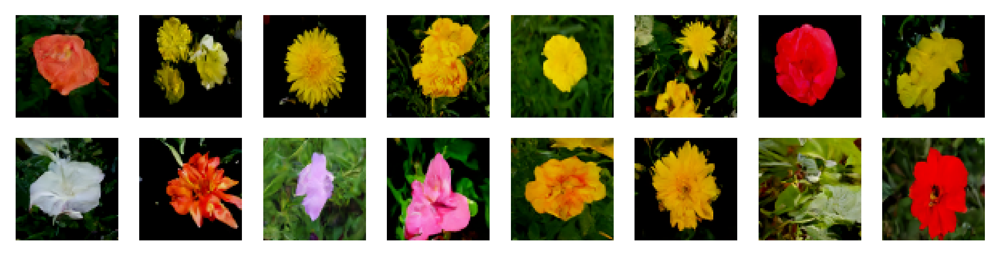

In [12]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:16<00:00, 61.99it/s]


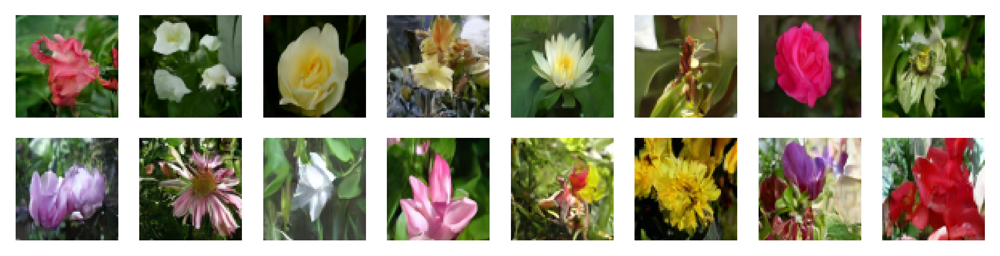

In [43]:
sampler = DDPMSampler(trainer.model, trainer.state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:09<00:00, 103.60it/s]


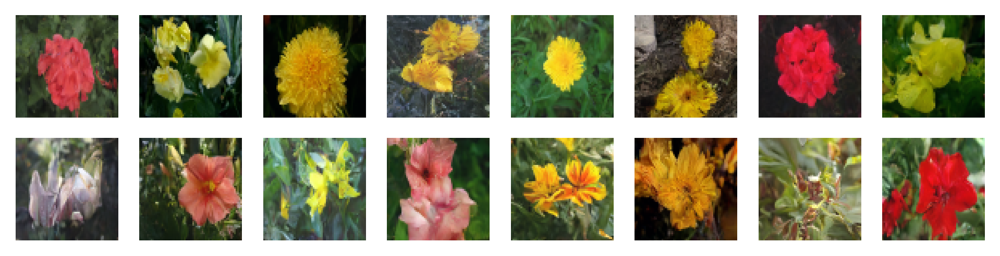

In [91]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/1000 [00:00<?, ?it/s]

[]


100%|██████████| 1000/1000 [00:15<00:00, 65.72it/s]


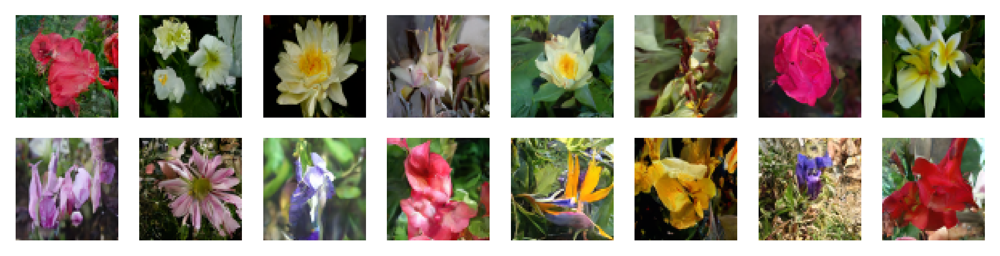

In [28]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 1000/1000 [00:14<00:00, 68.11it/s]


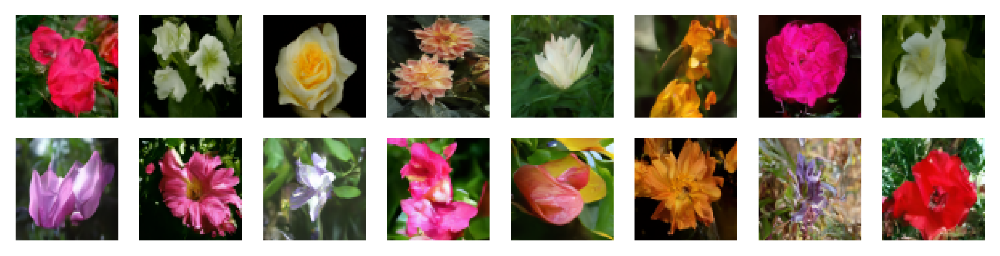

In [28]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=1000, priors=None)
plotImages(samples, dpi=300)

100%|██████████| 999/999 [00:14<00:00, 69.16it/s] 


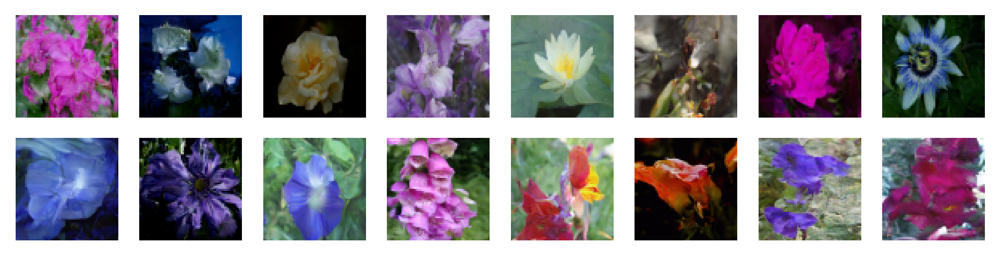

In [254]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=999, priors=None)
plotImages(samples, dpi=300)

1000it [00:23, 42.53it/s]


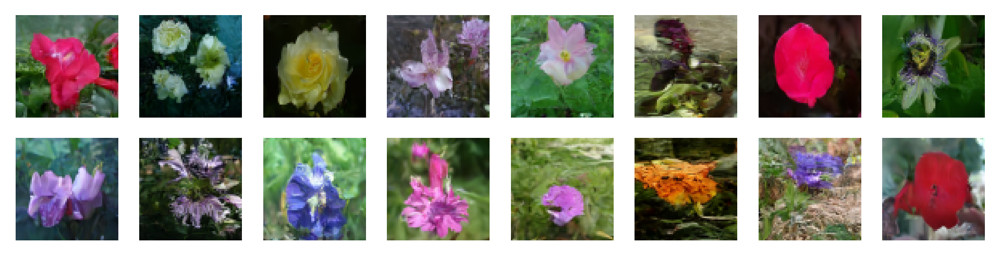

In [33]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, start_step=999, priors=None)
plotImages(samples, dpi=300)

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:05<00:00,  9.60it/s]


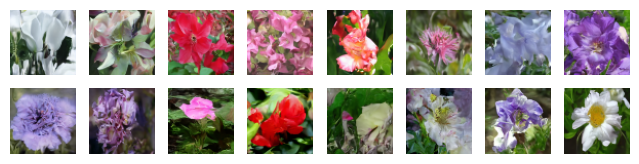

In [37]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=16, diffusion_steps=50, start_step=1000, end_step=0, priors=None)
plotImages(samples)

100%|██████████| 1000/1000 [01:11<00:00, 13.89it/s]


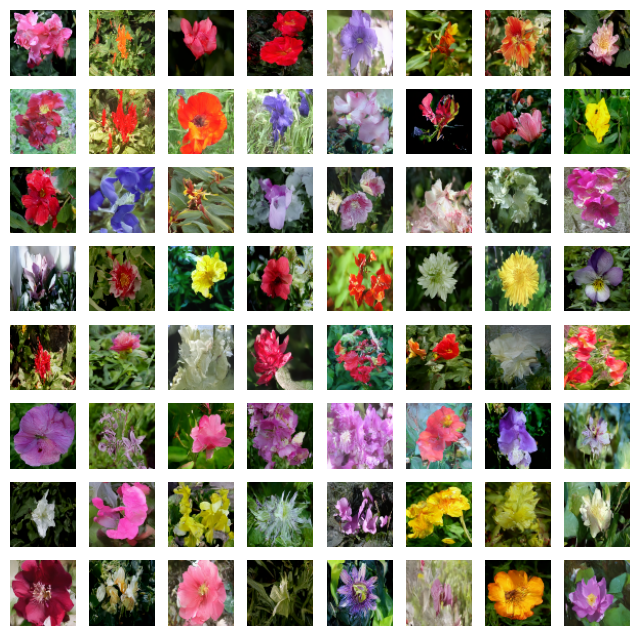

In [18]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, start_step=1000, priors=None)
plotImages(samples)

100%|██████████| 1000/1000 [00:48<00:00, 20.70it/s]


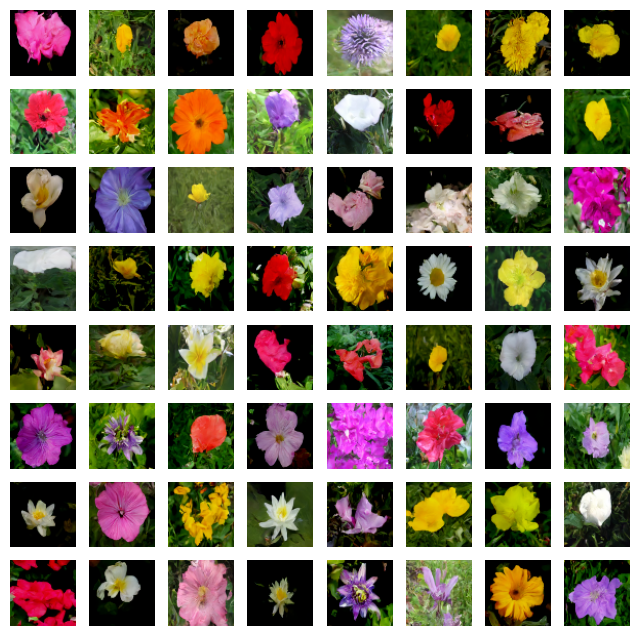

In [13]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, start_step=1000, priors=None)
plotImages(samples)

  0%|          | 0/1000 [00:00<?, ?it/s]

[]


100%|██████████| 1000/1000 [00:56<00:00, 17.73it/s]


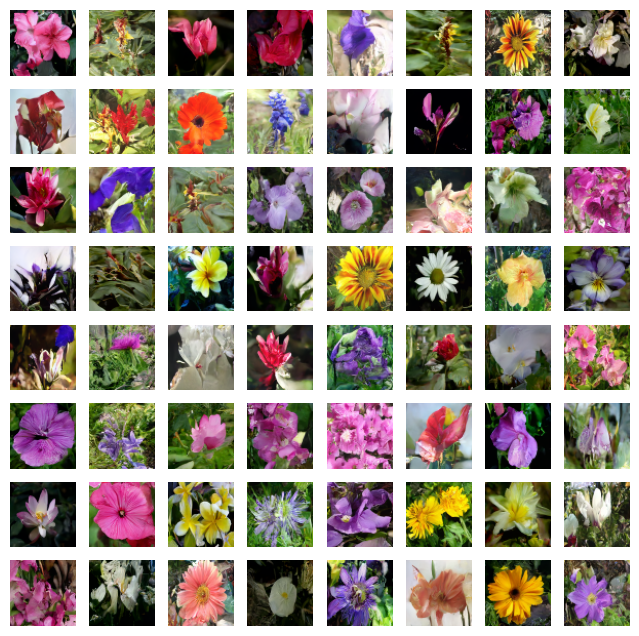

In [29]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, start_step=1000, priors=None)
plotImages(samples)

  0%|          | 0/1000 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [00:47<00:00, 21.05it/s]


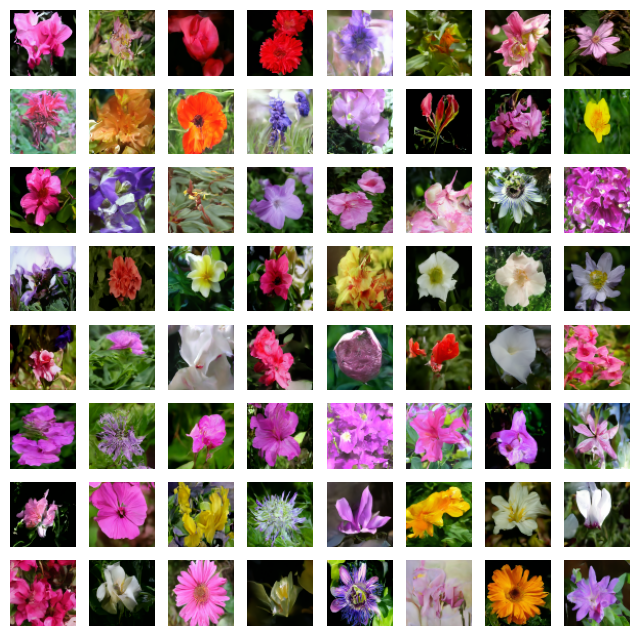

In [38]:
sampler = DDPMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, start_step=1000, priors=None)
plotImages(samples)

100%|██████████| 84/84 [00:08<00:00, 10.06it/s]


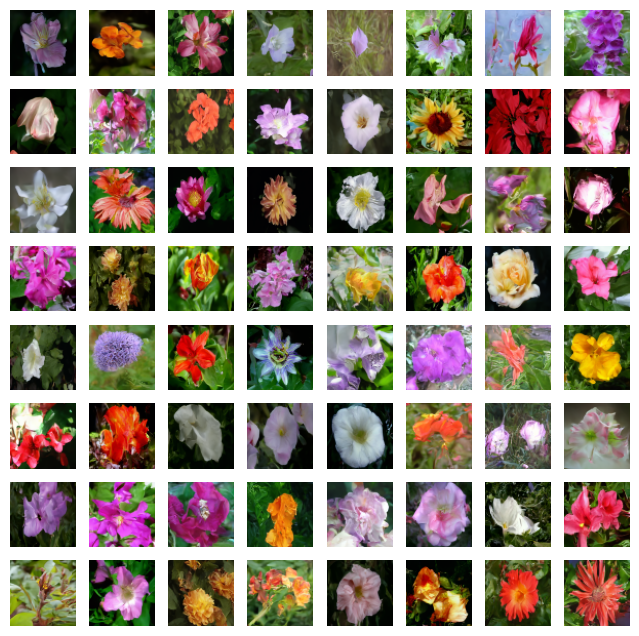

In [40]:
sampler = DDIMSampler(trainer.model, trainer.best_state.params, trainer.noise_schedule, model_output_transform=trainer.model_output_transform)
samples = sampler.generate_images(num_images=64, diffusion_steps=80, priors=None)
plotImages(samples)

1000it [01:41,  9.85it/s]


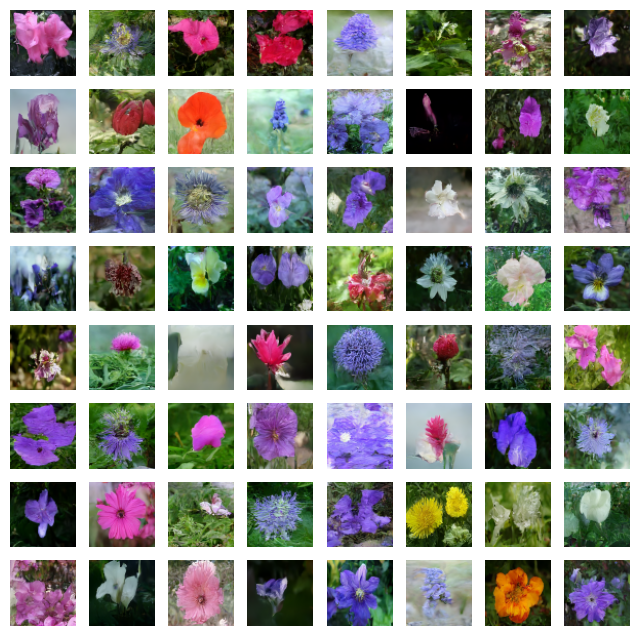

In [27]:
sampler = DDPMSampler()
samples = sampler.generate_images(trainer.model, trainer.best_state.params, trainer.noise_schedule, num_images=64, diffusion_steps=1000, priors=None)
plotImages(samples)

100it [00:11,  8.64it/s]


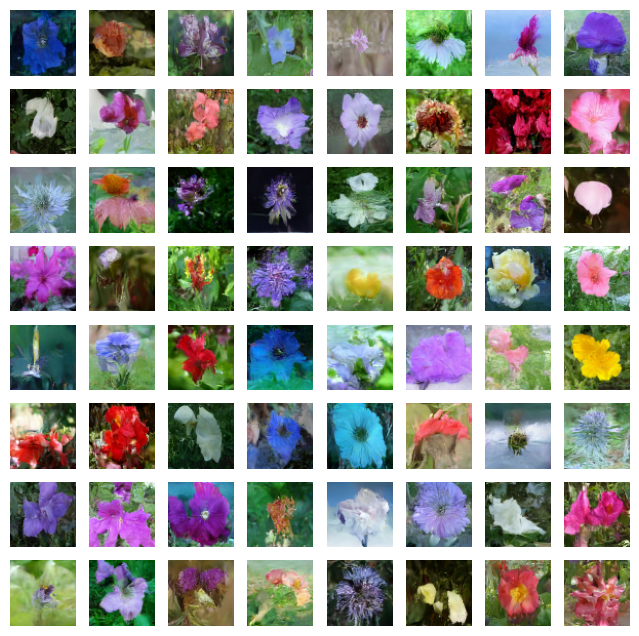

In [32]:
sampler = DDIMSampler()
samples = sampler.generate_images(trainer.model, trainer.best_state.params, trainer.noise_schedule, num_images=64, diffusion_steps=100, priors=None)
plotImages(samples)

1000it [01:17, 12.87it/s]


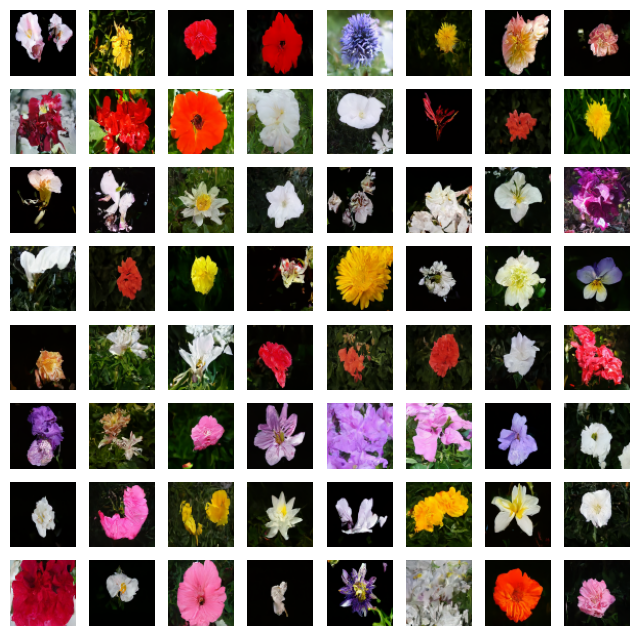

In [36]:
sampler = DDPMSampler()
samples = sampler.generate_images(trainer.model, trainer.best_state.params, trainer.noise_schedule, num_images=64, diffusion_steps=1000, priors=None)
plotImages(samples)

100it [00:09, 10.89it/s]


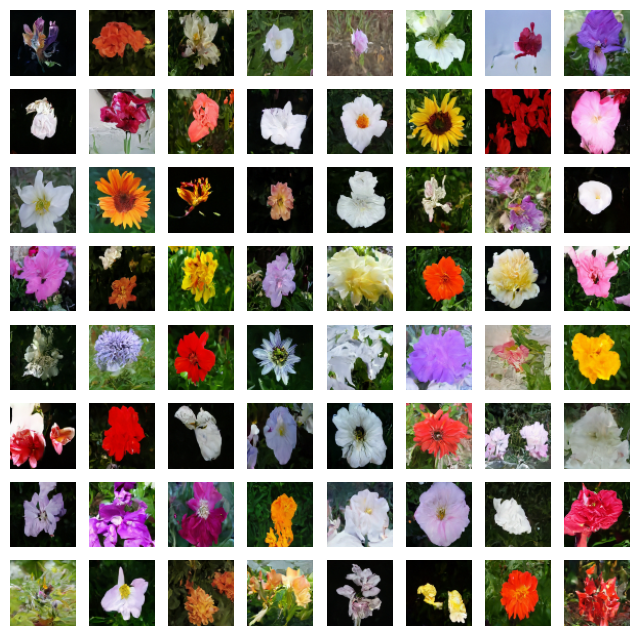

In [35]:
sampler = DDIMSampler()
samples = sampler.generate_images(trainer.model, trainer.best_state.params, trainer.noise_schedule, num_images=64, diffusion_steps=100, priors=None)
plotImages(samples)

1000it [01:18, 12.72it/s]


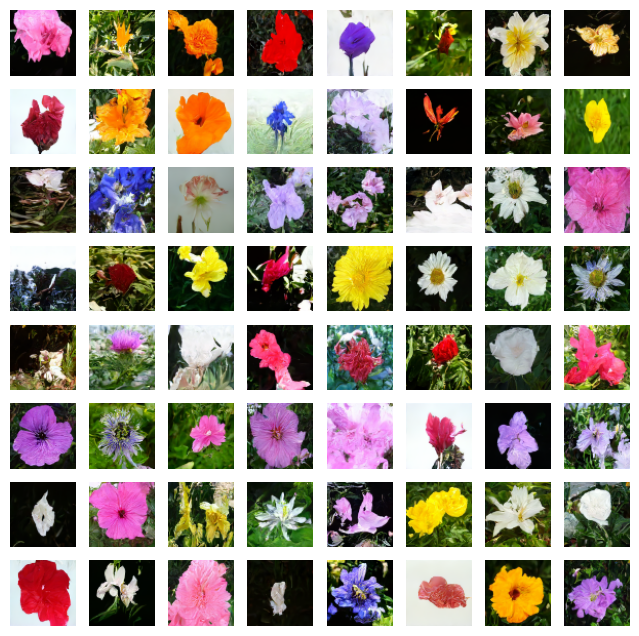

In [34]:
sampler = DDPMSampler()
samples = sampler.generate_images(trainer.model, trainer.state.params, noise_schedule, num_images=64, diffusion_steps=1000, priors=None)
plotImages(samples)

100it [00:14,  7.10it/s]


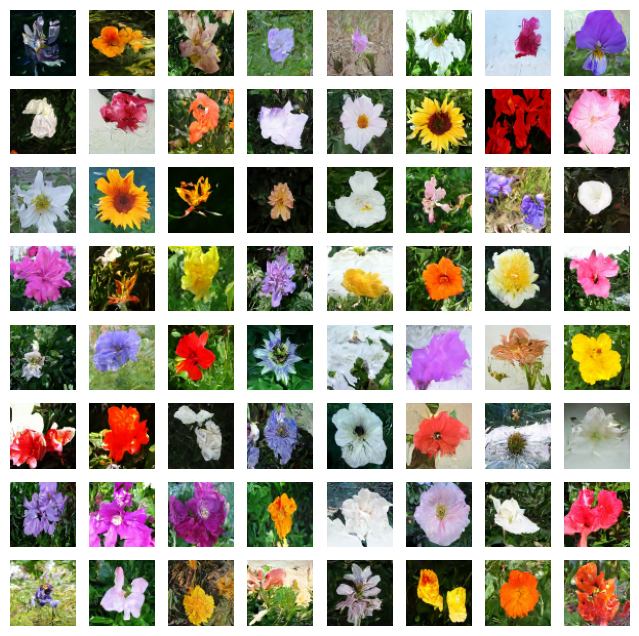

In [33]:
sampler = DDIMSampler()
samples = sampler.generate_images(trainer.model, trainer.state.params, noise_schedule, num_images=64, diffusion_steps=100, priors=None)
plotImages(samples)

1000it [00:12, 82.85it/s]


Samples (64, 64, 64, 3) -0.99983406 0.99983406 -0.3262726


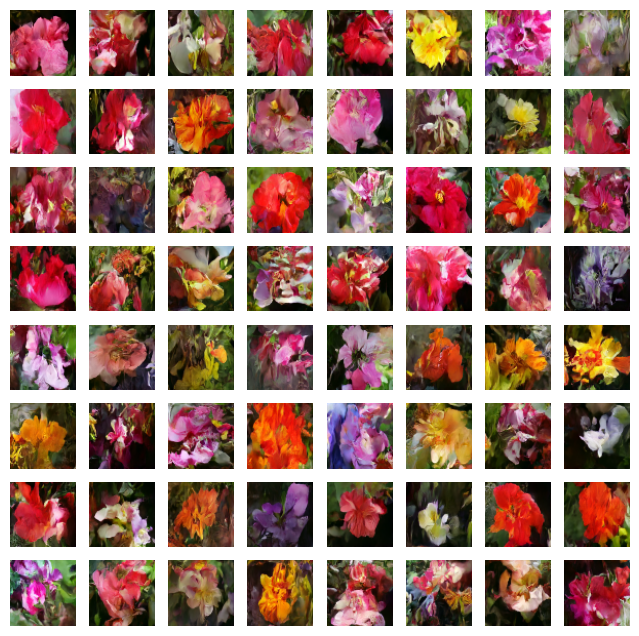

In [26]:
samples = generate_images(trainer.state, trainer.schedule, num_images=64, diffusion_steps=1000)
plotImages(samples)

In [ ]:
rng = jax.random.PRNGKey(4)
noise = jax.random.normal(rng, shape=images.shape, dtype=jnp.float32)
noise_level = 500
noise_levels = jnp.ones((images.shape[0],), dtype=jnp.int32) * noise_level
rates = noise_schedule.get_rates(noise_levels)
alpha, sigma = rates
plt.hist(images.flatten(), bins=100)
plt.show()
predictor = VPredictionTransform()
x_t, v = predictor.train_step(images, noise, noise_levels, noise_schedule)
print(jnp.mean(alpha), jnp.mean(sigma))
var = alpha ** 2 + sigma ** 2
print("Variance is", jnp.mean(var))
print("V =>", jnp.mean(v), jnp.std(v))
print("x_t =>", jnp.mean(x_t), jnp.std(x_t))
plt.hist(v.flatten(), bins=100)
plt.show()
x_0, eps = predictor(x_t, v, noise_levels, noise_schedule)
print("x_0 =>", jnp.mean(x_0), jnp.std(x_0))
print("eps =>", jnp.mean(eps), jnp.std(eps))
plt.hist(eps.flatten(), bins=100)
plt.show()
plt.hist(x_0.flatten(), bins=100)
plt.show()